<a href="https://colab.research.google.com/github/AmitKravchik/Map-My-Shifter-automations/blob/main/Gradient_based_technique.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import TensorDataset, DataLoader

# **Functions**

## Generate toy data

In [2]:
def generate_toy_data_3_classes(num_samples_per_class, num_classes=3):
    data = []
    labels = []

    # Define mean vectors for each class with some overlap
    class_means = [
        [2.0, 2.0],
        [5.0, 5.0],
        [8.0, 2.0]
    ]

    cov = np.eye(2)  # Covariance matrix (identity for simplicity)

    for class_idx in range(num_classes):
        mean = class_means[class_idx]
        samples = np.random.multivariate_normal(mean, cov, num_samples_per_class)
        data.append(samples)
        labels.append(np.ones(num_samples_per_class) * class_idx)
    print(type(samples))
    print(type(data))
    data = np.vstack(data)
    labels = np.concatenate(labels)
    return data, labels


In [3]:
def generate_toy_data_4_classes(num_samples_per_class, num_classes=4):
    data = []
    labels = []

    # Define mean vectors for each class with some overlap
    class_means = [
        [2.0, 2.0],
        [5.0, 5.0],
        [8.0, 2.0],
        [2.0, 8.0]  # Added a fourth mean vector for the new class
    ]

    cov = np.eye(2)  # Covariance matrix (identity for simplicity)

    for class_idx in range(num_classes):
        mean = class_means[class_idx]
        samples = np.random.multivariate_normal(mean, cov, num_samples_per_class)
        data.append(samples)
        labels.append(np.ones(num_samples_per_class) * class_idx)

    data = np.vstack(data)
    labels = np.concatenate(labels)
    return data, labels

In [4]:
def generate_toy_data_4_classes_intersect(num_samples_per_class, num_classes=4):
    data = []
    labels = []

    intersection_point = [5.0, 5.0]  # This is the shared intersection point

    # Vectors pointing from the intersection point to the mean of each class
    vectors = [
        [-3.0, 0.0],  # Left
        [0.0, 3.0],   # Up
        [3.0, 0.0],   # Right
        [0.0, -3.0]   # Down
    ]

    # Calculate class means based on intersection point and vectors
    class_means = [np.add(intersection_point, vec) for vec in vectors]

    cov = np.eye(2)  # Covariance matrix (identity for simplicity)

    for class_idx in range(num_classes):
        mean = class_means[class_idx]
        samples = np.random.multivariate_normal(mean, cov, num_samples_per_class)
        data.append(samples)
        labels.append(np.ones(num_samples_per_class) * class_idx)

    data = np.vstack(data)
    labels = np.concatenate(labels)
    return data, labels

## Neural Network Defenition

In [5]:
class SimpleNN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(SimpleNN, self).__init__()
        self.fc1 = nn.Linear(input_dim, hidden_dim)
        self.relu = nn.ReLU()
        self.fc2 = nn.Linear(hidden_dim, output_dim)

    def forward(self, x):
        x = self.fc1(x)
        x = self.relu(x)
        x = self.fc2(x)
        return x

## Loss Functions

In [6]:
def generate_adversarial_example_entropy(model, data, l2_target ,num_iterations=100, lr=0.01):
    perturbed_data = data.clone().detach().requires_grad_(True)

    optimizer = optim.Adam([perturbed_data], lr=lr)

    x_history = []
    prob_vector_history = []

    for iteration in range(num_iterations):
        optimizer.zero_grad()

        outputs = model(perturbed_data.unsqueeze(0))
        probs = outputs.softmax(dim=-1)

        entropy = -torch.sum(probs * torch.log(probs + 1e-6))

        (-entropy).backward()
        optimizer.step()

        x_history.append(perturbed_data.clone().detach().numpy())
        prob_vector_history.append(probs[0].detach().numpy())

    perturbed_data.requires_grad = False
    return perturbed_data, x_history, prob_vector_history


In [7]:
# Function to generate an adversarial example for one data sample and visualize it
def generate_adversarial_example_single_sample(model, data, target_l2, num_iterations=100, lr=0.01):
    original_data = data.clone().detach().requires_grad_(True)
    optimizer = optim.Adam([original_data], lr=lr)

    x_history = []
    prob_vector_history = []
    output = model(original_data.unsqueeze(0))
    pred = output.softmax(dim=-1)
    pred_c = torch.unsqueeze(torch.argmax(pred, 1), -1)


    for iteration in range(num_iterations):
        optimizer.zero_grad()
        outputs = model(original_data.unsqueeze(0))
        output_probs = outputs.softmax(dim=-1)
        probs = torch.gather(output_probs, 1, pred_c)
        # sum_probabilities = torch.sum(torch.pow(outputs, 2), dim=1)
        # error = torch.norm(probs - target_l2, p=2)
        error = torch.norm(probs - target_l2, p=1)
        l2_loss = torch.sum(error)
        # l2_loss = torch.max(error, torch.tensor(0.0))
        l2_loss.backward()
        optimizer.step()

        x_history.append(original_data.clone().detach().numpy())
        prob_vector_history.append(outputs[0].softmax(dim=0).detach().numpy())

    original_data.requires_grad = False
    return original_data, x_history, prob_vector_history


In [8]:
def generate_adversarial_example_single_sample_try(model, data, target_l2, num_iterations=100, lr=0.01):
    original_data = data.clone().detach().requires_grad_(True)
    optimizer = optim.Adam([original_data], lr=lr)

    x_history = []
    prob_vector_history = []
    output = model(original_data.unsqueeze(0))
    pred = output.softmax(dim=-1)
    pred_c = torch.unsqueeze(torch.argmin(pred, 1), -1)


    for iteration in range(num_iterations):
        optimizer.zero_grad()
        outputs = model(original_data.unsqueeze(0))
        output_probs = outputs.softmax(dim=-1)
        pred_c = torch.unsqueeze(torch.argmin(pred, 1), -1)
        probs = torch.gather(output_probs, 1, pred_c)
        # sum_probabilities = torch.sum(torch.pow(outputs, 2), dim=1)
        # error = torch.norm(probs - target_l2, p=2)
        error = torch.norm(probs - target_l2, p=1)
        l2_loss = torch.sum(error)
        # l2_loss = torch.max(error, torch.tensor(0.0))
        l2_loss.backward()
        optimizer.step()

        x_history.append(original_data.clone().detach().numpy())
        prob_vector_history.append(outputs[0].softmax(dim=0).detach().numpy())

    original_data.requires_grad = False
    return original_data, x_history, prob_vector_history


In [9]:
def generate_adversarial_example_single_sample_decreasing_s(model, data, target_l2, num_iterations=100, lr=0.01, initial_s=10, final_s=1):
    original_data = data.clone().detach().requires_grad_(True)
    optimizer = optim.Adam([original_data], lr=lr)

    x_history = []
    prob_vector_history = []
    # output = model(original_data.unsqueeze(0))
    # pred = output.softmax(dim=-1)
    # pred_c = torch.unsqueeze(torch.argmax(pred, 1), -1)

    s = initial_s
    s_decrement = (initial_s - final_s) / num_iterations

    for iteration in range(num_iterations):
        optimizer.zero_grad()
        outputs = model(original_data.unsqueeze(0))
        output_probs = outputs.softmax(dim=-1)

        loss = torch.sum(torch.pow(output_probs, s))

        loss.backward()
        optimizer.step()

        s = max(s - s_decrement, final_s)

        x_history.append(original_data.clone().detach().numpy())
        prob_vector_history.append(outputs[0].softmax(dim=0).detach().numpy())

    original_data.requires_grad = False
    return original_data, x_history, prob_vector_history


### Old loss function

In [10]:
# Function to generate an adversarial example for one data sample and visualize it
def generate_adversarial_example_single_sample_old_loss(model, data, target_l2, num_iterations=100, lr=0.01):
    original_data = data.clone().detach().requires_grad_(True)  # Clone and set requires_grad=True
    optimizer = optim.Adam([original_data], lr=lr)

    x_history = []  # To store input data at each iteration
    prob_vector_history = []  # To store probability vector at each iteration
    # output = model(original_data.unsqueeze(0))
    # pred = output.softmax(dim=-1)
    # pred_c = torch.unsqueeze(torch.argmax(pred, 1), -1)


    for iteration in range(num_iterations):
        optimizer.zero_grad()
        outputs = model(original_data.unsqueeze(0))  # Unsqueeze to add a batch dimension
        output_probs = outputs.softmax(dim=-1)
        sum_probabilities = torch.sum(torch.pow(output_probs, 2), dim=1)
        print(sum_probabilities)
        l2_loss = torch.norm(sum_probabilities - target_l2, p=2)
        l2_loss.backward()
        optimizer.step()

        x_history.append(original_data.clone().detach().numpy())  # Store a copy of the input data
        prob_vector_history.append(outputs[0].softmax(dim=0).detach().numpy())  # Store softmax probabilities

    original_data.requires_grad = False  # Disable gradient computation for input data
    return original_data, x_history, prob_vector_history


In [11]:
  # Function to generate adversarial examples
def generate_adversarial_example(model, data, target_l2, num_iterations=100, lr=0.01):
    original_data = data.clone().detach().requires_grad_(True)  # Clone and set requires_grad=True
    optimizer = optim.Adam([data], lr=lr)

    x_history = []  # To store input data at each iteration
    prob_vector_history = []  # To store probability vector at each iteration

    for iteration in range(num_iterations):
        optimizer.zero_grad()
        outputs = model(data)
        sum_probabilities = torch.sum(torch.pow(outputs, 2), dim=1)
        l2_loss = torch.norm(sum_probabilities - target_l2, p=2)  # L2 loss
        l2_loss.backward()
        optimizer.step()

        x_history.append(original_data.clone().detach().numpy())  # Store a copy of the input data
        prob_vector_history.append(outputs[0].softmax(dim=0).detach().numpy())  # Store softmax probabilities

        # Visualization of gradients (optional)
        if iteration % 10 == 0:
            gradient_magnitude = data.grad.norm().item()
            print(f'Iteration [{iteration + 1}/{num_iterations}] L2 Loss: {l2_loss.item()} Gradient Magnitude: {gradient_magnitude}')

    original_data.requires_grad = False  # Disable gradient computation for input data
    return original_data, x_history, prob_vector_history

## Plots

In [12]:
# Plot the decision boundary
def plot_decision_boundary(model, data, labels):
    x_min, x_max = data[:, 0].min() - 1, data[:, 0].max() + 1
    y_min, y_max = data[:, 1].min() - 1, data[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01), np.arange(y_min, y_max, 0.01))
    Z = model(torch.FloatTensor(np.c_[xx.ravel(), yy.ravel()]))
    Z = Z.argmax(dim=1).reshape(xx.shape)
    plt.contourf(xx, yy, Z, alpha=0.8)
    plt.scatter(data[:, 0], data[:, 1], c=labels, cmap=plt.cm.Spectral)
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()

In [13]:
# Plot the decision boundary including x_history points
def plot_decision_boundary_with_x_history(model, data, labels, x_history):
    x_min, x_max = data[:, 0].min() - 1, data[:, 0].max() + 1
    y_min, y_max = data[:, 1].min() - 1, data[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01), np.arange(y_min, y_max, 0.01))
    Z = model(torch.FloatTensor(np.c_[xx.ravel(), yy.ravel()]))
    Z = Z.argmax(dim=1).reshape(xx.shape)

    # Plot the decision boundary
    plt.contourf(xx, yy, Z, alpha=0.8)

    # Plot data points with labels
    plt.scatter(data[:, 0], data[:, 1], c=labels, cmap=plt.cm.Spectral, label='Data Points')

    # Plot x_history points in a different color
    for x in x_history:
        plt.scatter(x[0], x[1], c='red', marker='x', label='x_history', s=100)

    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()


## Total Experiment Function

In [14]:
def experiment(num_classes, generate_toy_data_function, loss_function, target_l2_value):
    # Generate toy data
    num_samples_per_class = 100
    data, labels = generate_toy_data_function(num_samples_per_class)

    data = torch.FloatTensor(data)
    labels = torch.LongTensor(labels)

    dataset = TensorDataset(data, labels)
    batch_size = 32
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

    # Define model and loss function
    input_dim = 2
    hidden_dim = 64
    output_dim = num_classes
    model = SimpleNN(input_dim, hidden_dim, output_dim)
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr=0.01)
    num_epochs = 100

    for epoch in range(num_epochs):
        for batch_data, batch_labels in dataloader:
            optimizer.zero_grad()
            outputs = model(batch_data)
            loss = criterion(outputs, batch_labels)
            loss.backward()
            optimizer.step()

        if (epoch + 1) % 10 == 0:
            print(f'Epoch [{epoch + 1}/{num_epochs}] Loss: {loss.item()}')

    print('Training complete.')

    # Create a list of data samples in the relevant range
    data_samples, _ = generate_toy_data_function(3, num_classes)
    data_samples = torch.FloatTensor(data_samples)
    target_l2 = target_l2_value

    # Create dictionaries to store results for each sample
    results = []

    # Generate adversarial examples for each data sample
    for idx, data_sample in enumerate(data_samples):
        print("###################")
        adversarial_data, x_history, prob_vector_history = loss_function(model, data_sample,target_l2, num_iterations=1000)
        # traversal_path = traverse_boundary_from_intersection(model, adversarial_data, num_iterations=300)
        # print(x_history[0])
        # print(traversal_path[0])
        # x_history.extend(traversal_path)
        # Calculate the final loss
        final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()

        # Store the results in a dictionary
        result_dict = {
            'Sample': idx,
            'Final Loss': final_loss,
            'X History': x_history,
            'Probability Vector History': prob_vector_history
        }
        results.append(result_dict)


    # Print the results
    for result in results:
        # print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

        # Plot the change in x itself during optimization for the first sample
        sample_idx_to_visualize = result['Sample']  # Change this index to visualize a different sample
        x_history = np.array(results[sample_idx_to_visualize]['X History'])
        plt.figure(figsize=(10, 5))
        plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
        plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
        plt.xlabel('Iteration')
        plt.ylabel('Value')
        plt.title(f'Change in Input Data (x) During Optimization for Sample {sample_idx_to_visualize}')
        plt.grid()
        plt.legend()
        plt.show()

        # Plot the change in the probability vector during optimization for the first sample
        prob_vector_history = np.array(results[sample_idx_to_visualize]['Probability Vector History'])
        plt.figure(figsize=(10, 5))
        for class_idx in range(prob_vector_history.shape[1]):
            plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
        plt.xlabel('Iteration')
        plt.ylabel('Probability')
        plt.title(f'Change in Probability Vector During Optimization for Sample {sample_idx_to_visualize}')
        plt.grid()
        plt.legend()
        plt.show()

        plot_decision_boundary_with_x_history(model, data, labels, results[sample_idx_to_visualize]['X History'])


## Traversal

In [15]:
def traverse_boundary_from_intersection(model, initial_data, direction=torch.FloatTensor([1, 0]),
                                        alpha=0.1, num_iterations=100, lr=0.01):
    """
    Uses entropy and a directional reward to traverse the decision boundary from an intersection point.

    Args:
    - model: the trained model.
    - initial_data: tensor, the starting point for the traversal (ideally the intersection point).
    - direction: tensor, the preferred direction of traversal.
    - alpha: float, weight for the direction reward.
    - num_iterations: int, the number of iterations for the traversal.
    - lr: float, learning rate for the optimization.

    Returns:
    - traversal_path: list of tensors, showing the path taken during the traversal.
    """

    perturbed_data = initial_data.clone().detach().requires_grad_(True)
    optimizer = optim.Adam([perturbed_data], lr=lr)

    traversal_path = []

    for iteration in range(num_iterations):
        optimizer.zero_grad()

        outputs = model(perturbed_data.unsqueeze(0))
        probs = outputs.softmax(dim=-1)

        # Maximize entropy
        entropy = -torch.sum(probs * torch.log(probs + 1e-6))

        # Reward for moving in a particular direction
        direction_reward = -torch.dot(perturbed_data - initial_data, direction)

        # Combine objectives
        loss = -entropy + alpha * direction_reward

        loss.backward()
        optimizer.step()

        traversal_path.append(perturbed_data.clone().detach().numpy())

    return traversal_path


# **Total Experiment Runs**

Epoch [10/100] Loss: 0.3685884177684784
Epoch [20/100] Loss: 0.32980799674987793
Epoch [30/100] Loss: 0.44920313358306885
Epoch [40/100] Loss: 0.33372750878334045
Epoch [50/100] Loss: 0.278642863035202
Epoch [60/100] Loss: 0.19899600744247437
Epoch [70/100] Loss: 0.15058600902557373
Epoch [80/100] Loss: 0.16499610245227814
Epoch [90/100] Loss: 0.10433977842330933
Epoch [100/100] Loss: 0.19969359040260315
Training complete.
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################


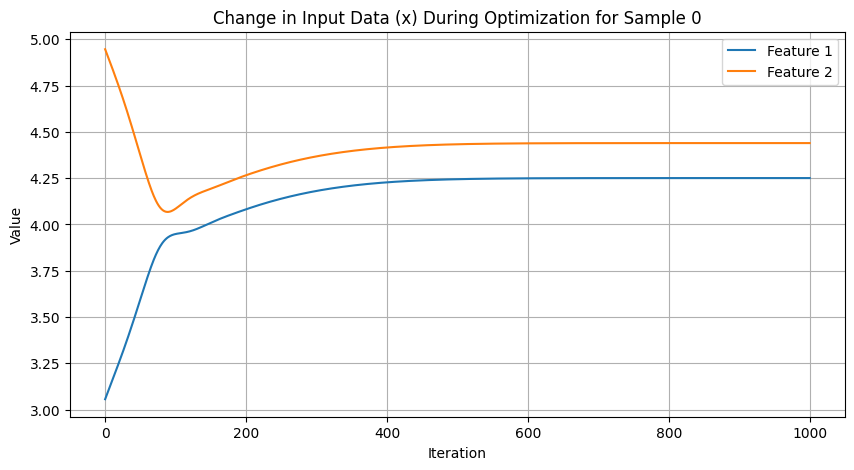

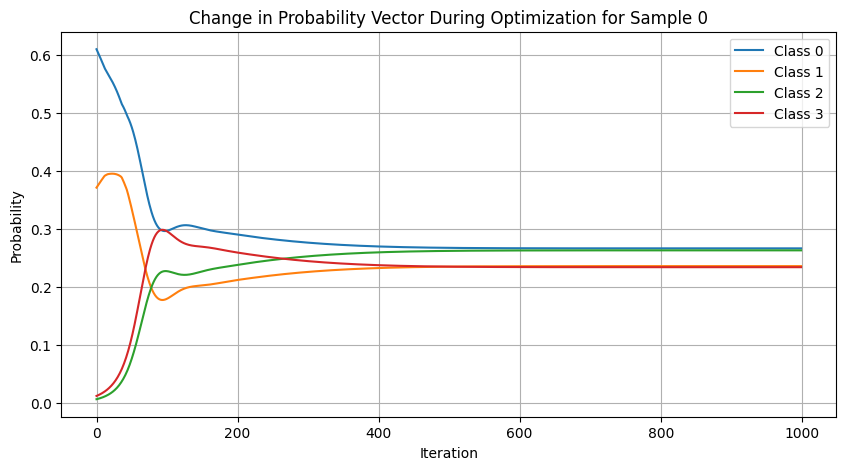

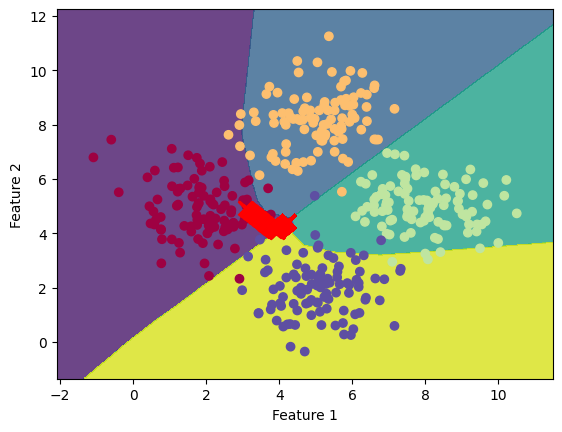

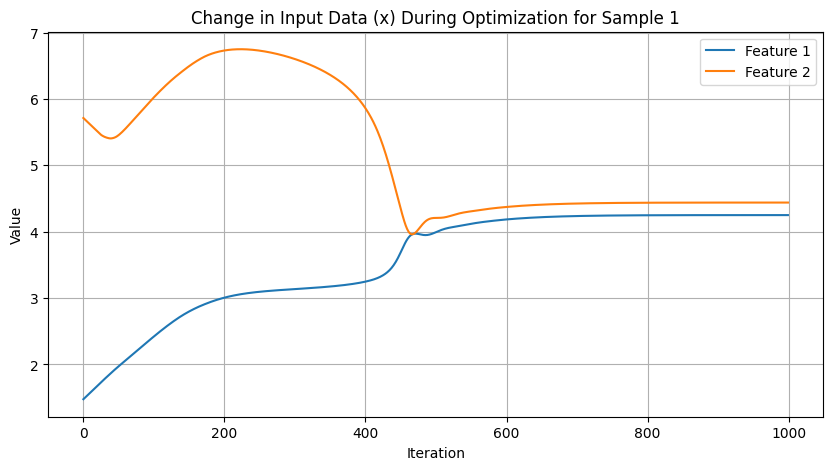

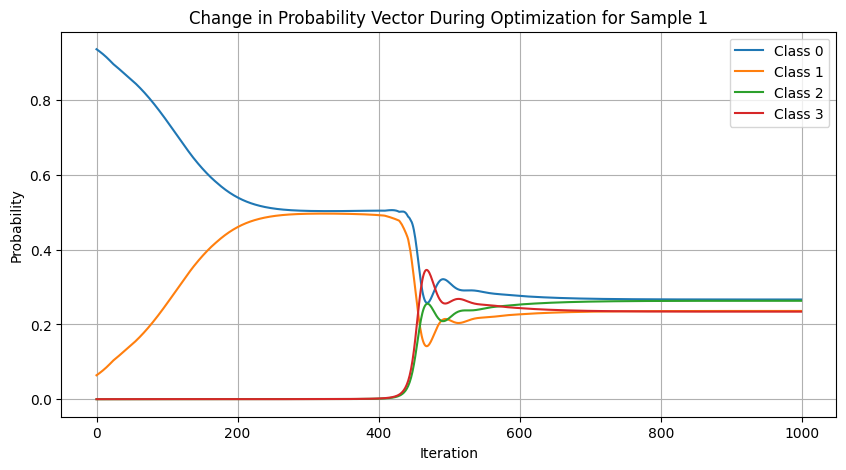

...

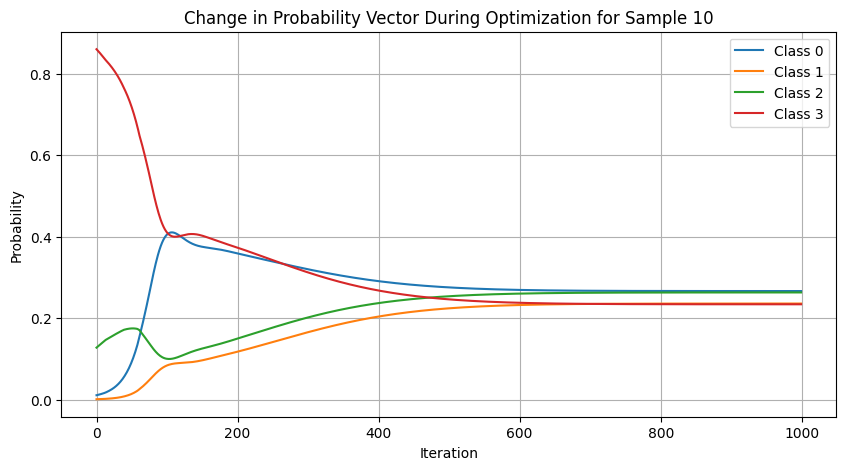

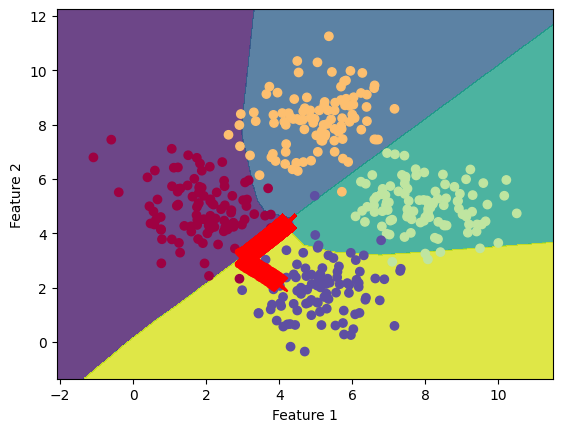

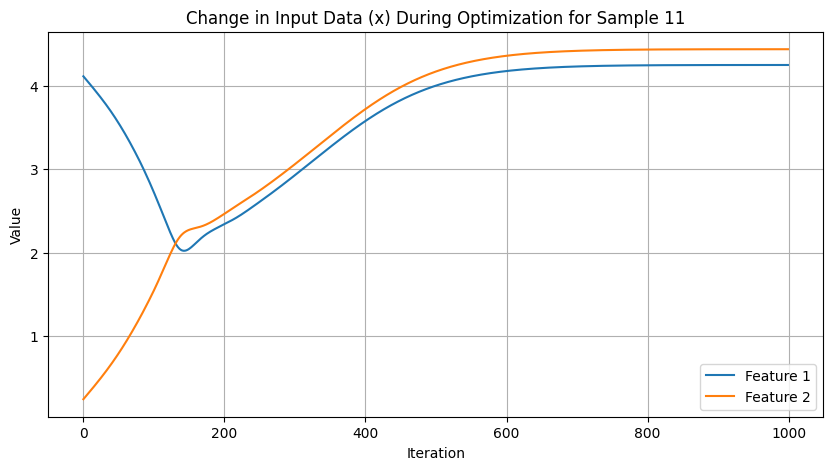

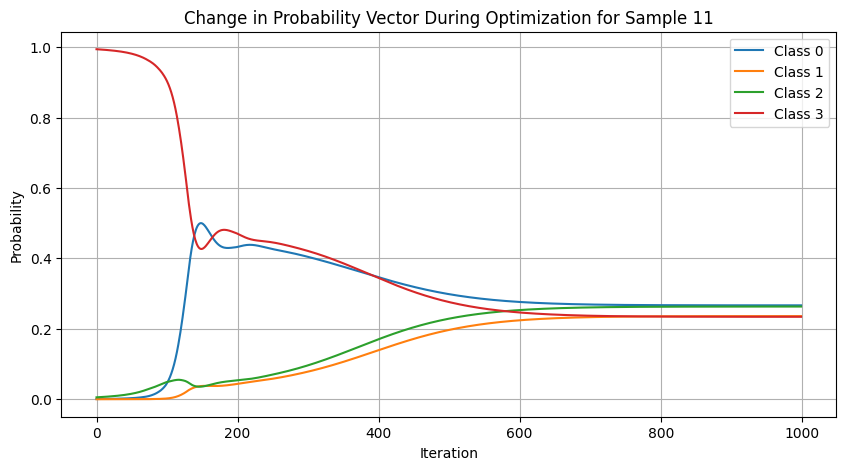

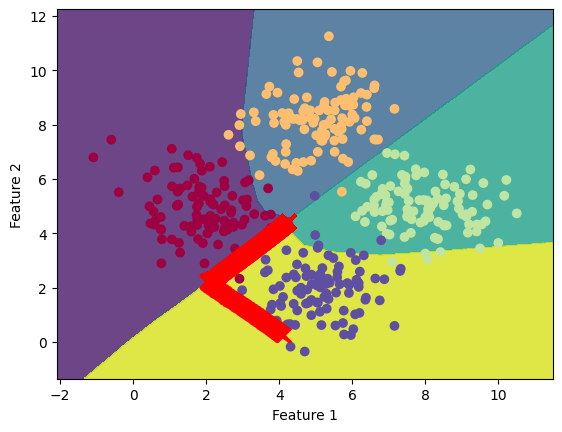

In [ ]:
experiment(4, generate_toy_data_4_classes_intersect, generate_adversarial_example_entropy ,1/4)

Epoch [10/100] Loss: 0.4721258580684662
Epoch [20/100] Loss: 0.5710541605949402
Epoch [30/100] Loss: 0.2982543706893921
Epoch [40/100] Loss: 0.4138685166835785
Epoch [50/100] Loss: 0.4140031933784485
Epoch [60/100] Loss: 0.30101895332336426
Epoch [70/100] Loss: 0.24894176423549652
Epoch [80/100] Loss: 0.23761975765228271
Epoch [90/100] Loss: 0.16196604073047638
Epoch [100/100] Loss: 0.12338551878929138
Training complete.
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################


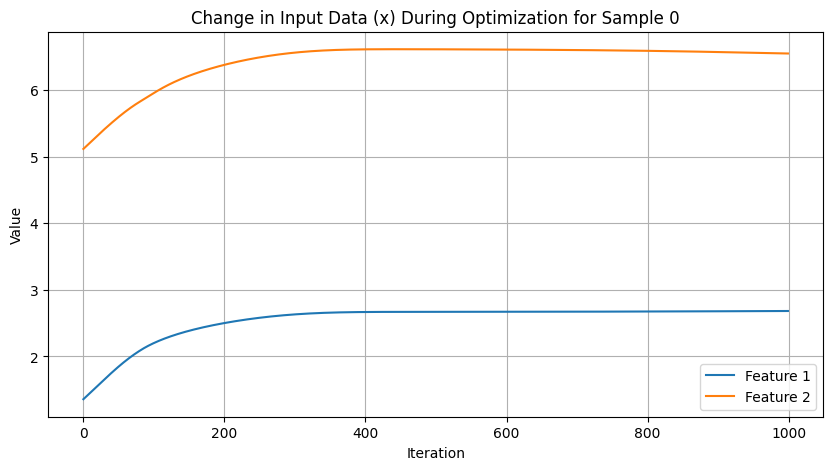

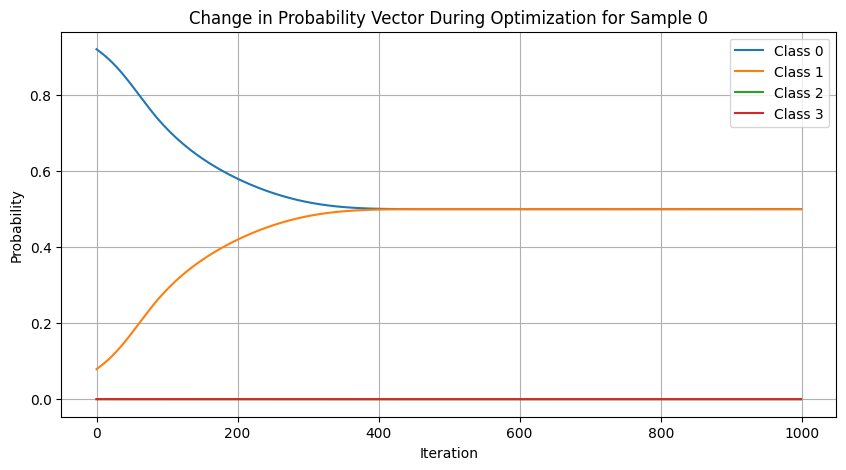

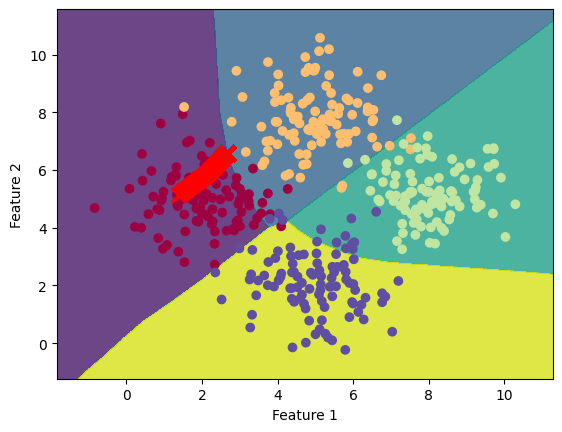

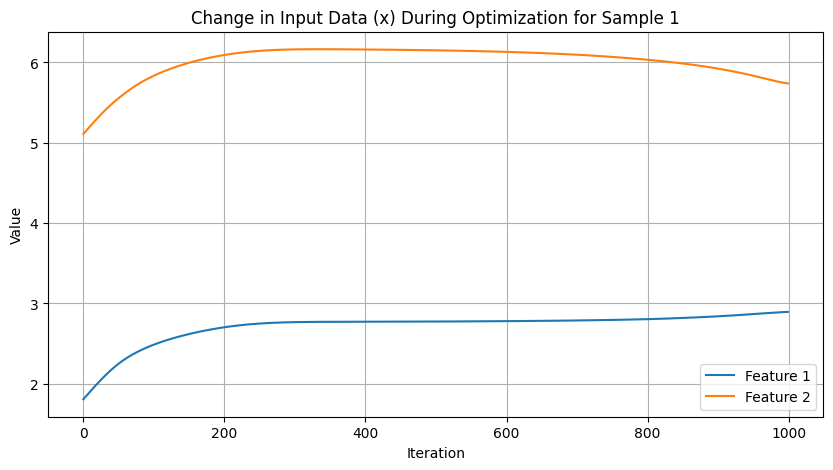

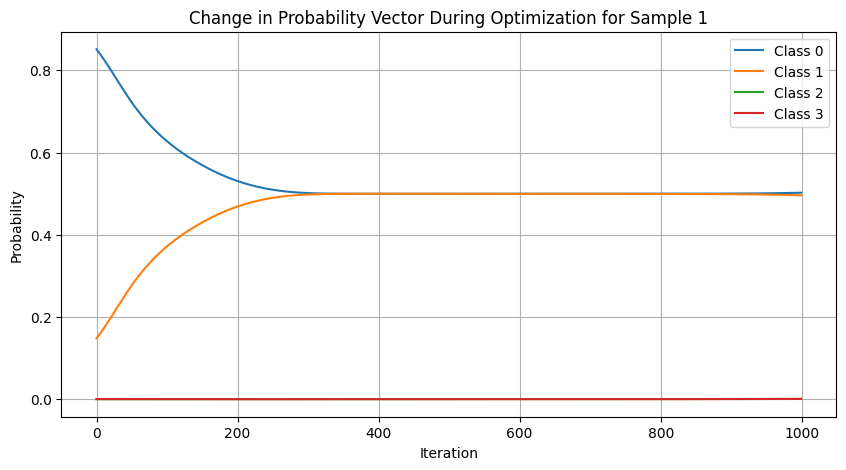

...

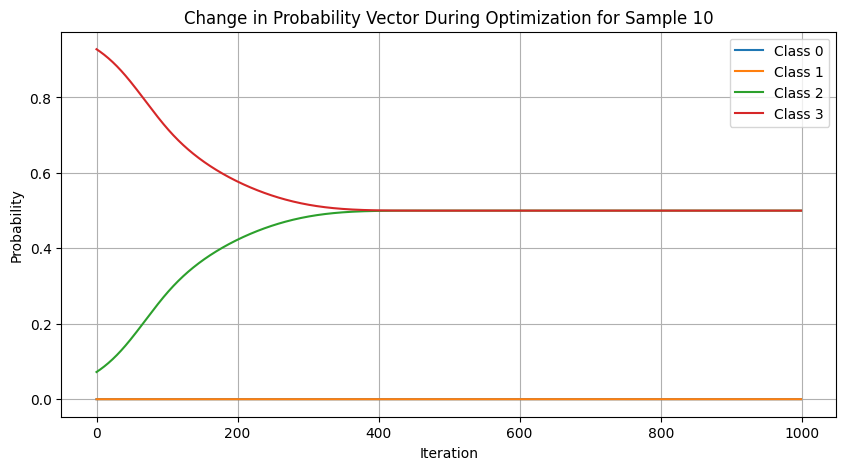

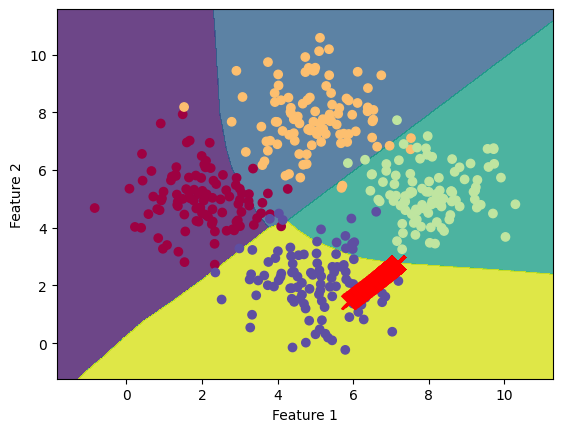

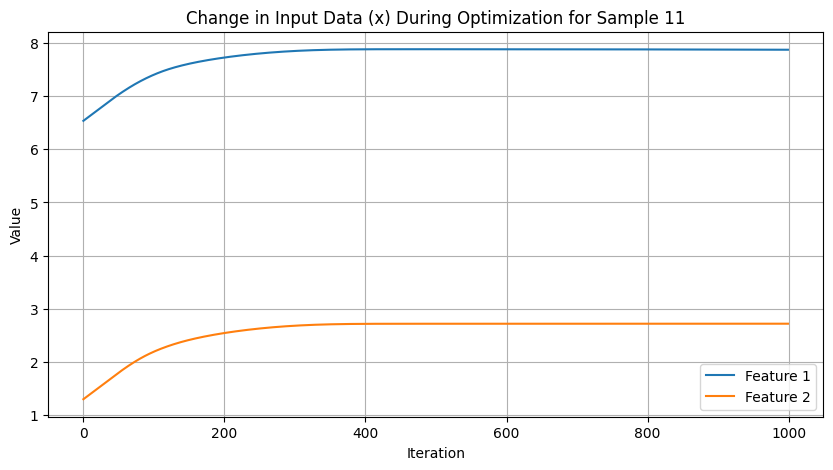

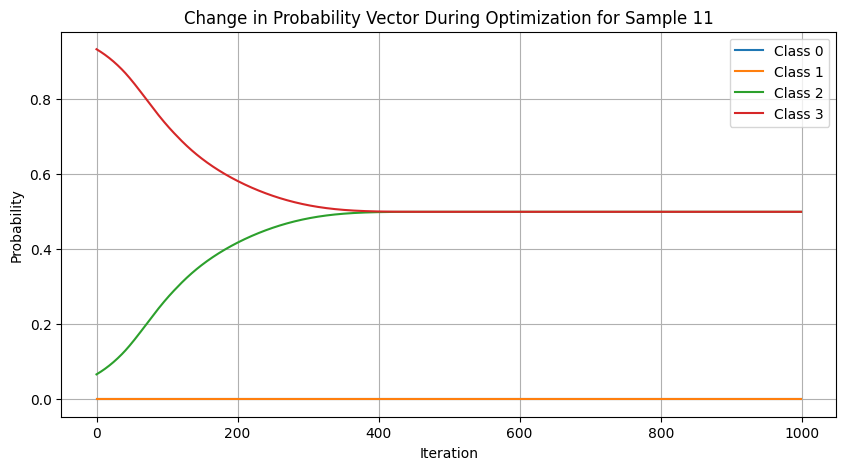

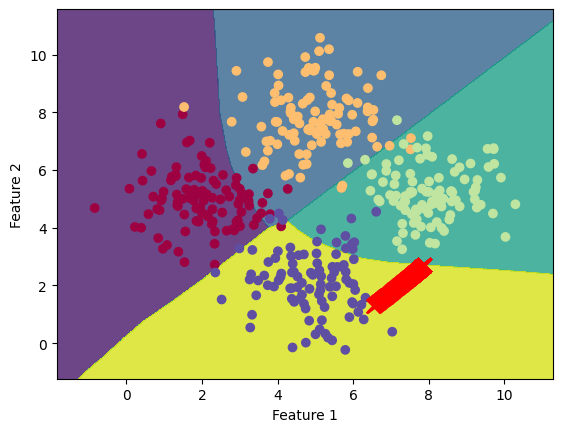

In [ ]:
experiment(4, generate_toy_data_4_classes_intersect, generate_adversarial_example_single_sample_decreasing_s ,1/4)

<class 'numpy.ndarray'>
<class 'list'>
Epoch [10/100] Loss: 0.2911939024925232
Epoch [20/100] Loss: 0.3370271623134613
Epoch [30/100] Loss: 0.23818309605121613
Epoch [40/100] Loss: 0.22749729454517365
Epoch [50/100] Loss: 0.1300838440656662
Epoch [60/100] Loss: 0.1641966849565506
Epoch [70/100] Loss: 0.30045560002326965
Epoch [80/100] Loss: 0.09900710731744766
Epoch [90/100] Loss: 0.06409592181444168
Epoch [100/100] Loss: 0.1313379853963852
Training complete.
<class 'numpy.ndarray'>
<class 'list'>
###################
###################
###################
###################
###################
###################
###################
###################
###################


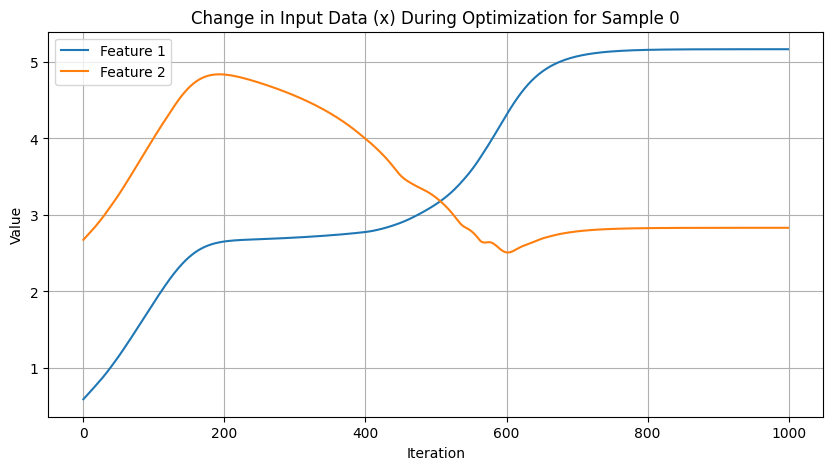

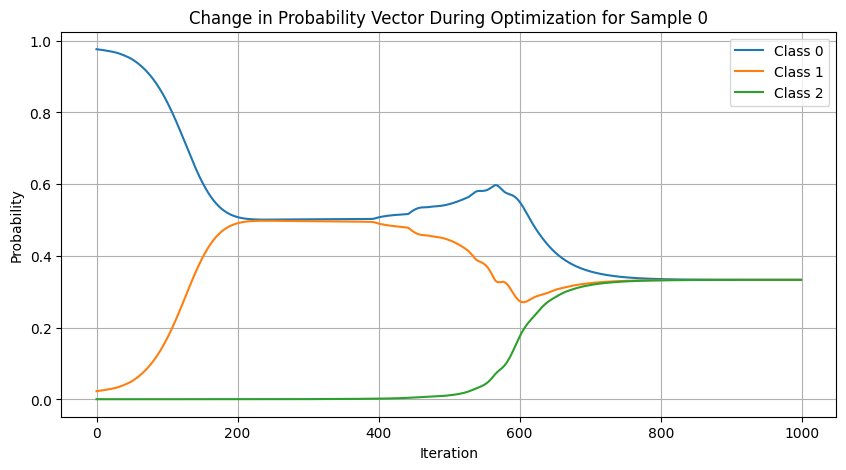

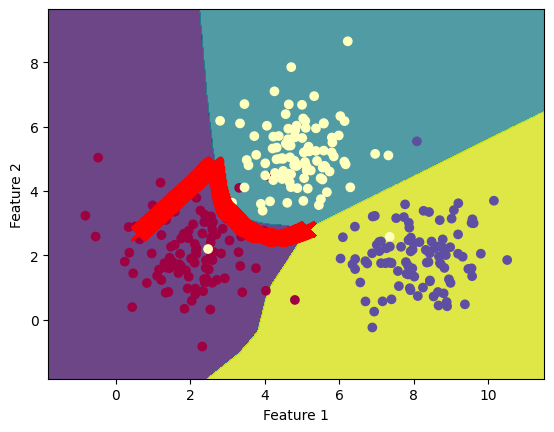

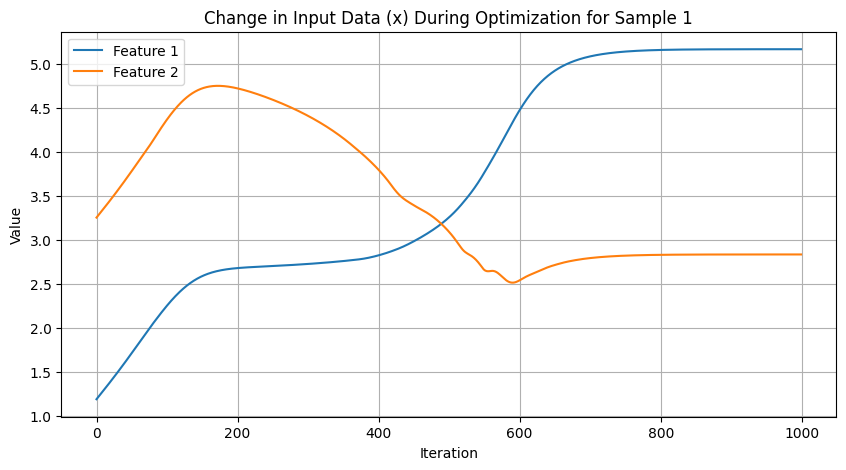

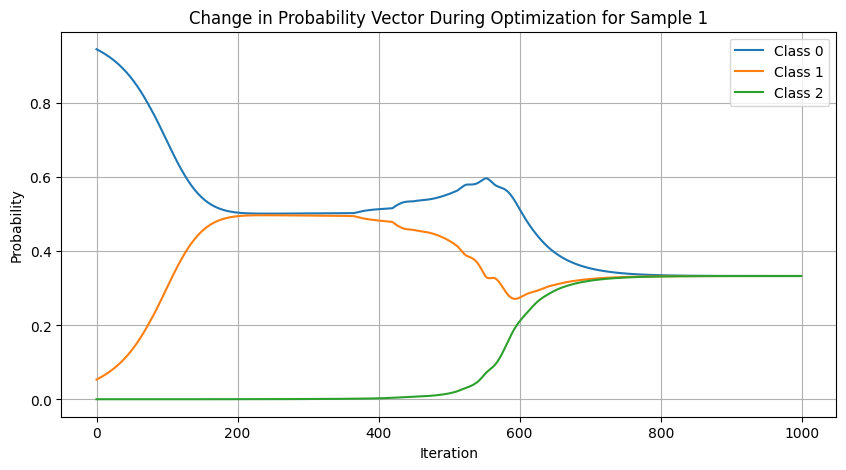

...

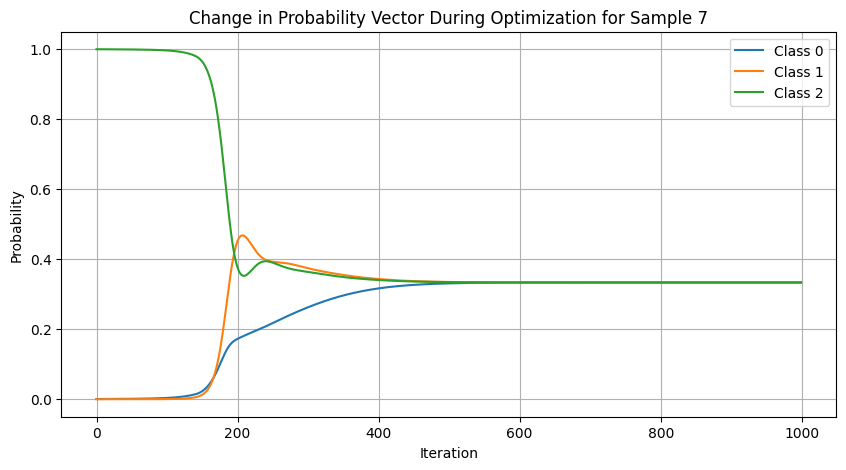

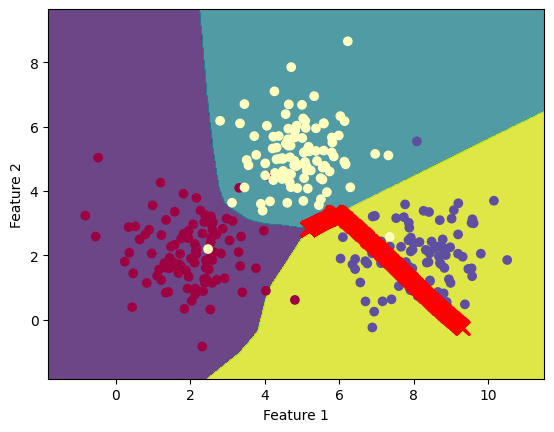

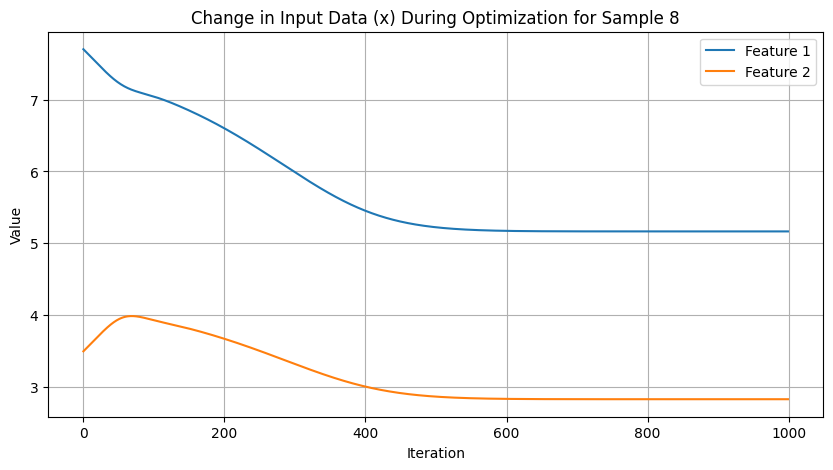

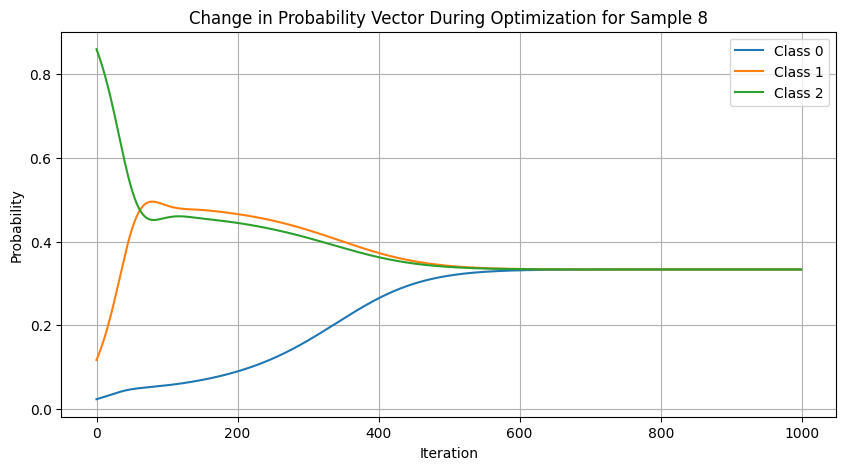

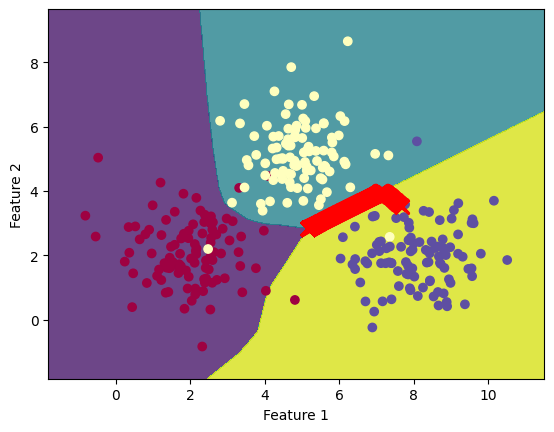

In [ ]:
experiment(3, generate_toy_data_3_classes, generate_adversarial_example_entropy ,1/3)

<class 'numpy.ndarray'>
<class 'list'>
Epoch [10/100] Loss: 0.4774061143398285
Epoch [20/100] Loss: 0.3721502721309662
Epoch [30/100] Loss: 0.2257712334394455
Epoch [40/100] Loss: 0.2702781558036804
Epoch [50/100] Loss: 0.12804967164993286
Epoch [60/100] Loss: 0.11079437285661697
Epoch [70/100] Loss: 0.12483397126197815
Epoch [80/100] Loss: 0.08312035351991653
Epoch [90/100] Loss: 0.08023662120103836
Epoch [100/100] Loss: 0.22563661634922028
Training complete.
<class 'numpy.ndarray'>
<class 'list'>
###################
###################
###################
###################
###################
###################
###################
###################
###################


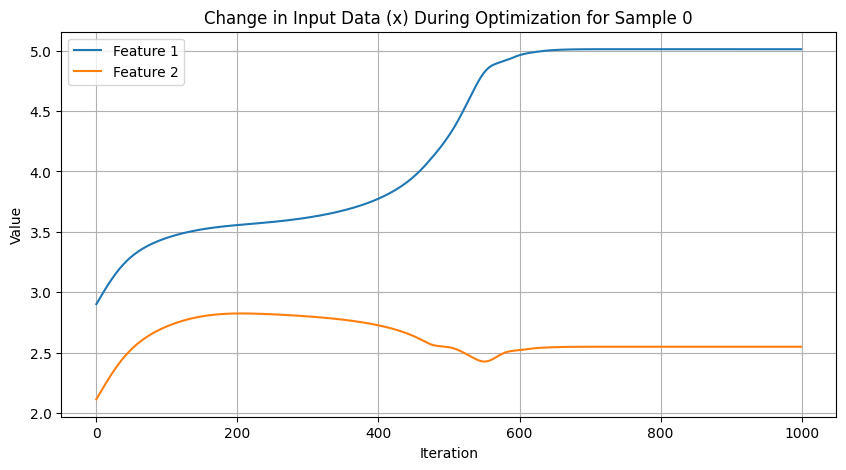

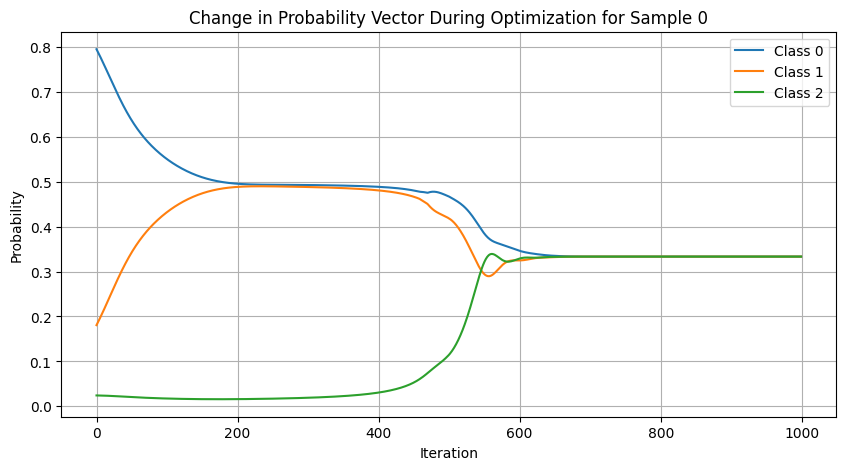

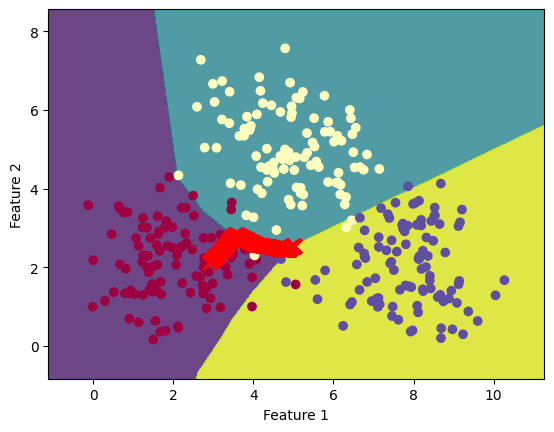

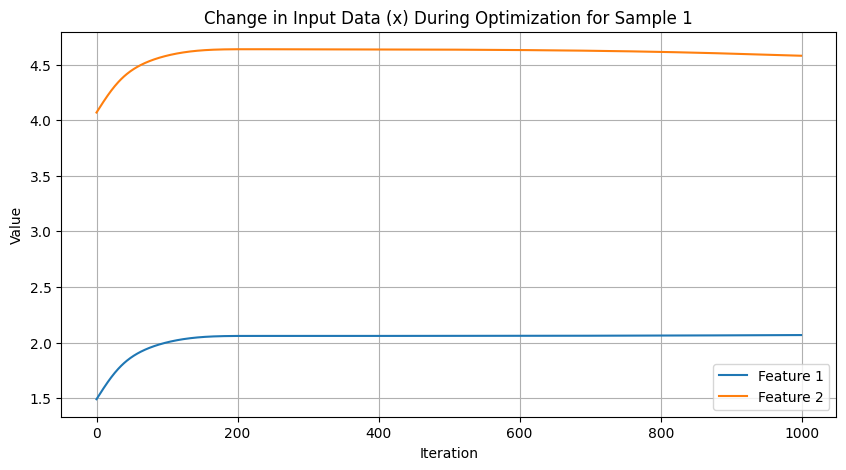

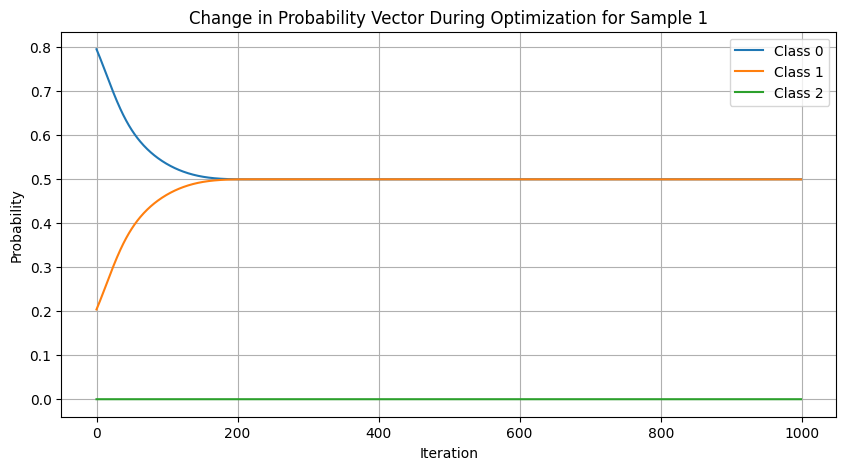

...

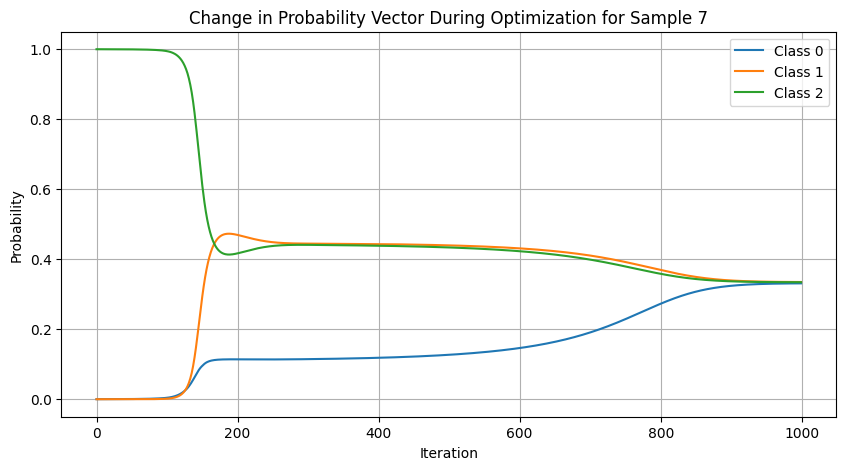

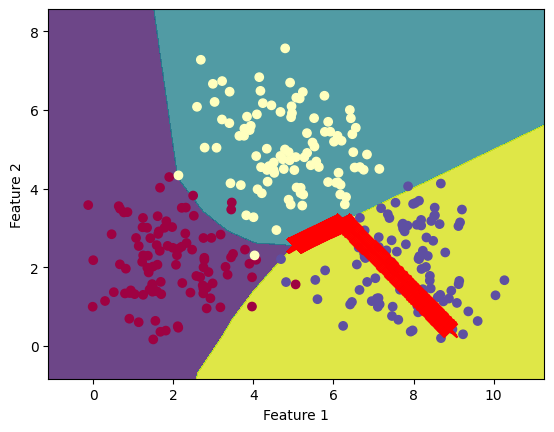

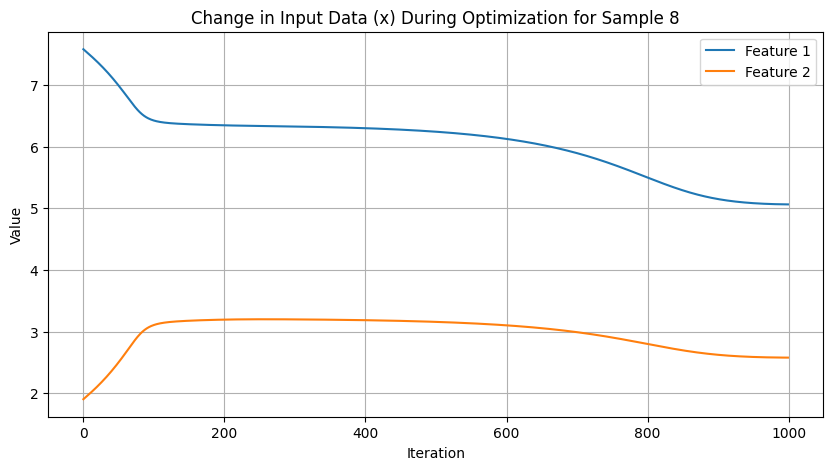

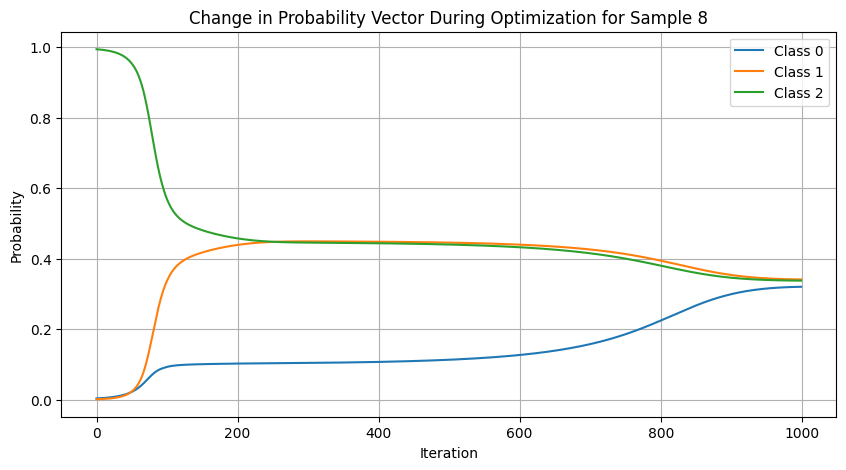

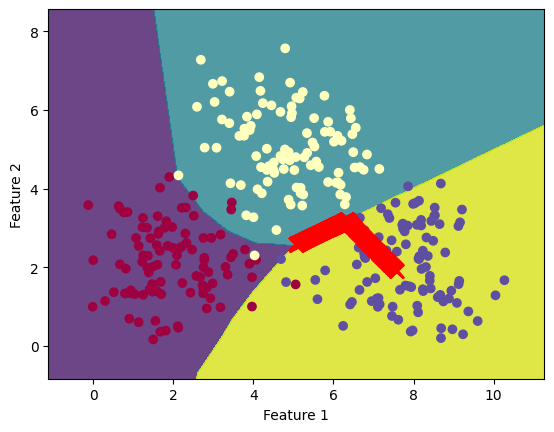

In [ ]:
experiment(3, generate_toy_data_3_classes, generate_adversarial_example_single_sample_decreasing_s ,1/3)

Epoch [10/100] Loss: 0.23252640664577484
Epoch [20/100] Loss: 0.23876123130321503
Epoch [30/100] Loss: 0.25632569193840027
Epoch [40/100] Loss: 0.17428605258464813
Epoch [50/100] Loss: 0.22075273096561432
Epoch [60/100] Loss: 0.13895989954471588
Epoch [70/100] Loss: 0.11010225862264633
Epoch [80/100] Loss: 0.03998398780822754
Epoch [90/100] Loss: 0.11445346474647522
Epoch [100/100] Loss: 0.1733219027519226
Training complete.
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################


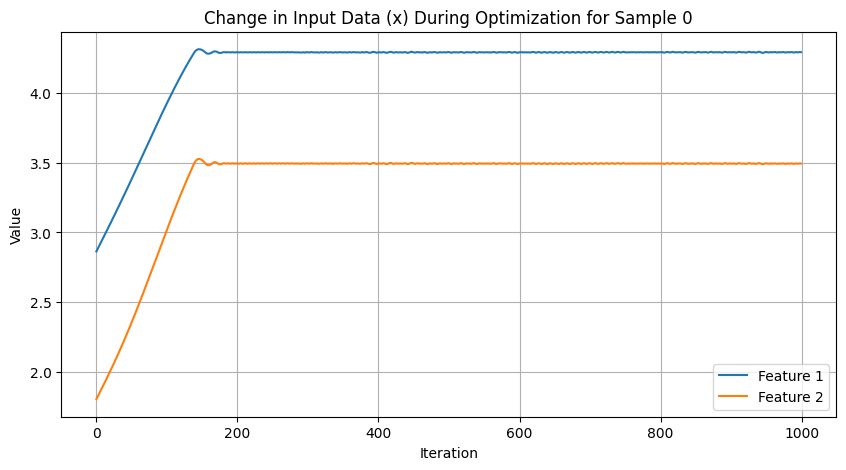

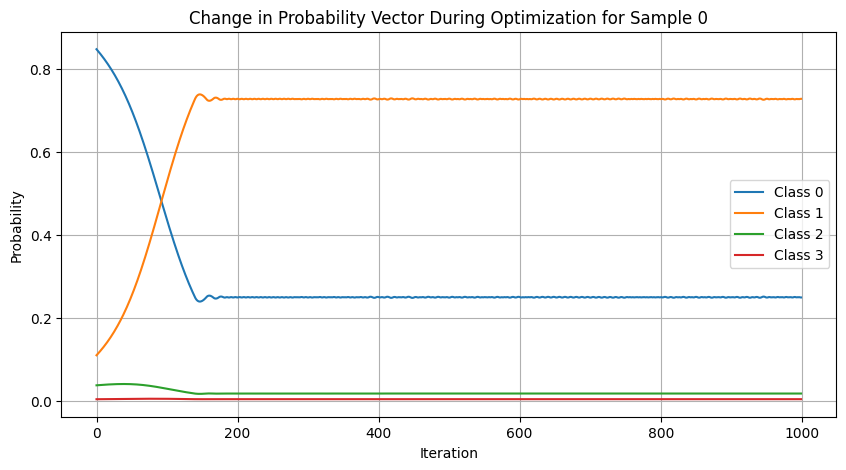

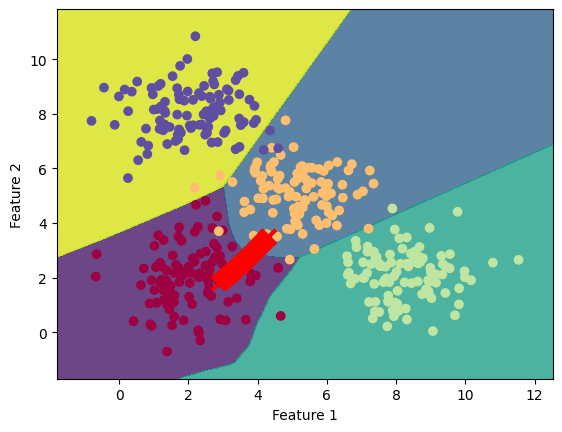

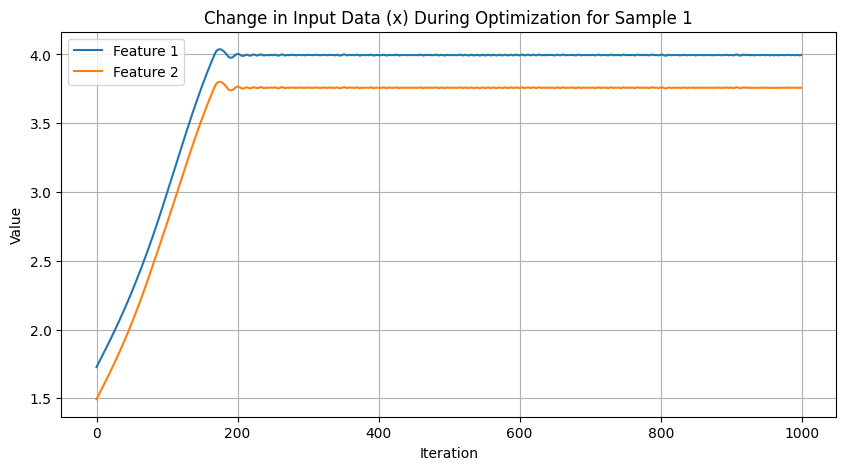

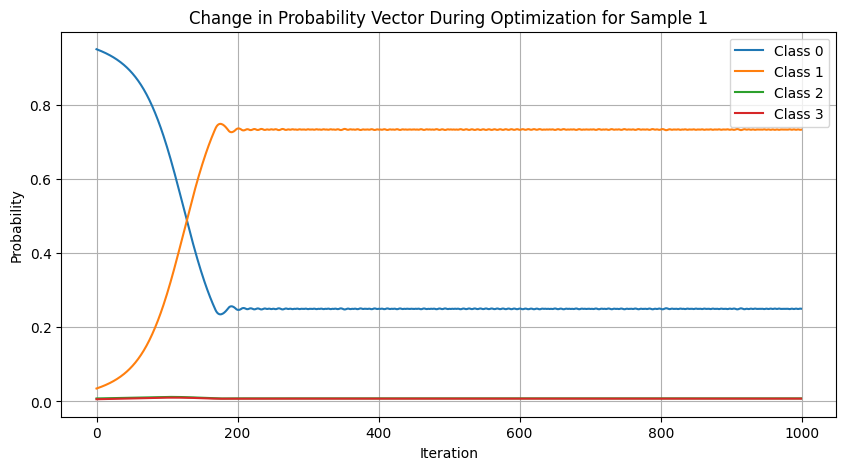

...

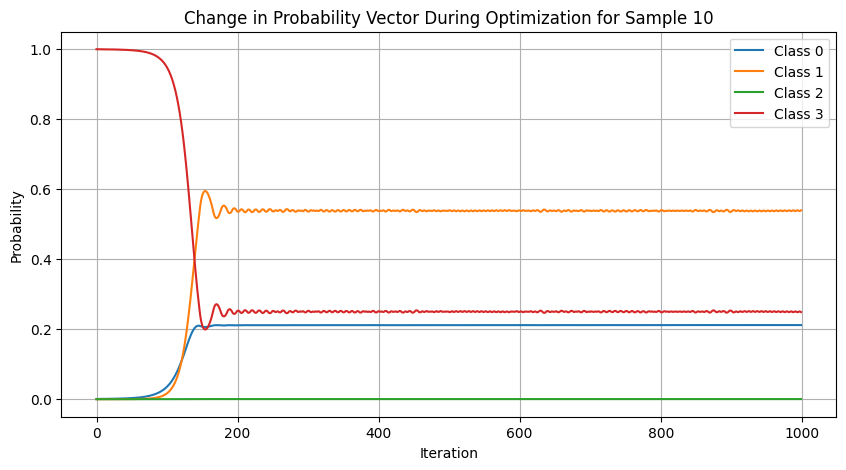

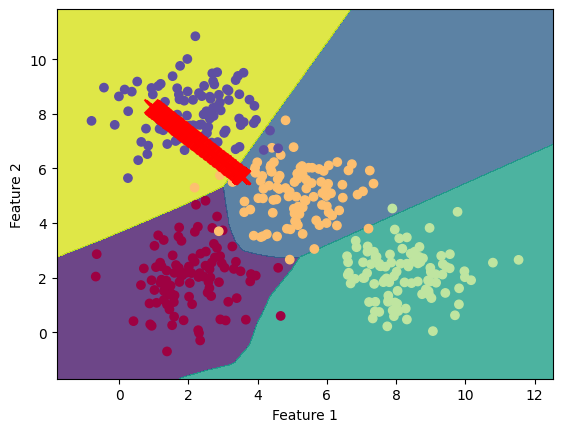

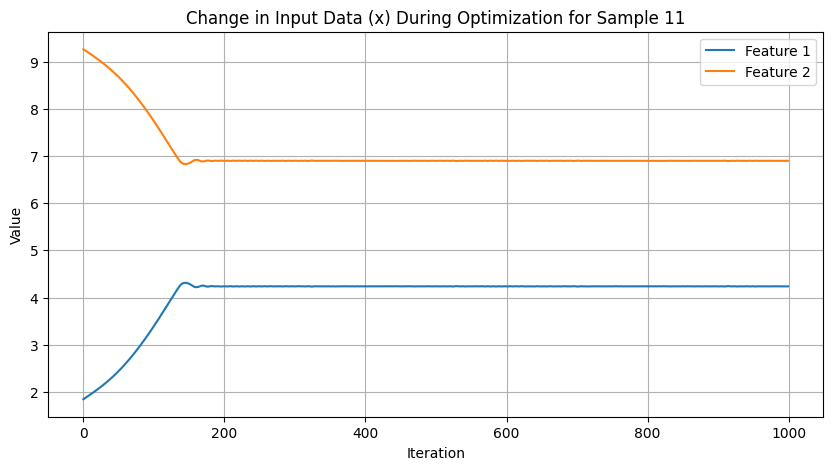

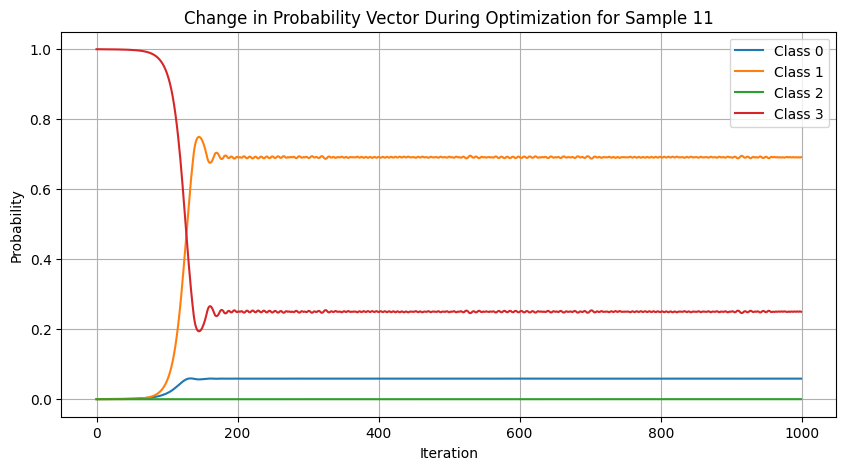

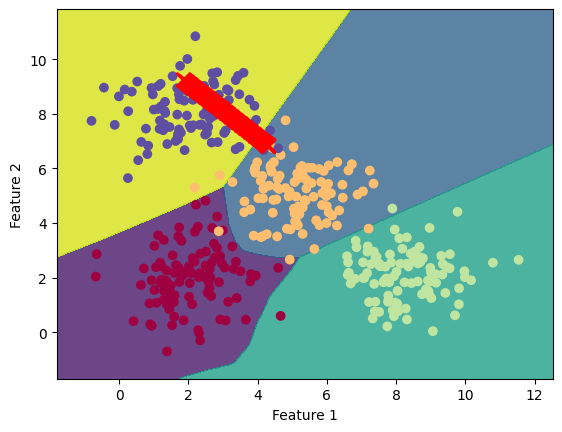

In [ ]:
experiment(4, generate_toy_data_4_classes, generate_adversarial_example_entropy, 1/4)

# Experiment

## Train model

In [ ]:
# Generate toy data
num_samples_per_class = 100
num_classes = 3
data, labels = generate_toy_data_3_classes(num_samples_per_class)

<class 'numpy.ndarray'>
<class 'list'>


In [ ]:
# Convert data and labels to PyTorch tensors
data = torch.FloatTensor(data)
labels = torch.LongTensor(labels)

# Create a dataset and DataLoader
dataset = TensorDataset(data, labels)
batch_size = 32
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [ ]:

# Define model and loss function
input_dim = 2
hidden_dim = 64
output_dim = num_classes
model = SimpleNN(input_dim, hidden_dim, output_dim)
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.01)
num_epochs = 100

for epoch in range(num_epochs):
    for batch_data, batch_labels in dataloader:
        optimizer.zero_grad()
        outputs = model(batch_data)
        loss = criterion(outputs, batch_labels)
        loss.backward()
        optimizer.step()

    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}] Loss: {loss.item()}')

print('Training complete.')


Epoch [10/100] Loss: 0.4019244611263275
Epoch [20/100] Loss: 0.29733189940452576
Epoch [30/100] Loss: 0.28657323122024536
Epoch [40/100] Loss: 0.35772743821144104
Epoch [50/100] Loss: 0.1345071792602539
Epoch [60/100] Loss: 0.1836996227502823
Epoch [70/100] Loss: 0.14027006924152374
Epoch [80/100] Loss: 0.11440222710371017
Epoch [90/100] Loss: 0.15532808005809784
Epoch [100/100] Loss: 0.2731161415576935
Training complete.


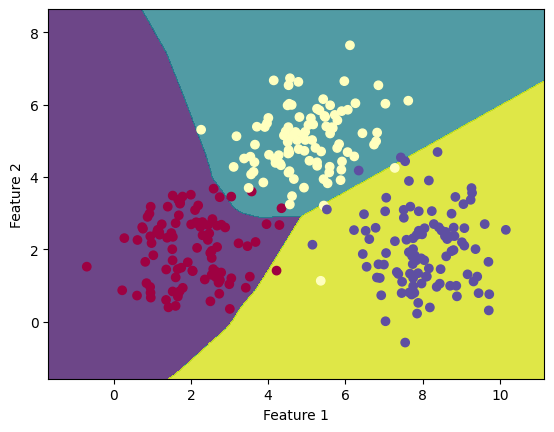

In [ ]:
plot_decision_boundary(model, data, labels)

### Specific example

In [ ]:
# Create a list of data samples in the relevant range
# data_samples, _ = [[0.8305, 3.3124]], []
data_samples, _ = [[1.5, 8.5]], []
data_samples = torch.FloatTensor(data_samples)

#  [torch.FloatTensor([8.0, 5.0]), torch.FloatTensor([4.0, 3.0]), torch.FloatTensor([1.0, 1.0])]  # Modify as needed
target_l2 = 1 / 2

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_single_sample(model, data_sample, target_l2, num_iterations=300)

    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()

    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x itself during optimization for the first sample
    sample_idx_to_visualize = result['Sample']  # Change this index to visualize a different sample
    x_history = np.array(results[sample_idx_to_visualize]['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the first sample
    prob_vector_history = np.array(results[sample_idx_to_visualize]['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    plot_decision_boundary_with_x_history(model, data, labels, results[sample_idx_to_visualize]['X History'])

### Random Examples

<class 'numpy.ndarray'>
<class 'list'>
Sample 0 - Final Loss: 58.074989318847656


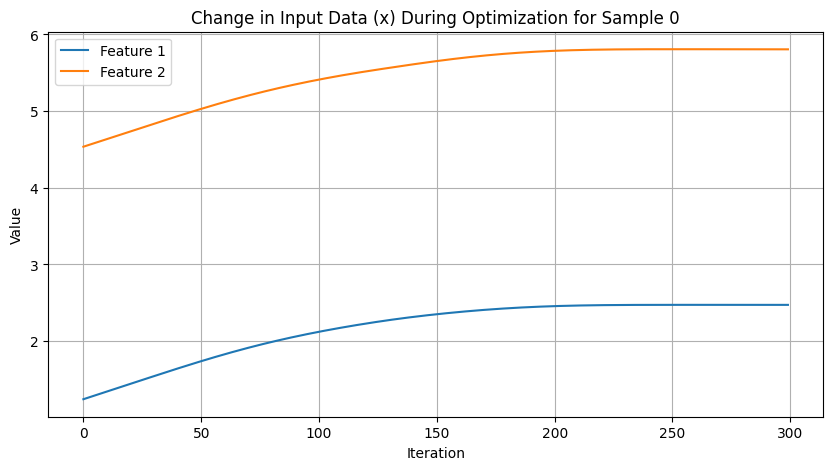

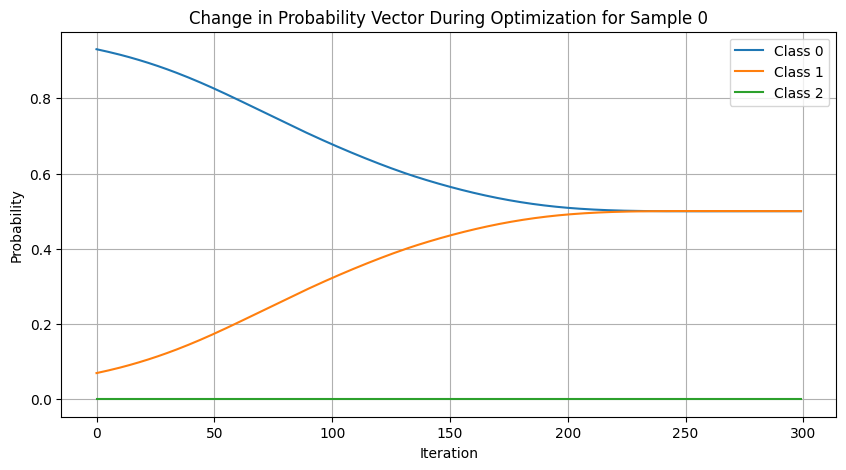

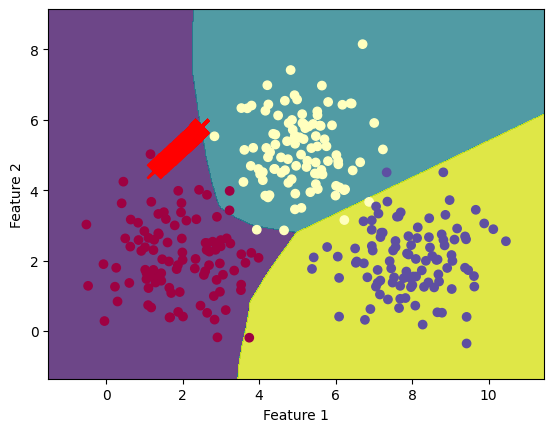

Sample 1 - Final Loss: 12.864343643188477


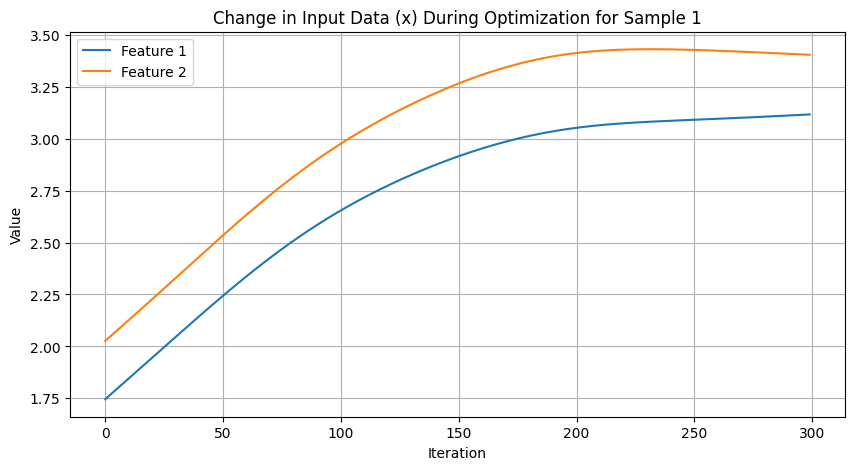

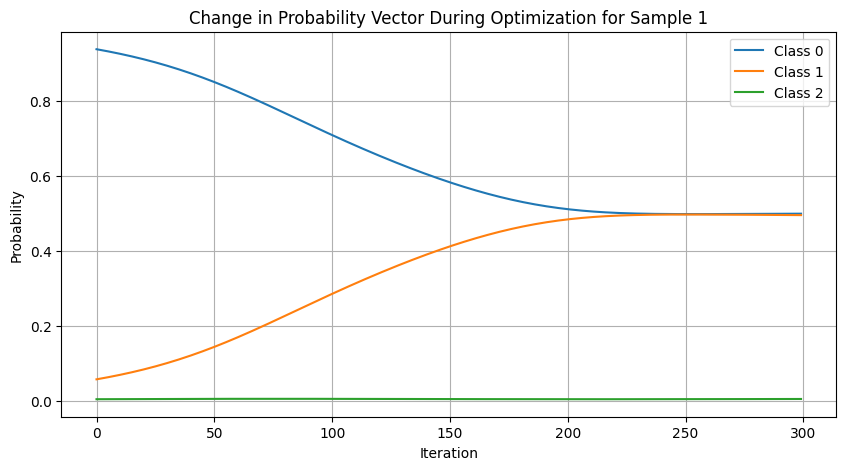

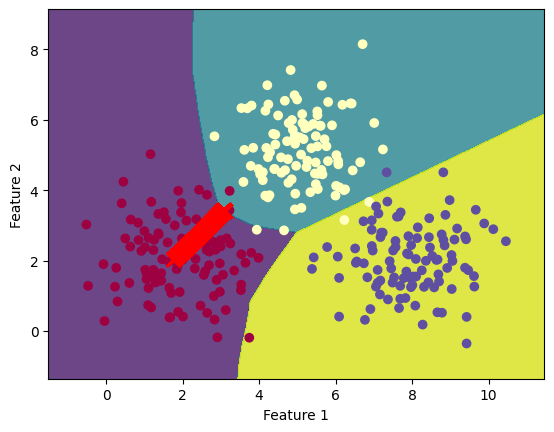

Sample 2 - Final Loss: 15.968631744384766


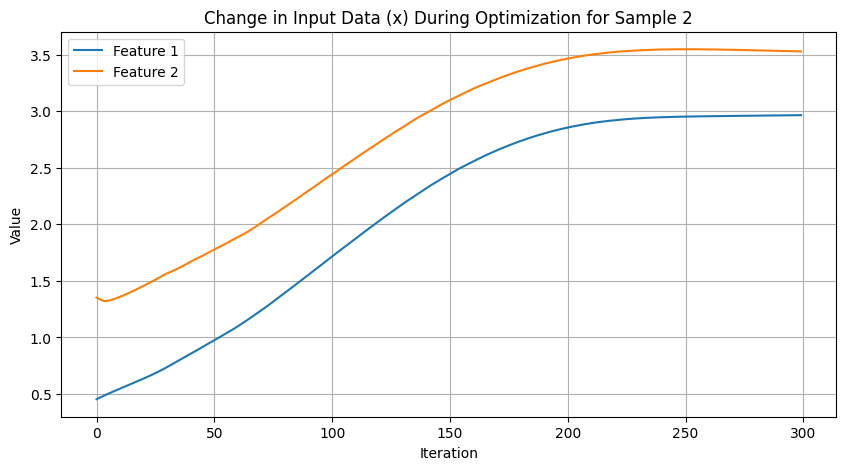

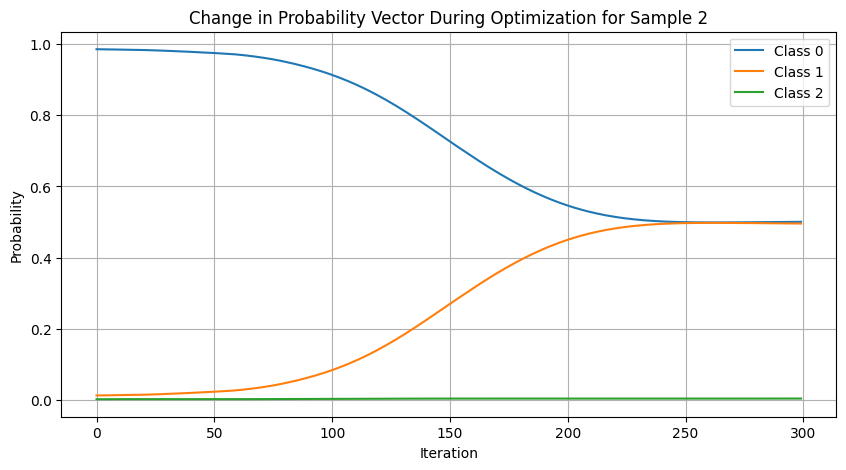

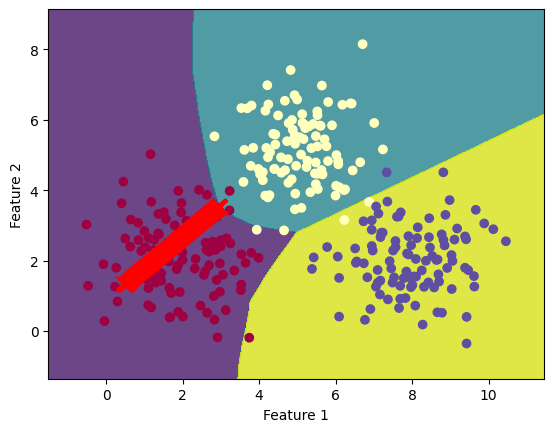

Sample 3 - Final Loss: 0.46293628215789795


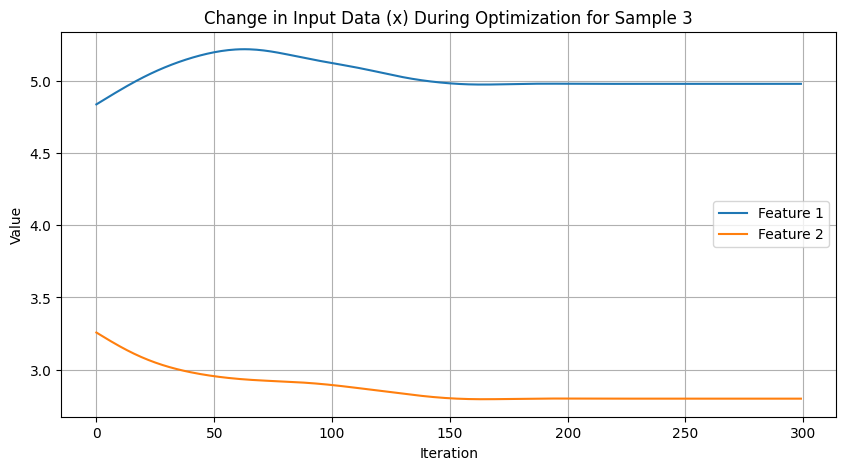

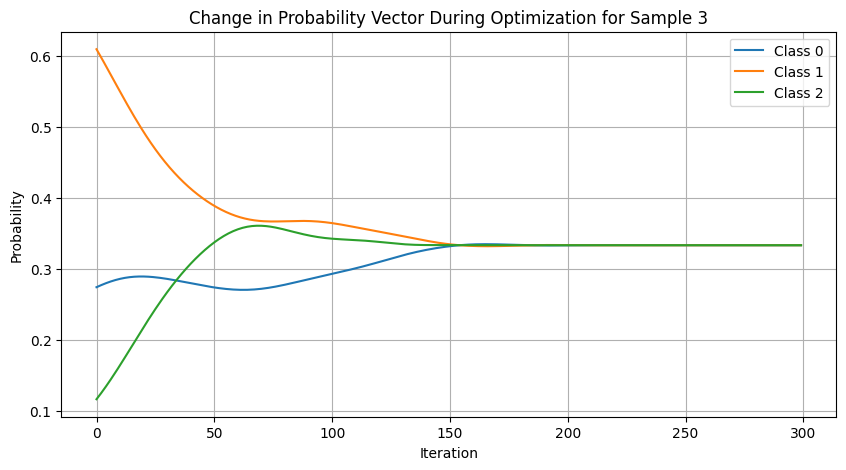

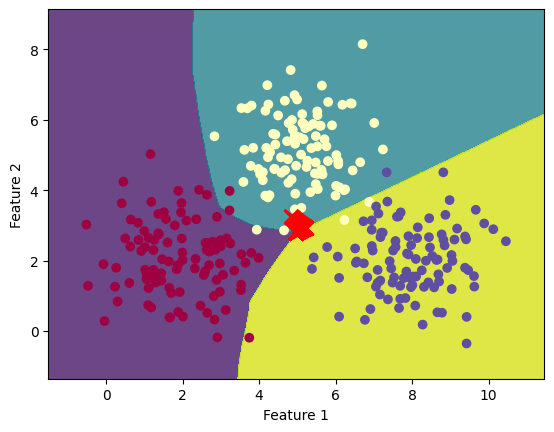

Sample 4 - Final Loss: 20.928508758544922


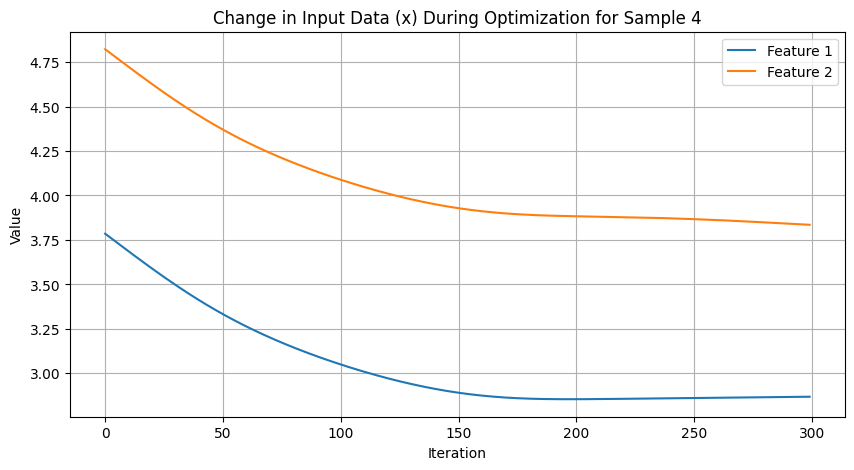

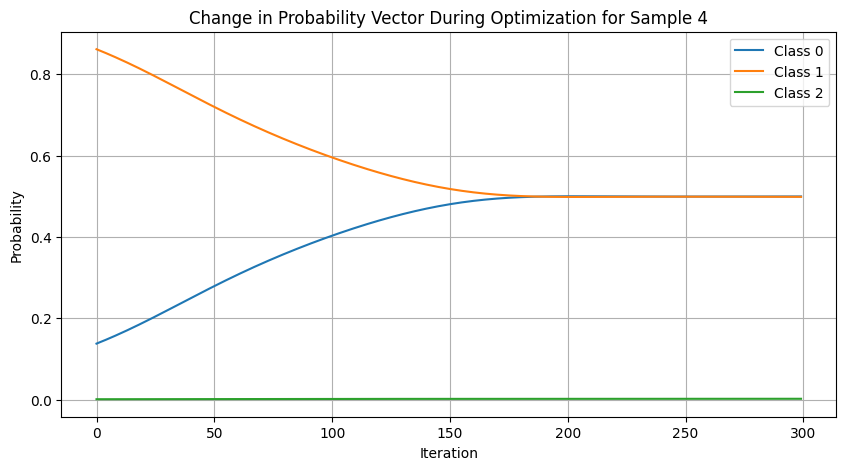

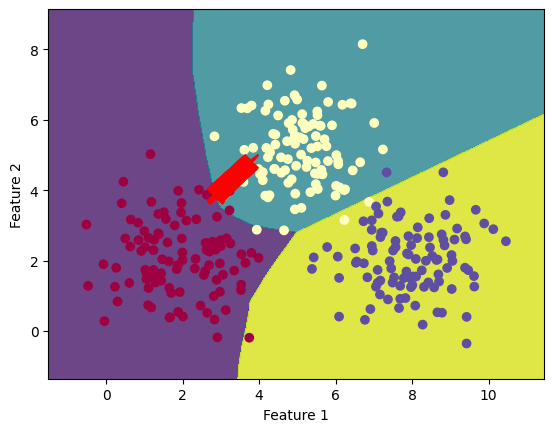

Sample 5 - Final Loss: 33.83937454223633


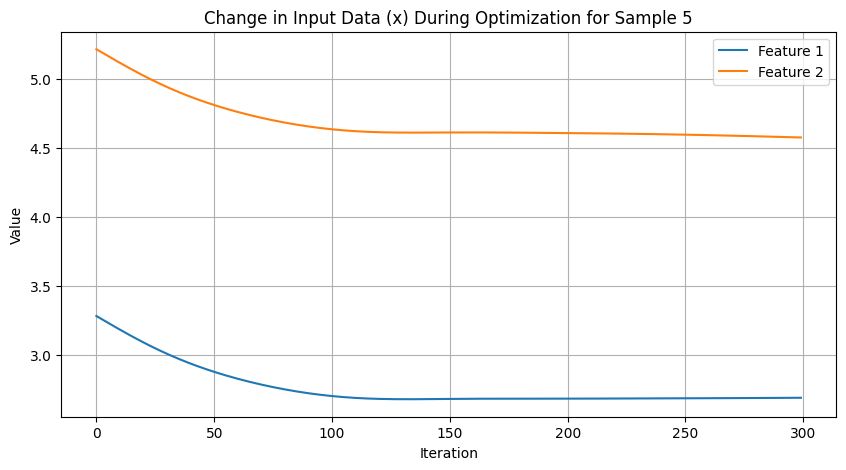

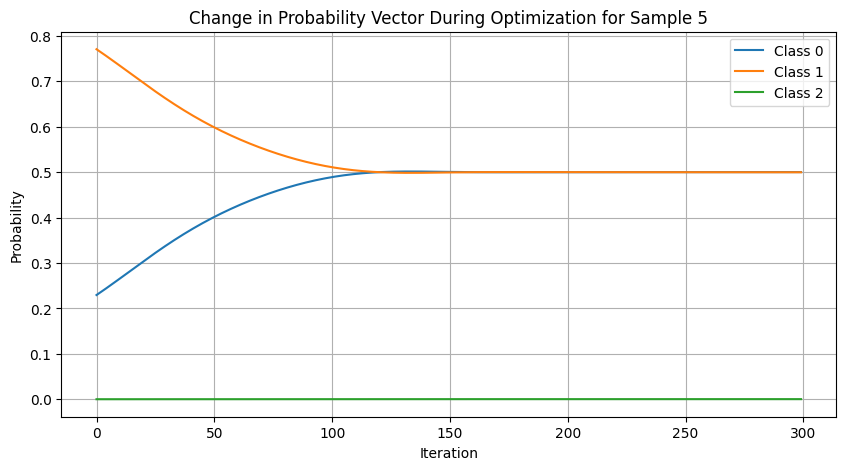

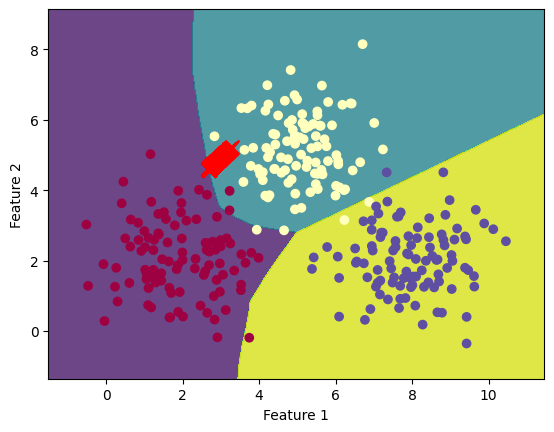

Sample 6 - Final Loss: 0.2683693468570709


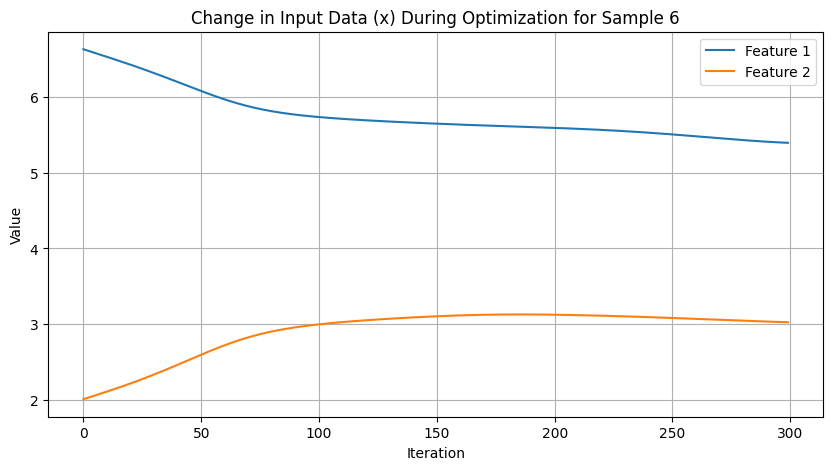

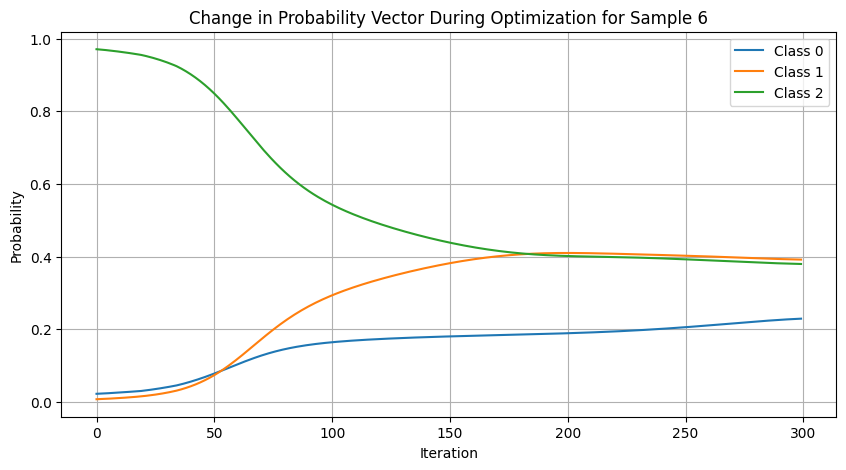

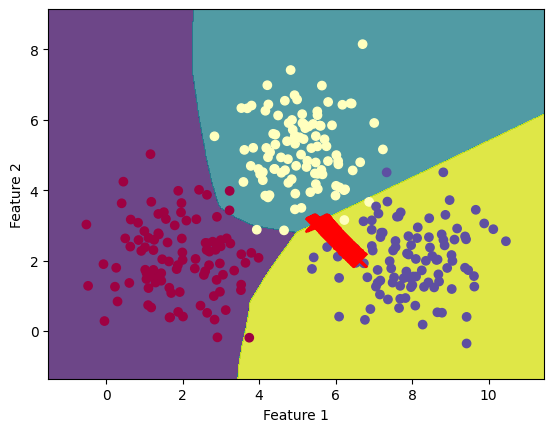

Sample 7 - Final Loss: 0.4628584384918213


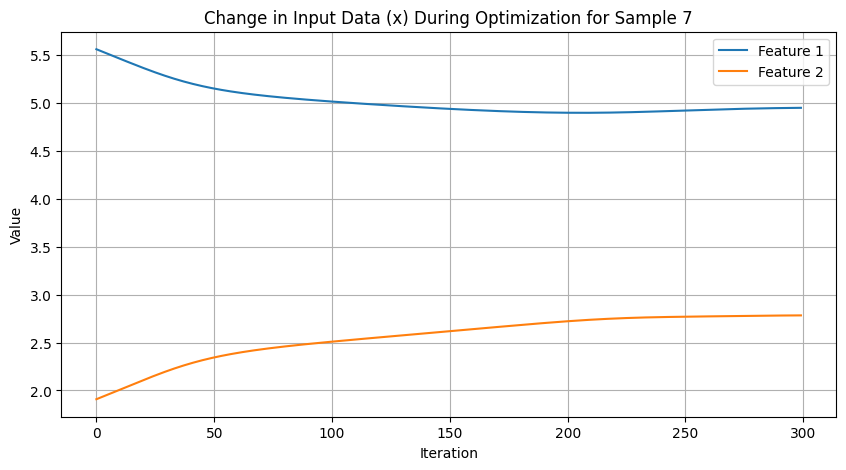

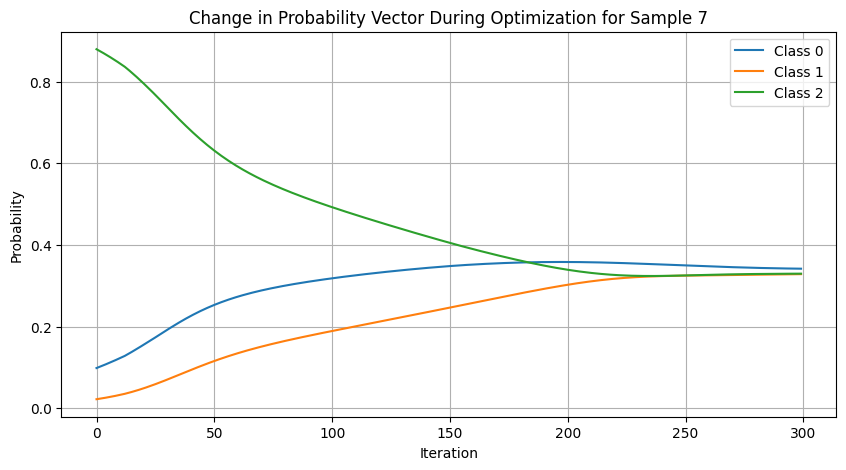

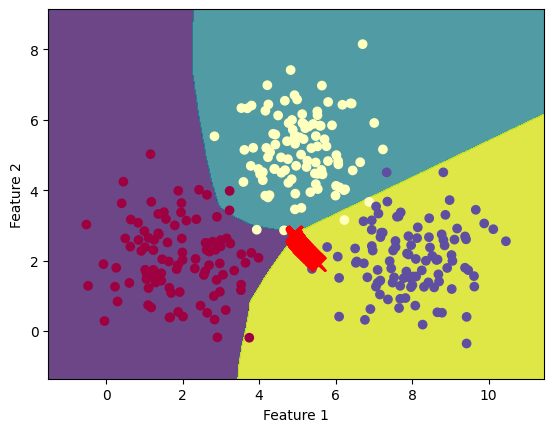

Sample 8 - Final Loss: 2.786999464035034


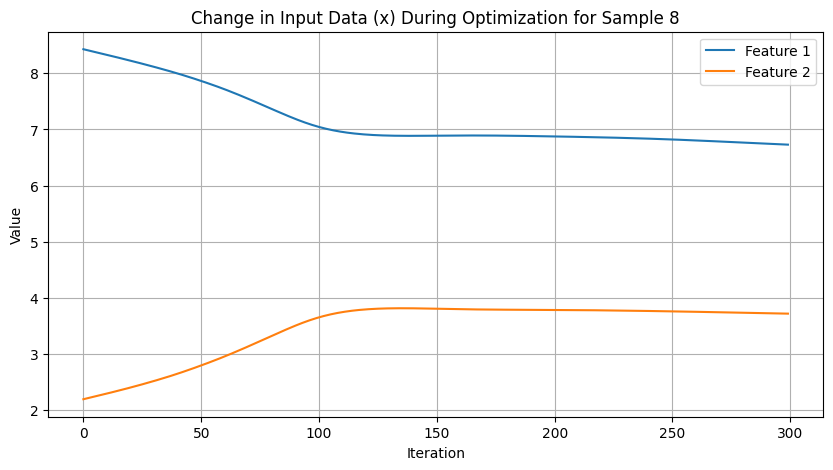

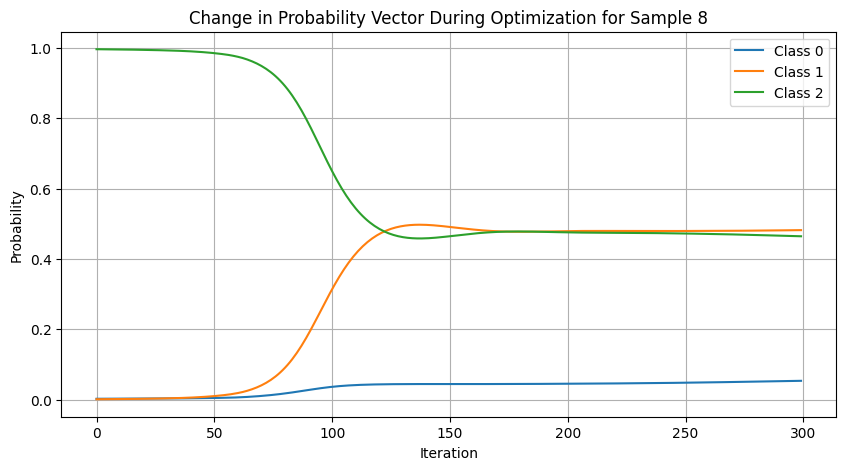

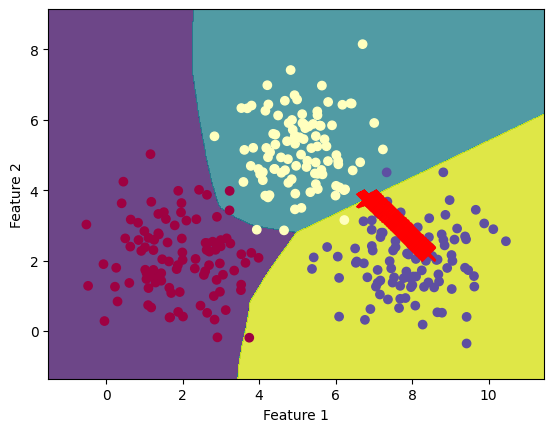

In [ ]:
# Create a list of data samples in the relevant range
data_samples, _ = generate_toy_data_3_classes(3, 3)
data_samples = torch.FloatTensor(data_samples)
target_l2 = 1 / 2

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_single_sample_nikita(model, data_sample, target_l2, num_iterations=300)

    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()


    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x itself during optimization for the first sample
    sample_idx_to_visualize = result['Sample']  # Change this index to visualize a different sample
    x_history = np.array(results[sample_idx_to_visualize]['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the first sample
    prob_vector_history = np.array(results[sample_idx_to_visualize]['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    plot_decision_boundary_with_x_history(model, data, labels, results[sample_idx_to_visualize]['X History'])

<class 'numpy.ndarray'>
<class 'list'>
Sample 0 - Final Loss: 0.23696057498455048


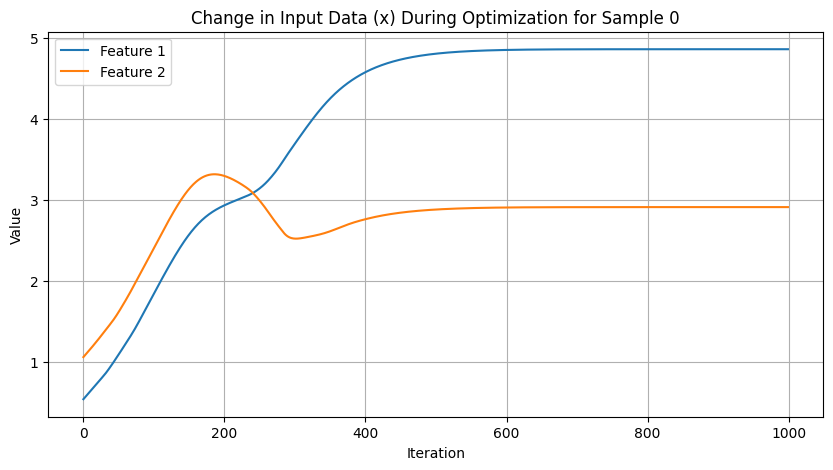

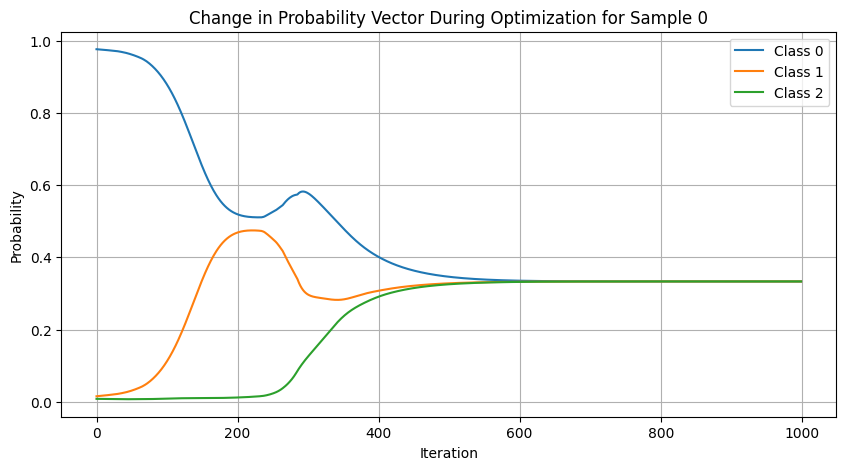

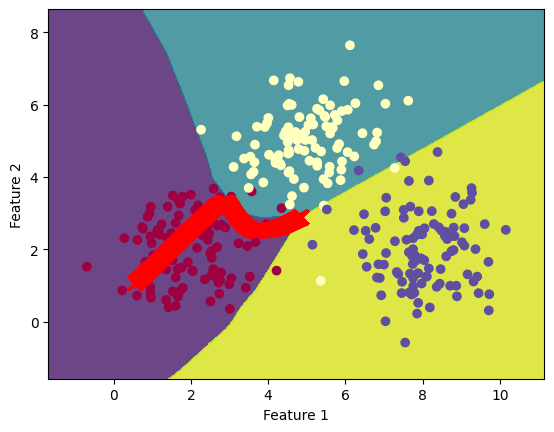

Sample 1 - Final Loss: 0.23696057498455048


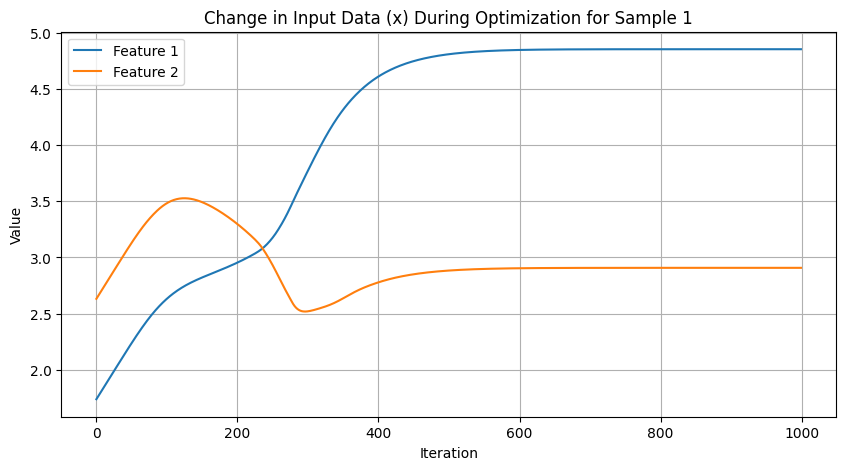

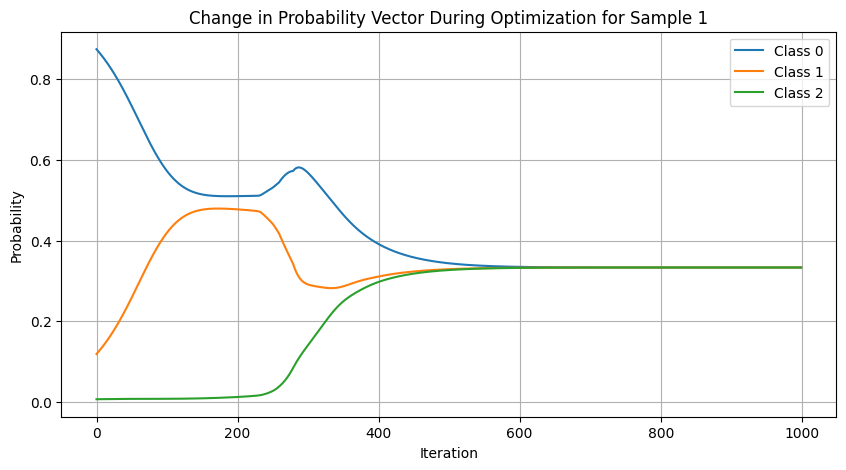

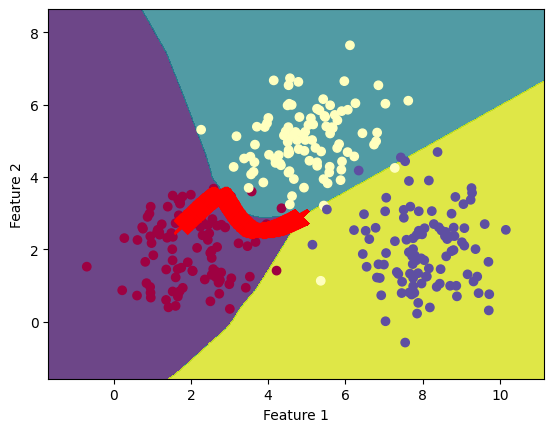

Sample 2 - Final Loss: 0.23696058988571167


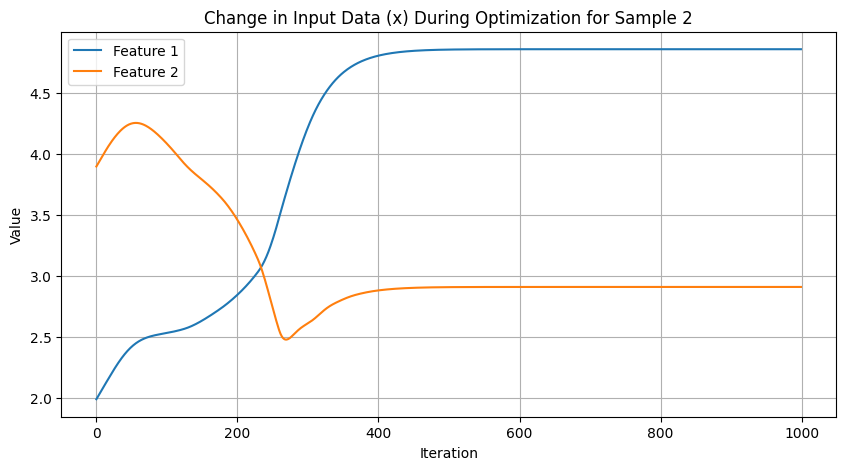

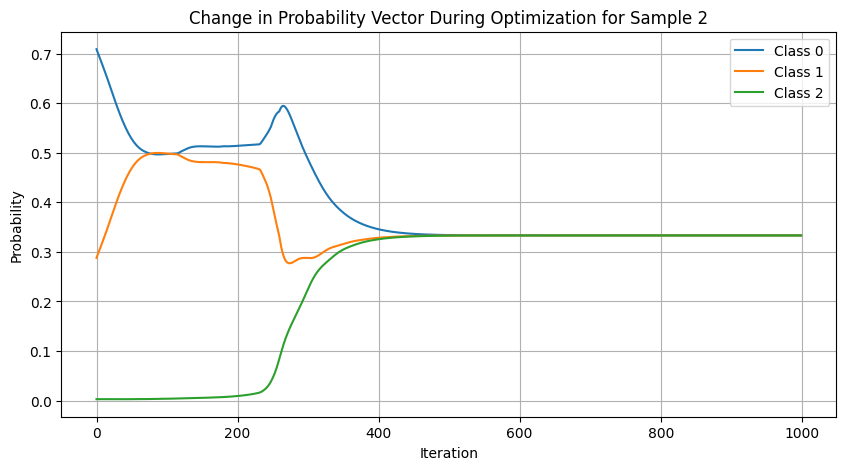

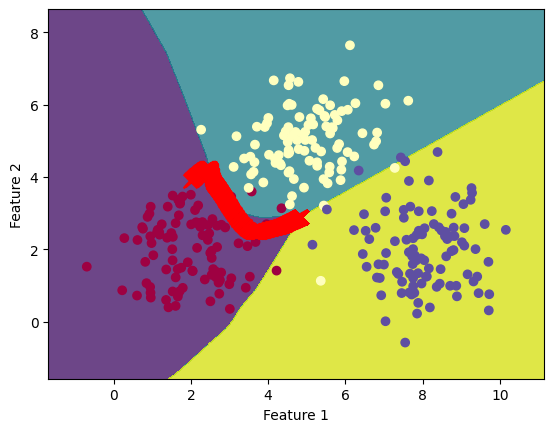

Sample 3 - Final Loss: 0.23696060478687286


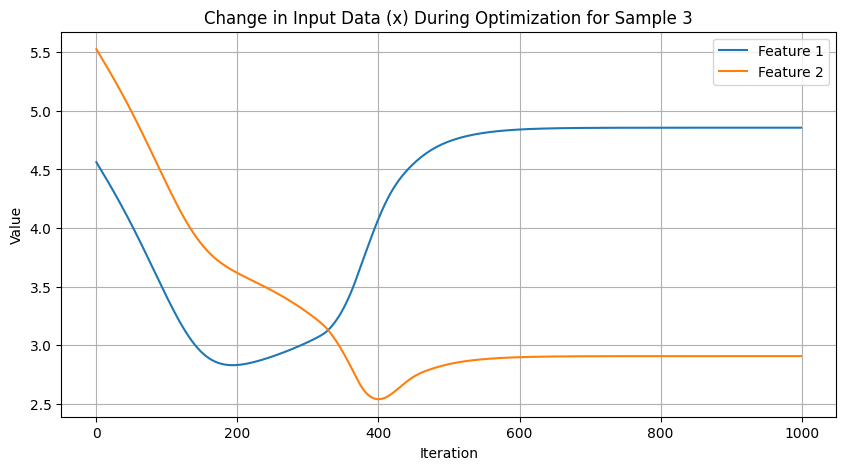

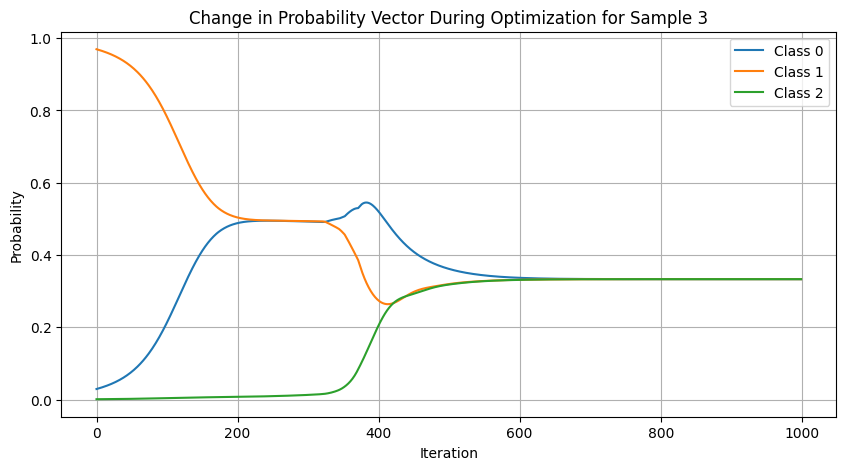

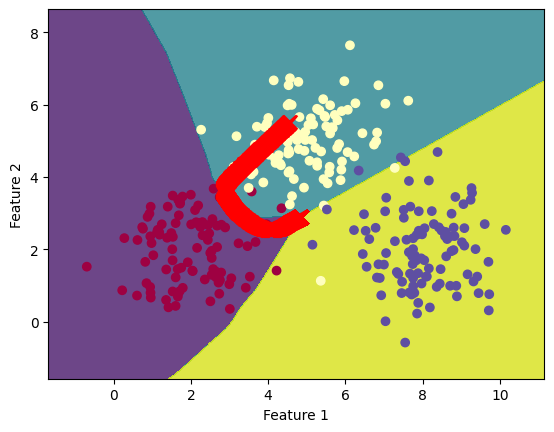

Sample 4 - Final Loss: 0.23696061968803406


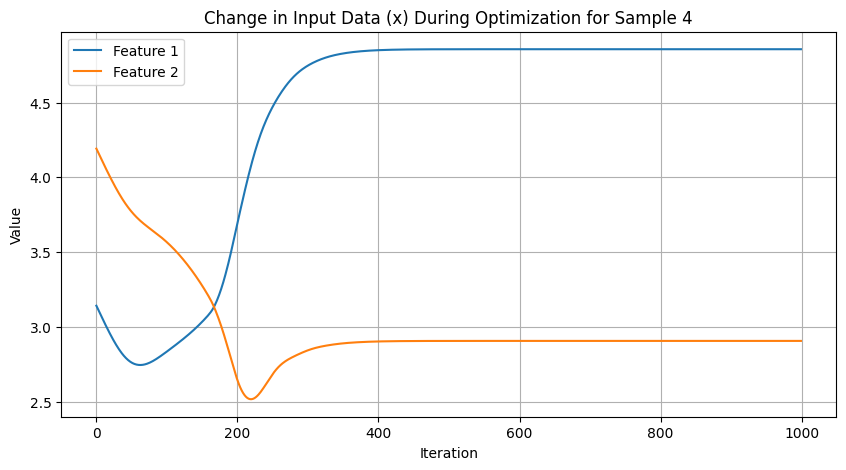

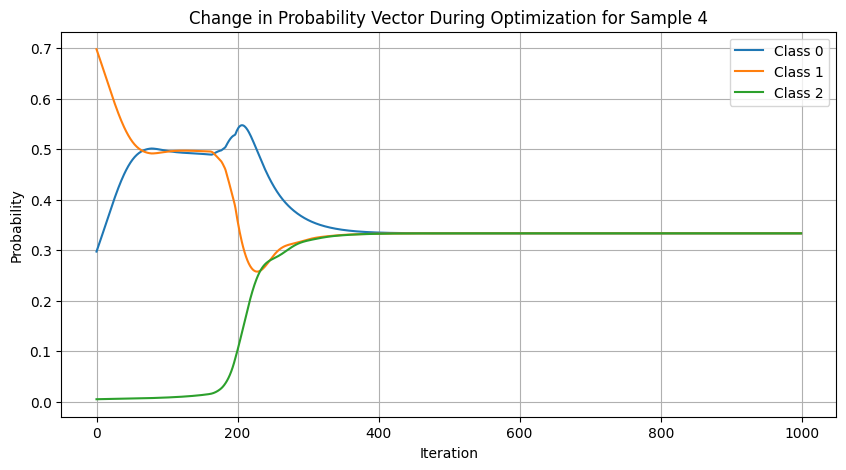

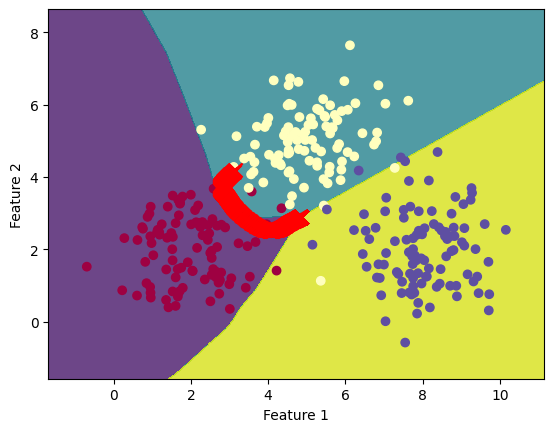

Sample 5 - Final Loss: 0.23696064949035645


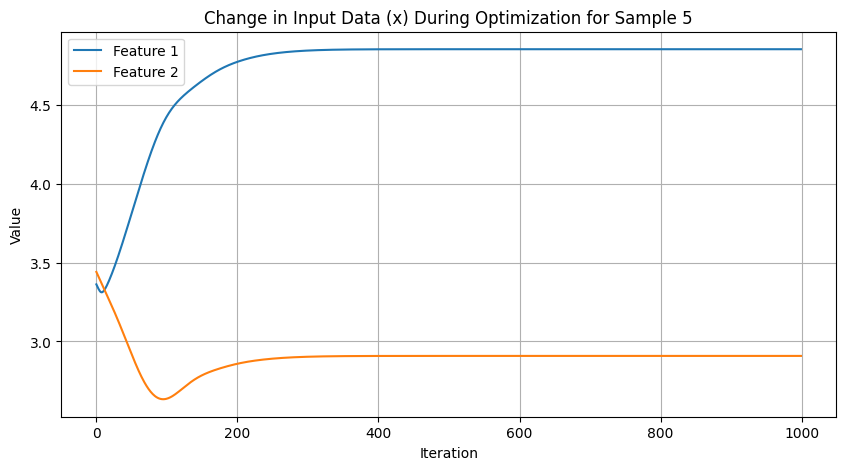

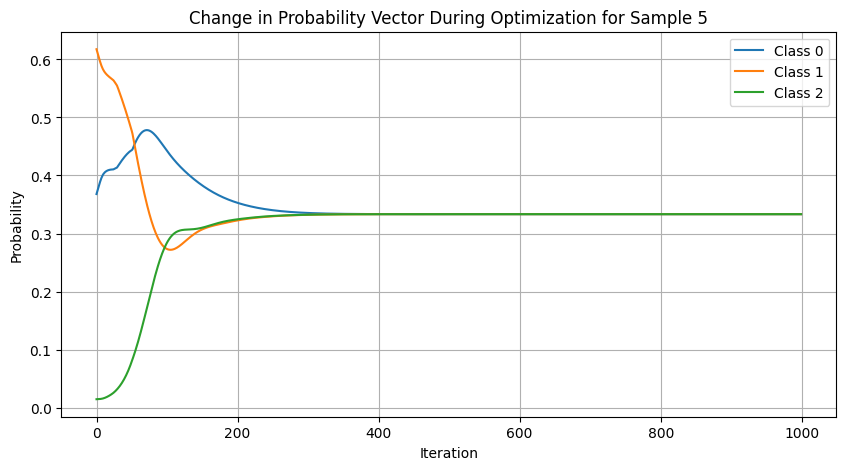

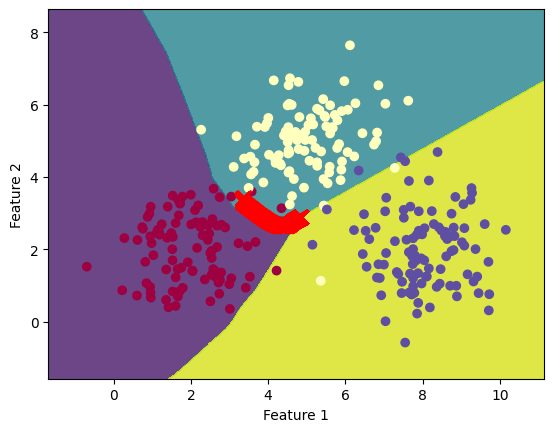

Sample 6 - Final Loss: 0.2369605302810669


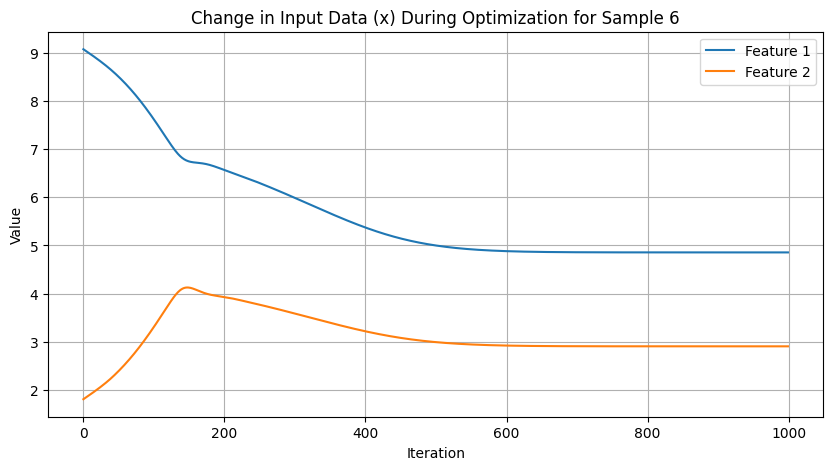

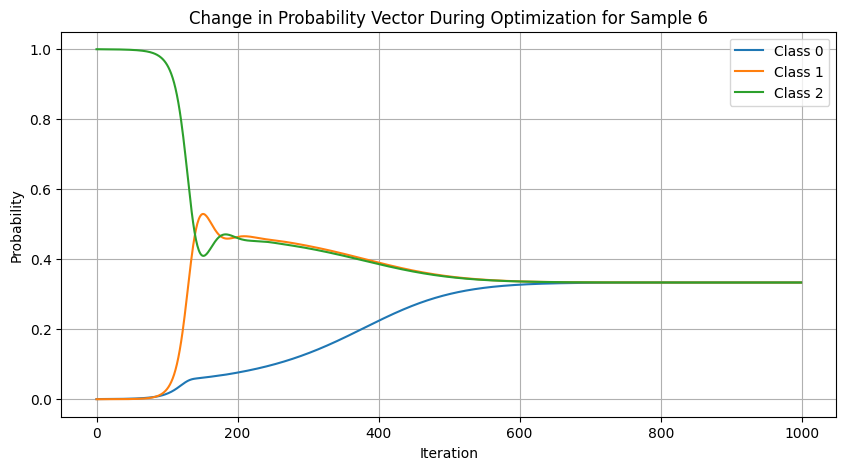

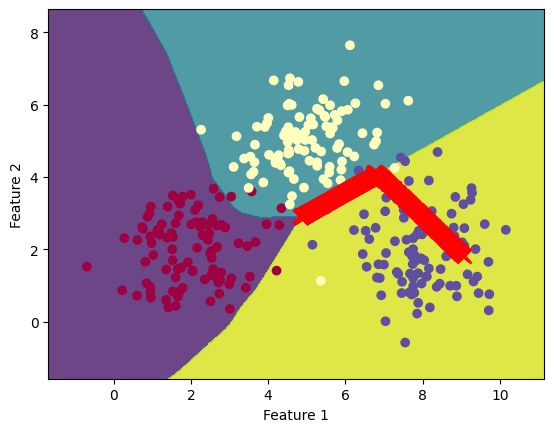

Sample 7 - Final Loss: 0.23696063458919525


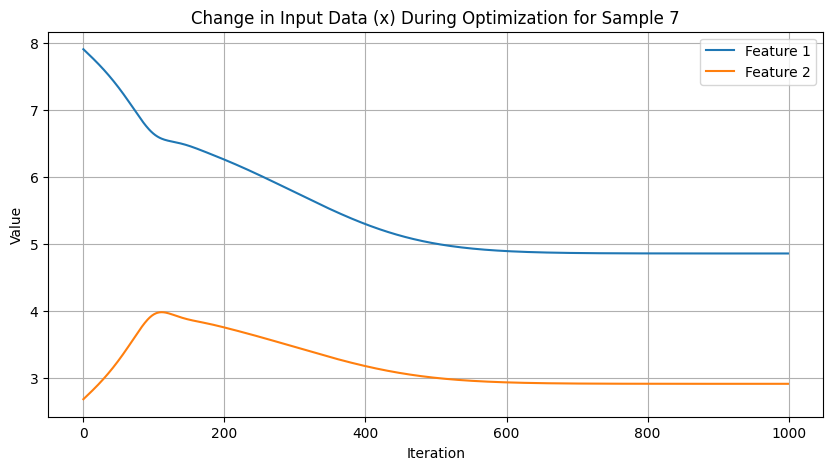

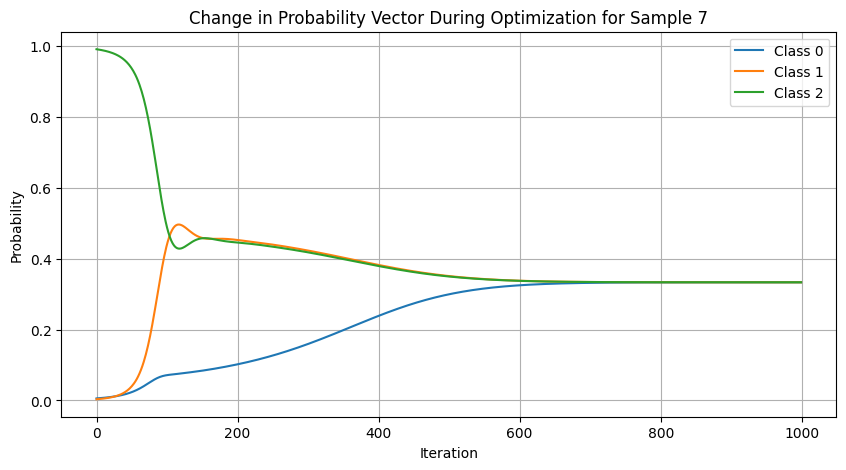

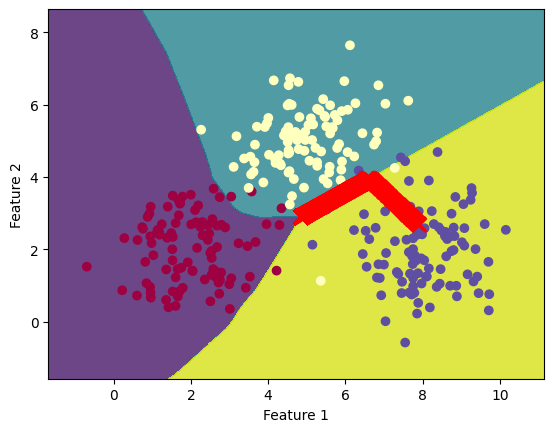

Sample 8 - Final Loss: 0.23696072399616241


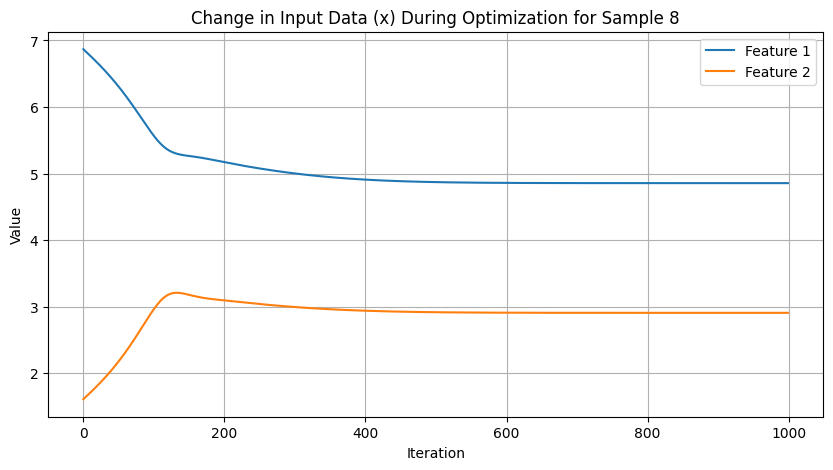

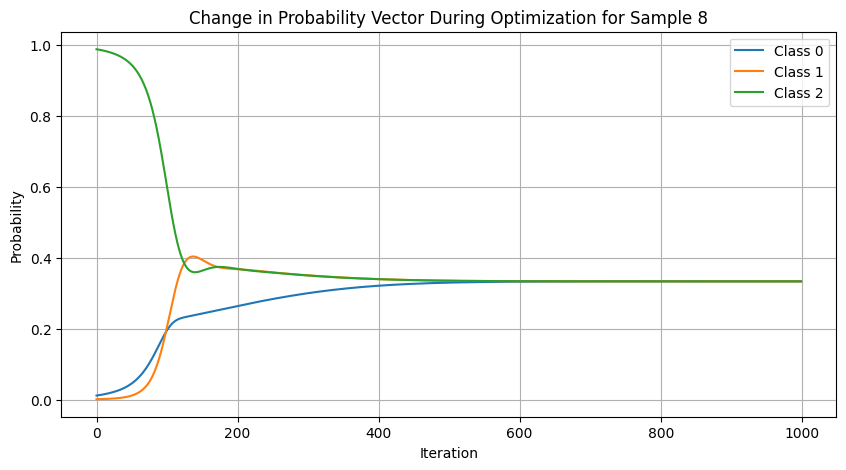

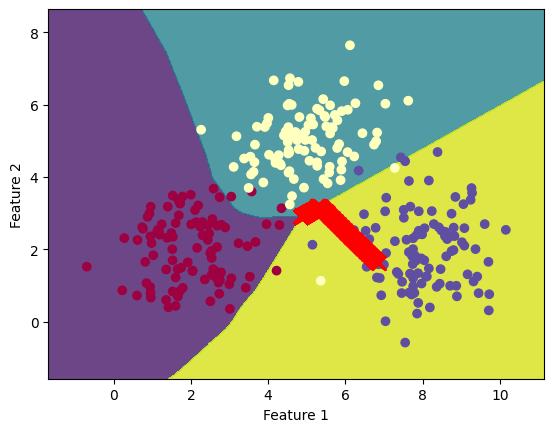

In [ ]:
# Create a list of data samples in the relevant range
data_samples, _ = generate_toy_data_3_classes(3, 3)
data_samples = torch.FloatTensor(data_samples)
target_l2 = 1 / 3

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_entropy(model, data_sample, num_iterations=1000)

    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()


    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x itself during optimization for the first sample
    sample_idx_to_visualize = result['Sample']  # Change this index to visualize a different sample
    x_history = np.array(results[sample_idx_to_visualize]['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the first sample
    prob_vector_history = np.array(results[sample_idx_to_visualize]['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    plot_decision_boundary_with_x_history(model, data, labels, results[sample_idx_to_visualize]['X History'])

## Orthogonal

In [ ]:
# def generate_adversarial_example_single_sample_orthogonal(model, data, target_l2, num_iterations=100, lr=0.01):
#     original_data = data.clone().detach().requires_grad_(True)  # Clone and set requires_grad=True
#     optimizer = optim.Adam([original_data], lr=lr)

#     x_history = []  # To store input data at each iteration
#     prob_vector_history = []  # To store probability vector at each iteration

#     output = model(original_data.unsqueeze(0))
#     pred = output.softmax(dim=-1)
#     pred_c = torch.unsqueeze(torch.argmax(pred, 1), -1)

#     threshold = 0.01  # Define a threshold for blending

#     for iteration in range(num_iterations):
#         optimizer.zero_grad()
#         outputs = model(original_data.unsqueeze(0))
#         outputs_probs = outputs.softmax(dim=-1)
#         probs = torch.gather(outputs_probs, 1, pred_c)
#         error = torch.norm(probs - target_l2, p=1)
#         l2_loss = torch.sum(error)
#         l2_loss.backward(retain_graph=True)  # retain graph to reuse computation

#         # Capture the gradient direction
#         grad_direction = original_data.grad.clone()
#         grad_magnitude = torch.norm(grad_direction)

#         # Compute the orthogonal direction for 2D data
#         ortho = torch.tensor([-grad_direction[1], grad_direction[0]])

#         # Interpolate based on the magnitude of the loss
#         alpha = torch.sigmoid(grad_magnitude)
#         if (alpha > threshold):
#           alpha = 1
#         else:
#           print(alpha)
#         interpolated_direction = alpha * grad_direction + (1 - alpha) * ortho
#         print(interpolated_direction)
#         # Apply the interpolated update
#         with torch.no_grad():
#             original_data -= lr * interpolated_direction
#             original_data.requires_grad_(True)

#         # Record histories
#         x_history.append(original_data.clone().detach().numpy())
#         prob_vector_history.append(outputs[0].softmax(dim=0).detach().numpy())

#     original_data.requires_grad = False  # Disable gradient computation for input data
#     return original_data, x_history, prob_vector_history


In [ ]:
def generate_adversarial_example_interpolated(model, data, target_l2, num_iterations=100, lr=0.02, threshold=0.002):
    original_data = data.clone().detach().requires_grad_(True)
    optimizer = optim.Adam([original_data], lr=lr)

    x_history = []  # To store input data at each iteration
    prob_vector_history = []  # To store probability vector at each iteration

    output = model(original_data.unsqueeze(0))
    pred = output.softmax(dim=-1)
    pred_c = torch.unsqueeze(torch.argmax(pred, 1), -1)

    for iteration in range(num_iterations):
        optimizer.zero_grad()
        outputs = model(original_data.unsqueeze(0))
        output_probs = outputs.softmax(dim=-1)
        probs = torch.gather(output_probs, 1, pred_c)
        error = torch.norm(probs - target_l2, p=1)
        l2_loss = torch.sum(error)
        l2_loss.backward()

        # Interpolated gradient update
        grad_direction = original_data.grad.clone()
        ortho = torch.tensor([-grad_direction[1], grad_direction[0]])
        # alpha = torch.sigmoid(l2_loss).item()
        alpha = l2_loss
        if alpha > threshold:
            alpha = 1


        interpolated_gradient = alpha * grad_direction + (1 - alpha) * ortho
        original_data.grad = interpolated_gradient

        optimizer.step()

        x_history.append(original_data.clone().detach().numpy())
        prob_vector_history.append(outputs[0].softmax(dim=0).detach().numpy())

        grad_magnitude = torch.norm(grad_direction)
        # print(grad_magnitude)

    original_data.requires_grad = False
    return original_data, x_history, prob_vector_history


<class 'numpy.ndarray'>
<class 'list'>
[[1.52268721 1.96089236]
 [3.64122773 3.28960101]
 [3.08506342 1.16911217]
 [2.78626149 4.32416623]
 [4.26817098 3.44989397]
 [4.0950059  6.94925789]
 [7.95788754 2.16847615]
 [8.37176812 2.43695611]
 [7.99998796 1.7145892 ]]
#######################################
#######################################
#######################################
#######################################
#######################################
#######################################
#######################################
#######################################
#######################################
Sample 0 - Final Loss: 0.35117781162261963


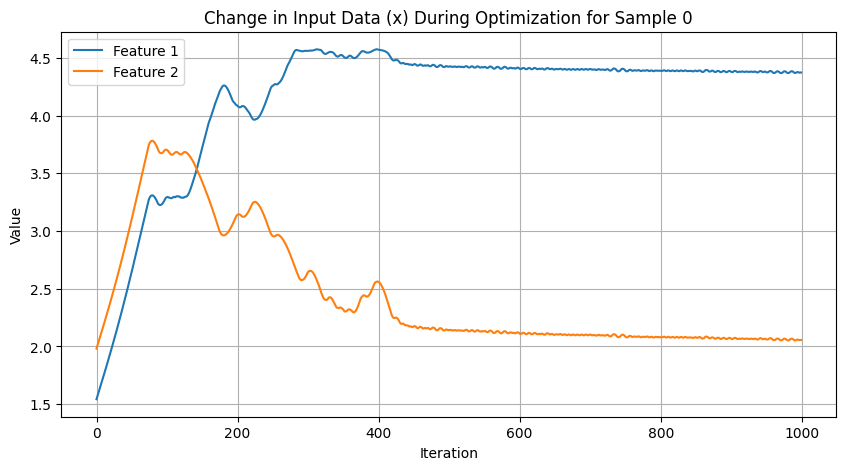

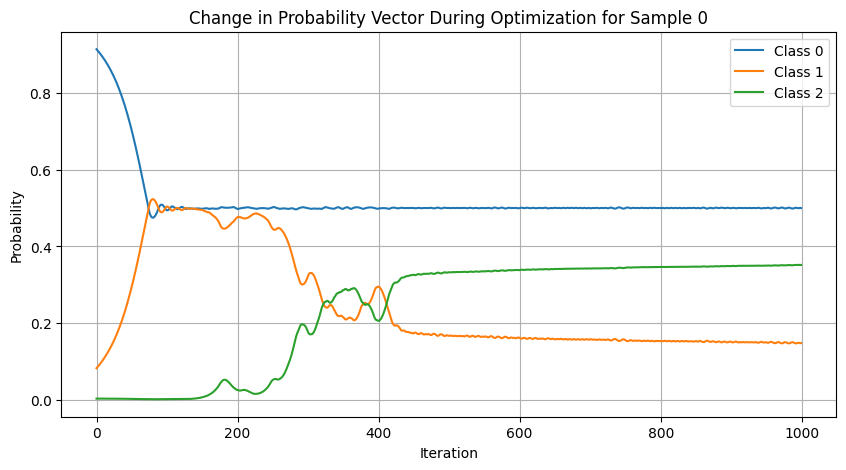

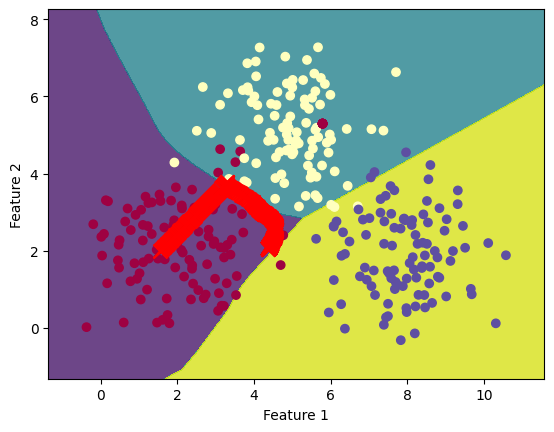

Sample 1 - Final Loss: 1.408644199371338


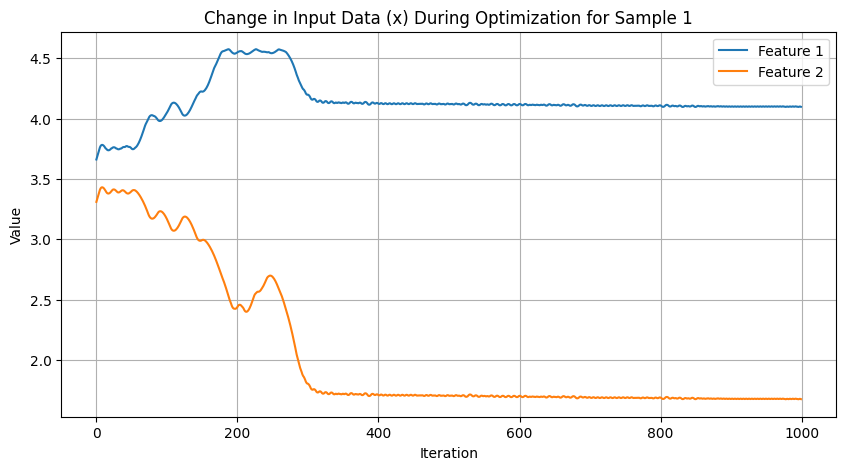

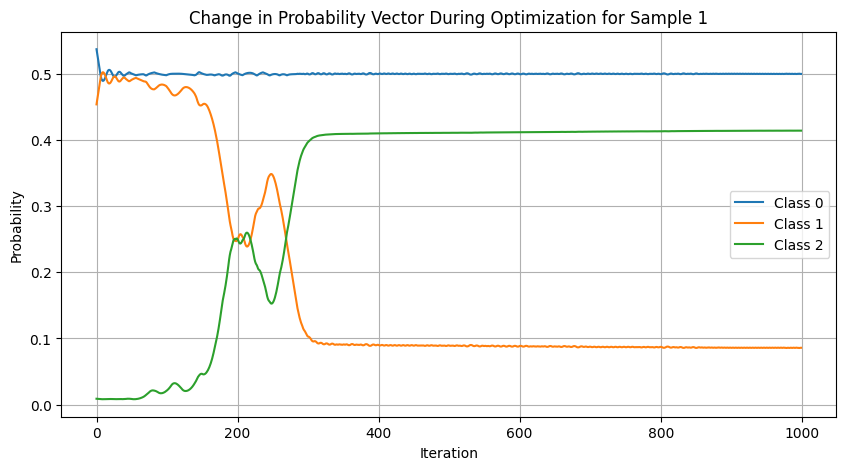

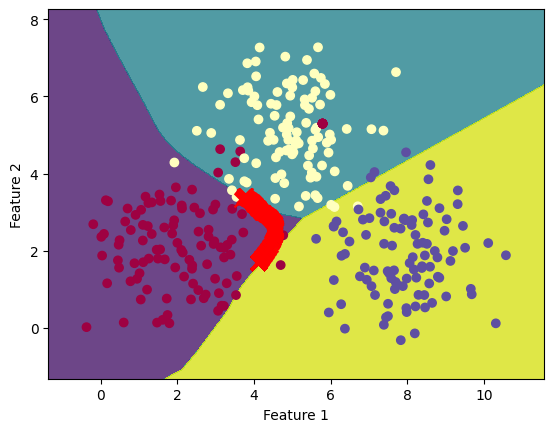

Sample 2 - Final Loss: 8.029740333557129


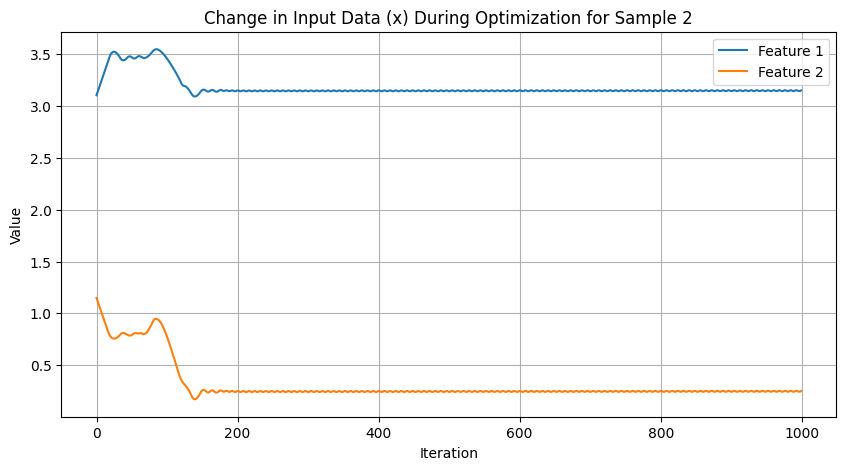

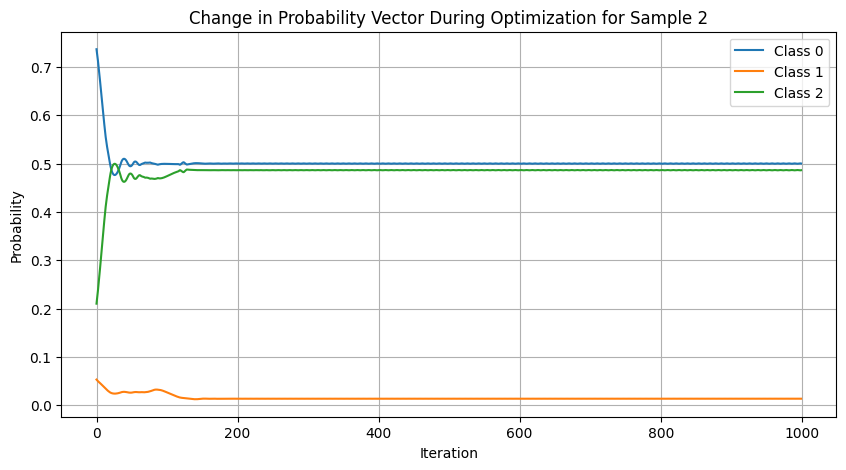

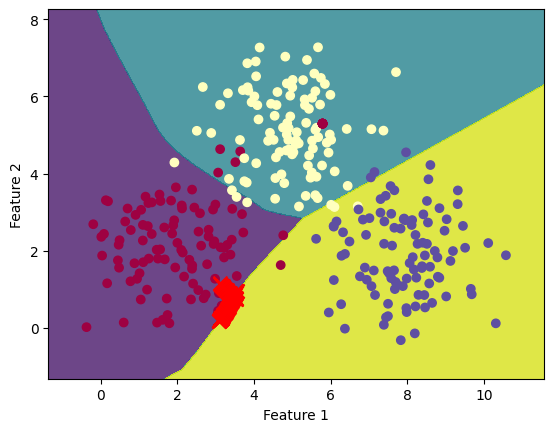

Sample 3 - Final Loss: 31.393375396728516


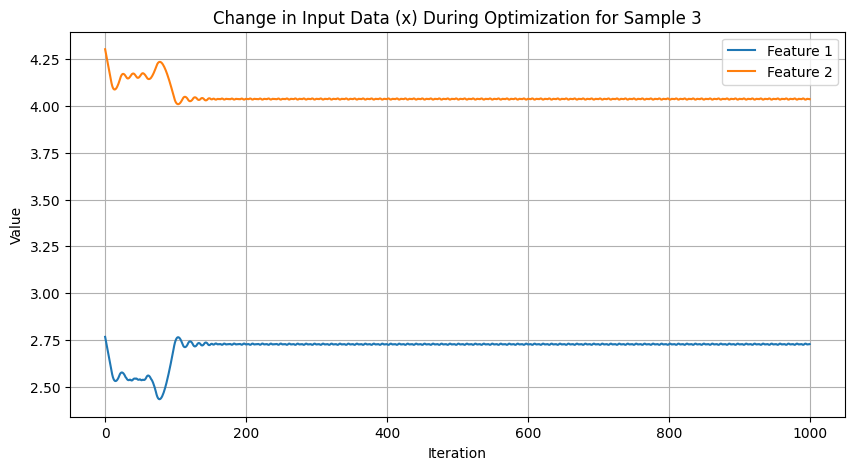

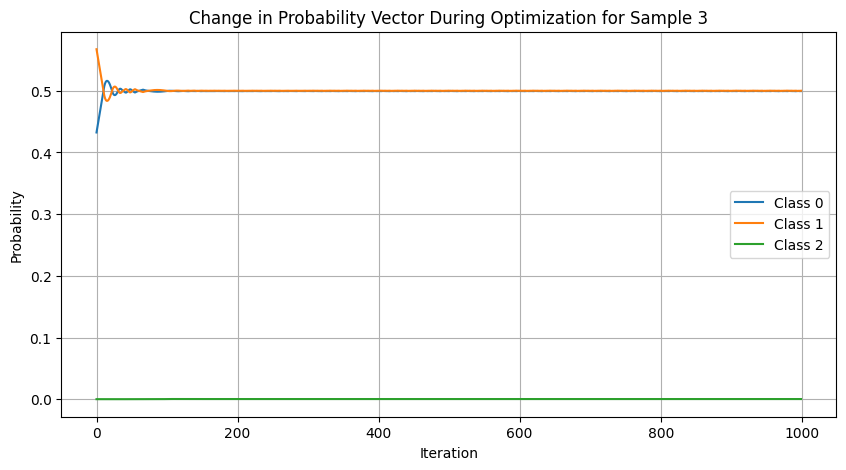

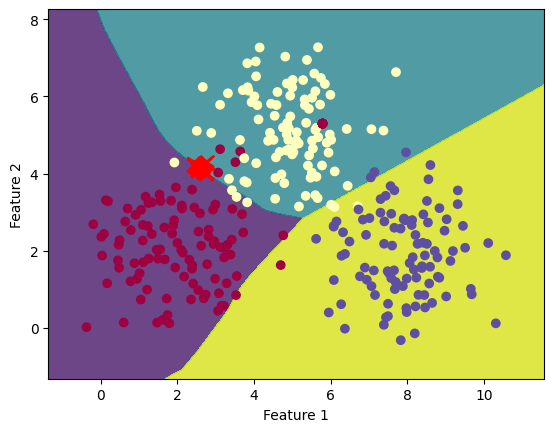

Sample 4 - Final Loss: 6.581169128417969


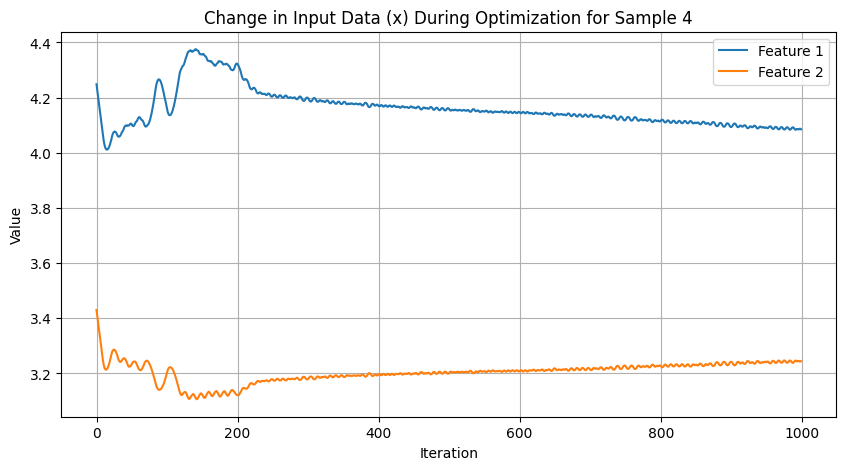

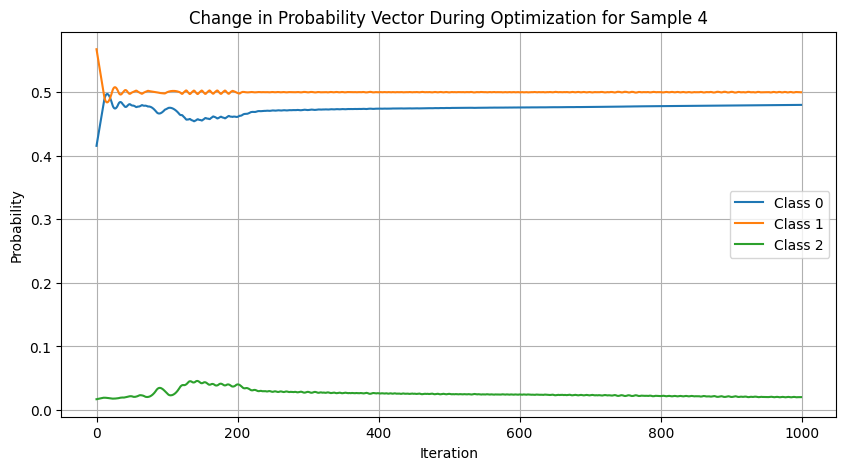

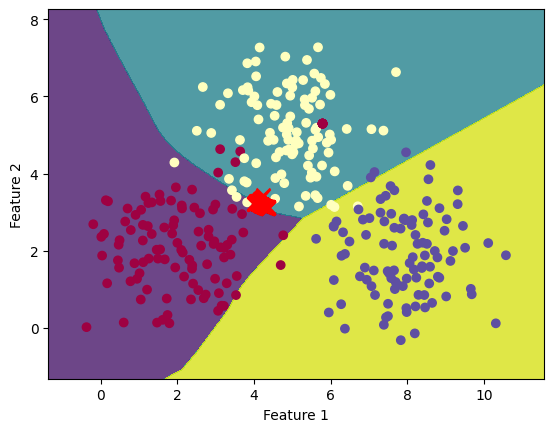

Sample 5 - Final Loss: 232.4815216064453


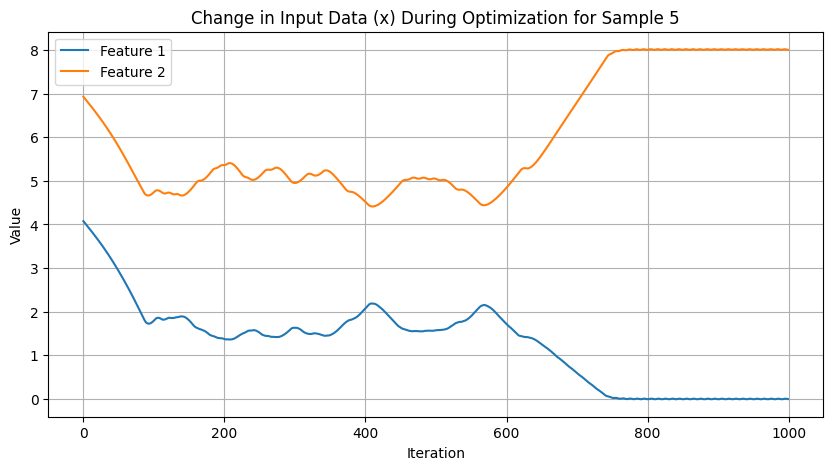

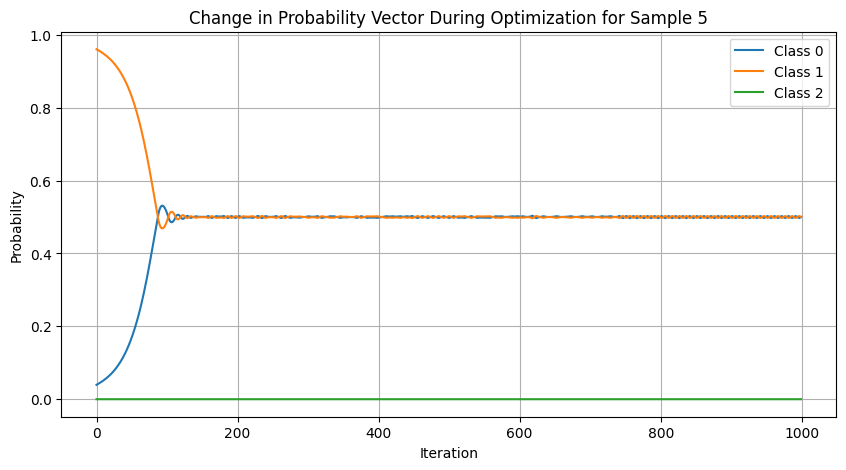

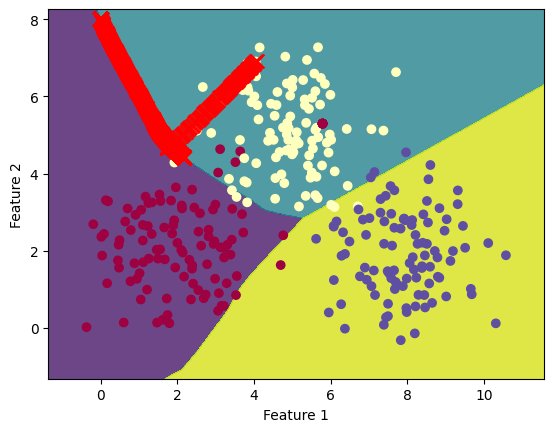

Sample 6 - Final Loss: 0.7151486873626709


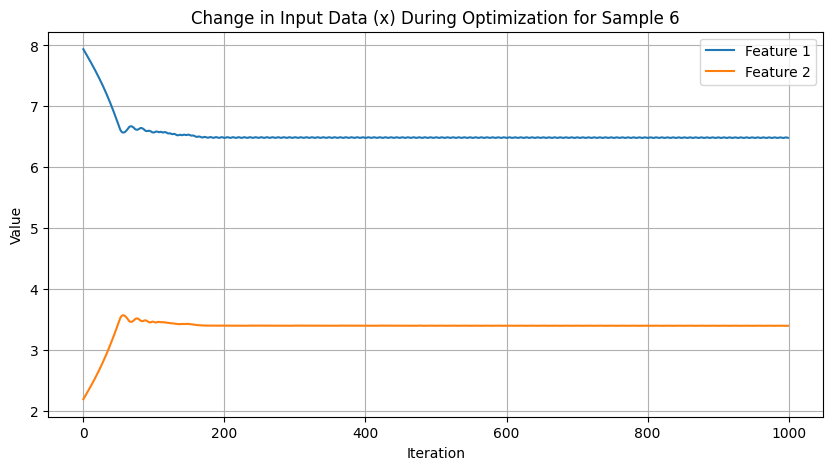

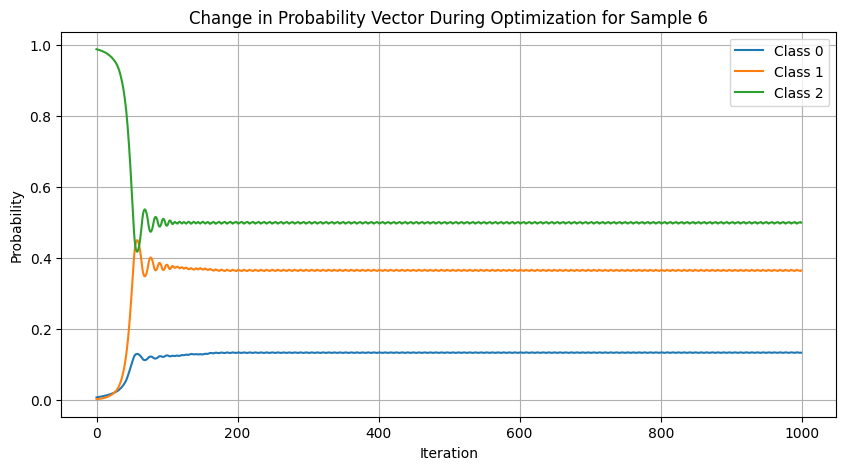

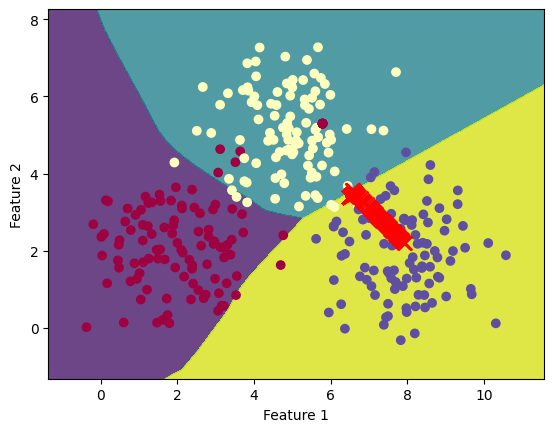

Sample 7 - Final Loss: 11.792948722839355


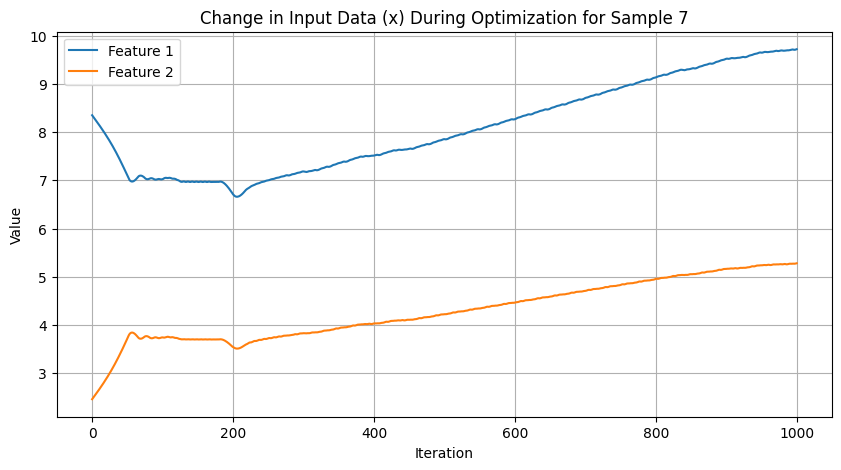

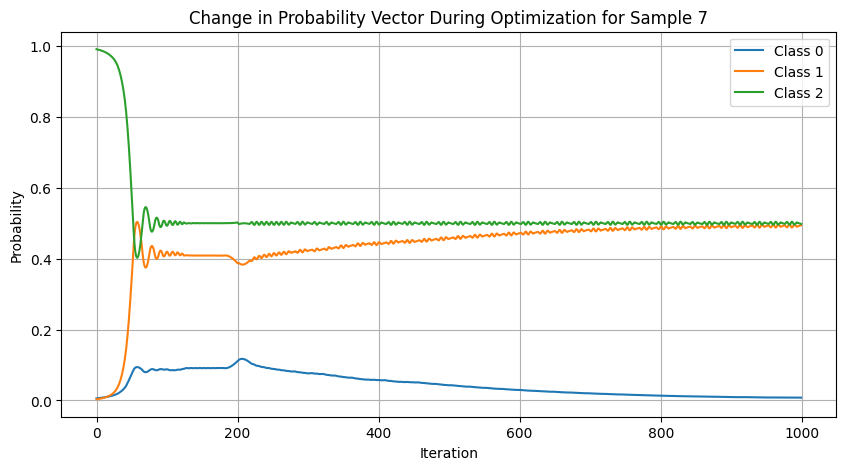

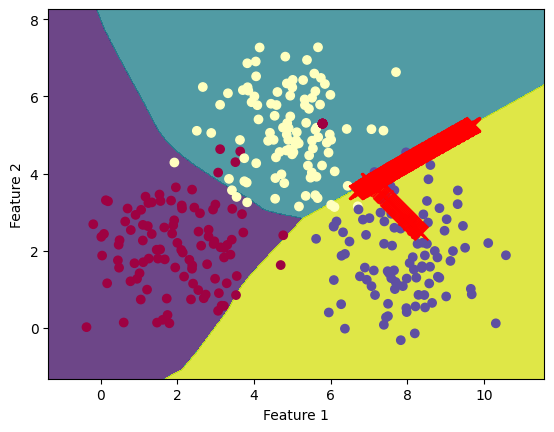

Sample 8 - Final Loss: 3.995242118835449


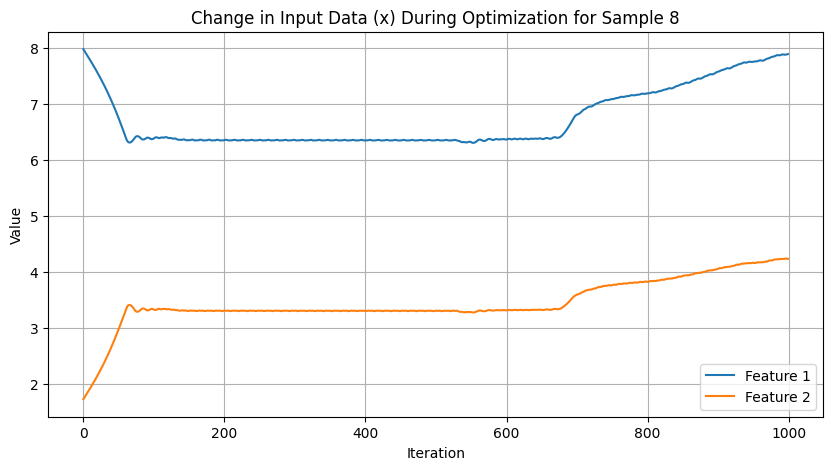

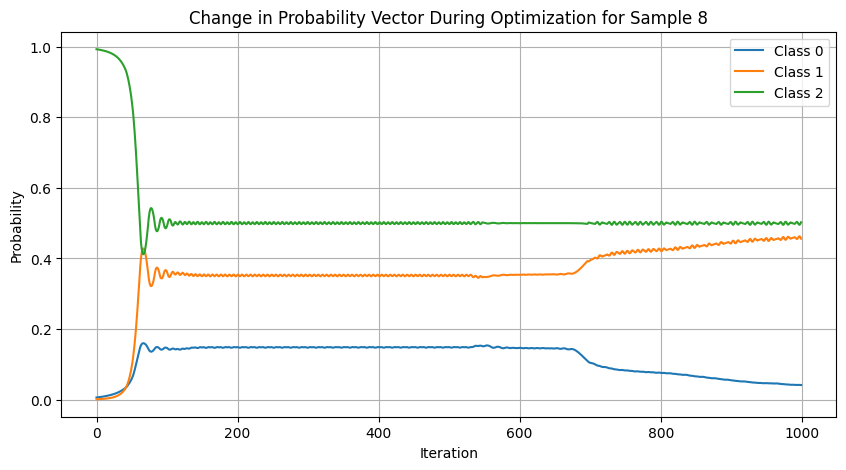

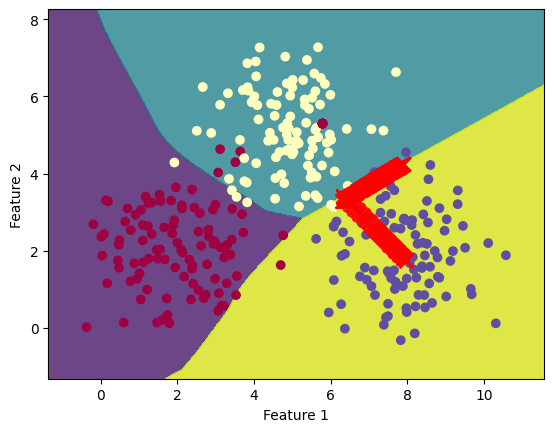

In [ ]:
# Test data samples
data_samples, _ =  generate_toy_data(3, 3)
print(data_samples)
data_samples = torch.FloatTensor(data_samples)
target_l2 = 1 / 2

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_interpolated(model, data_sample, target_l2, num_iterations=1000)
    print("#######################################")
    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()

    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print & Visualize the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x during optimization for the sample
    x_history = np.array(result['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {result["Sample"]}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the sample
    prob_vector_history = np.array(result['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {result["Sample"]}')
    plt.grid()
    plt.legend()
    plt.show()

    # Add your plot_decision_boundary_with_x_history function call here
    plot_decision_boundary_with_x_history(model, data, labels, result['X History'])


<class 'numpy.ndarray'>
<class 'list'>
[[2.42754529 1.99117673]
 [2.23796292 3.31381417]
 [2.08839243 2.0433736 ]
 [5.42755167 6.56710516]
 [4.88101248 6.06983927]
 [5.97977883 4.94258383]
 [6.75988065 2.78810742]
 [6.52237519 1.58043004]
 [7.00492374 3.2184948 ]]
#######################################
#######################################
#######################################
#######################################
#######################################
#######################################
#######################################
#######################################
#######################################
Sample 0 - Final Loss: 57.08480453491211


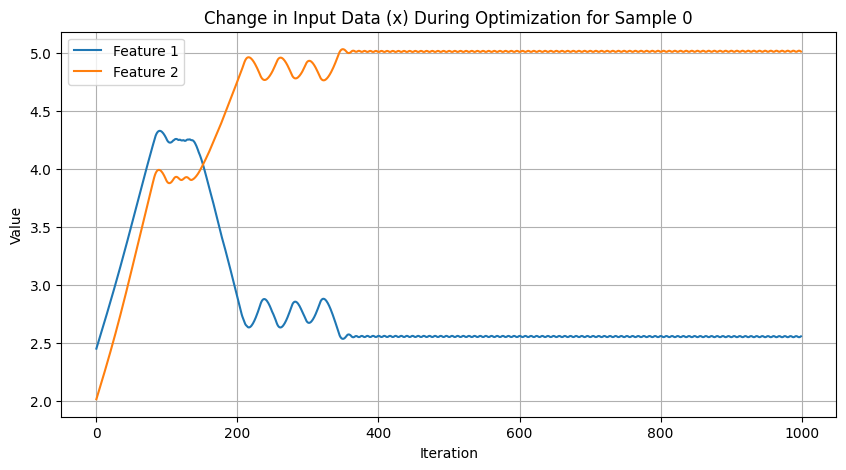

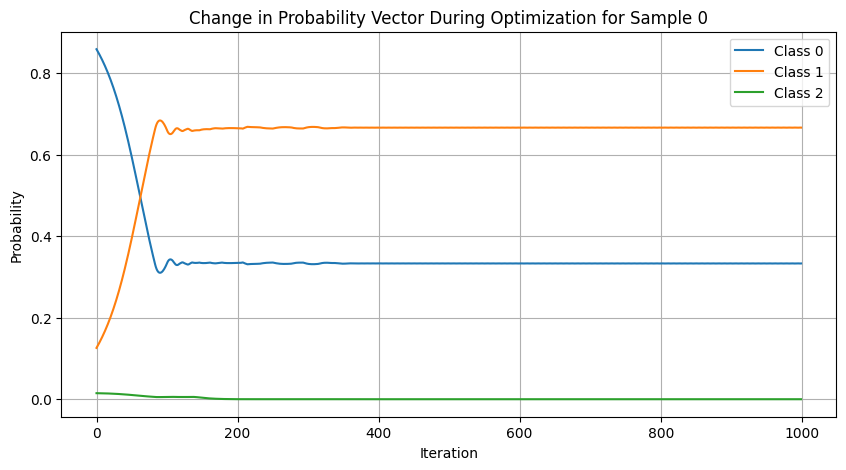

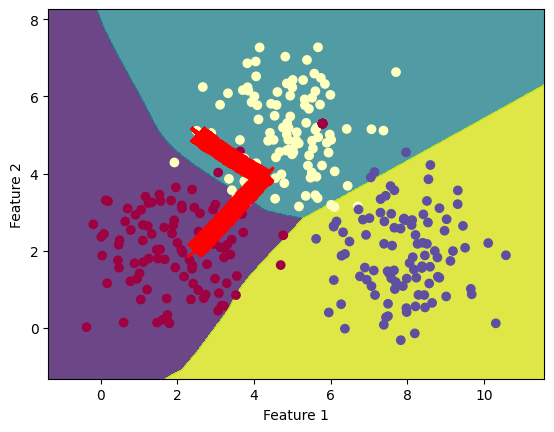

Sample 1 - Final Loss: 16.980066299438477


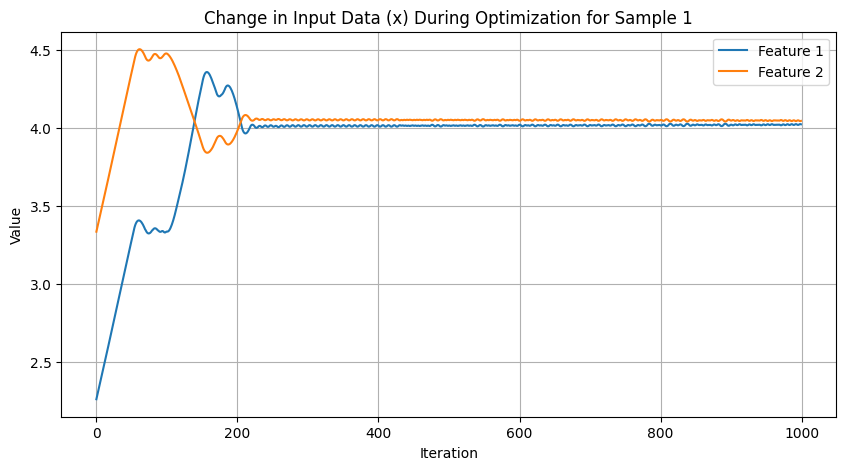

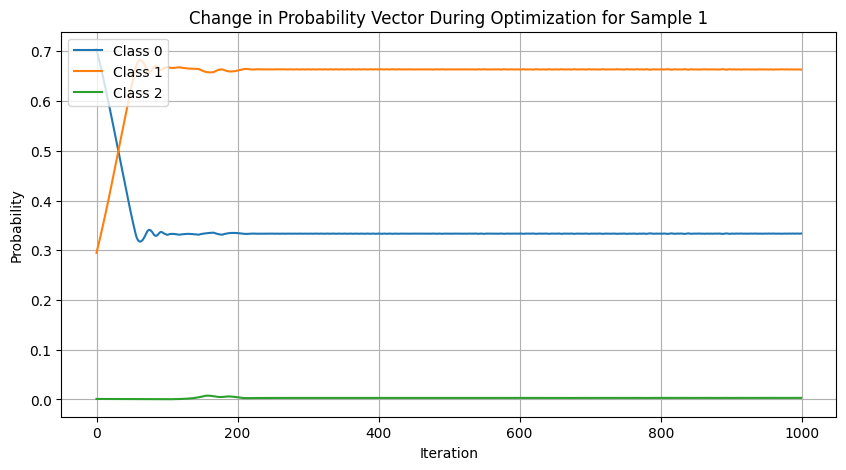

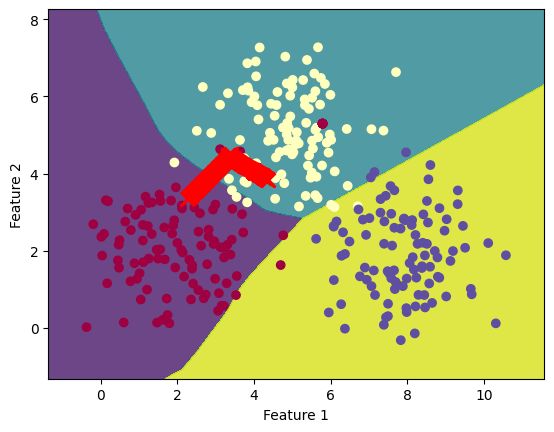

Sample 2 - Final Loss: 117.14637756347656


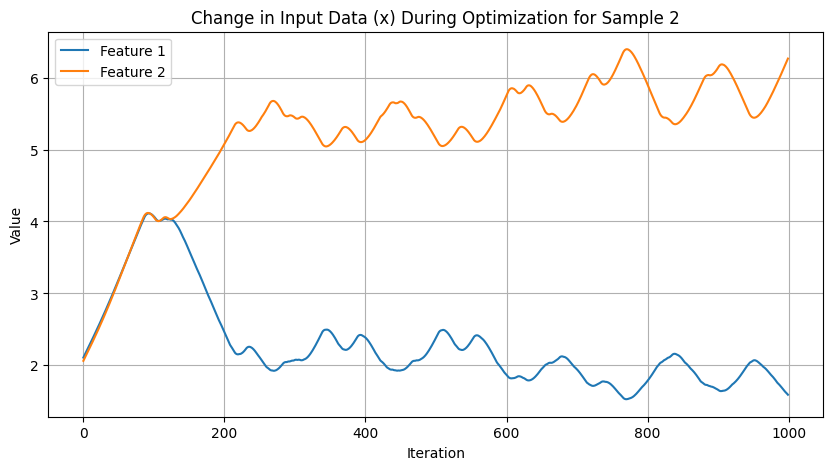

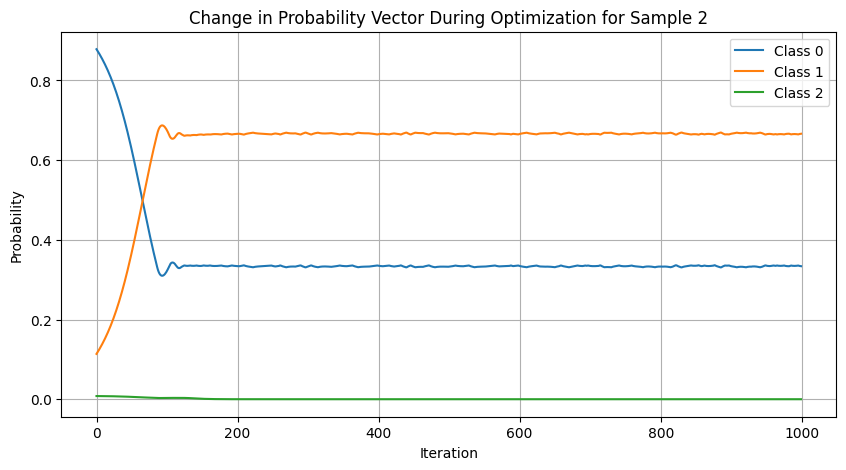

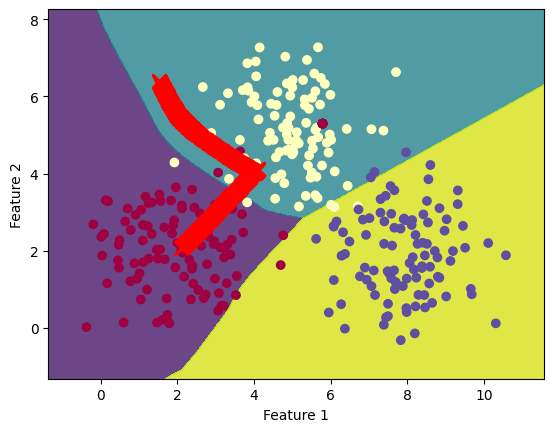

Sample 3 - Final Loss: 66.39661407470703


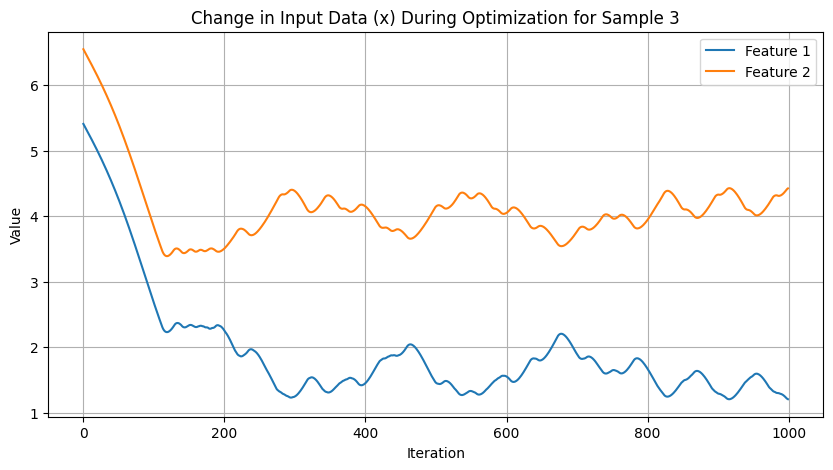

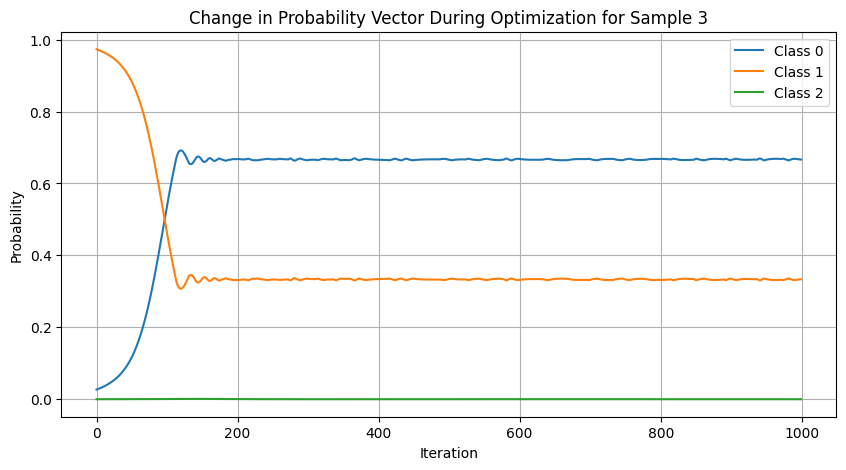

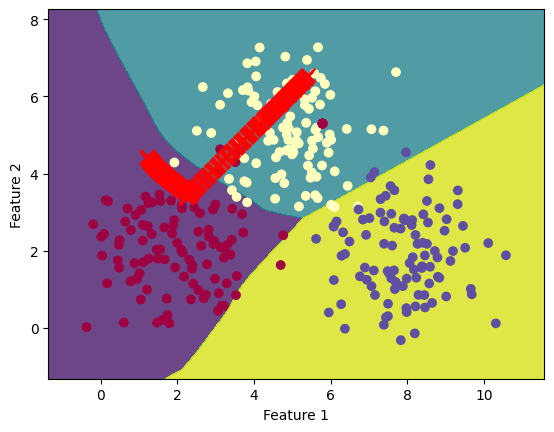

Sample 4 - Final Loss: 29.02039909362793


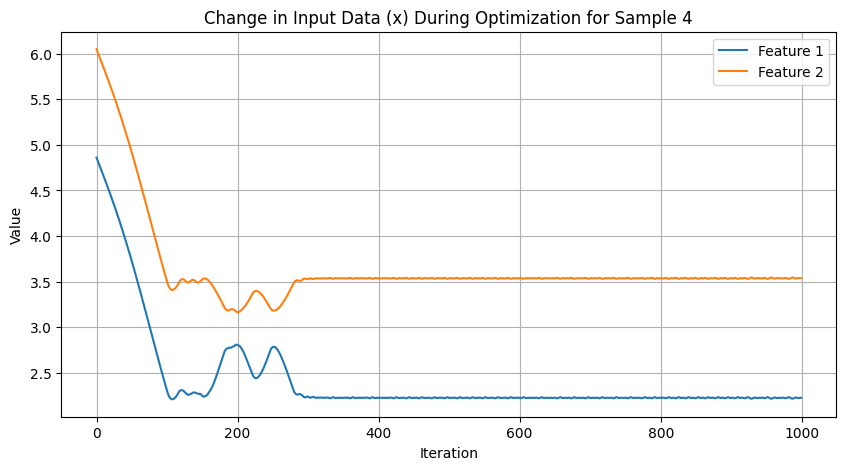

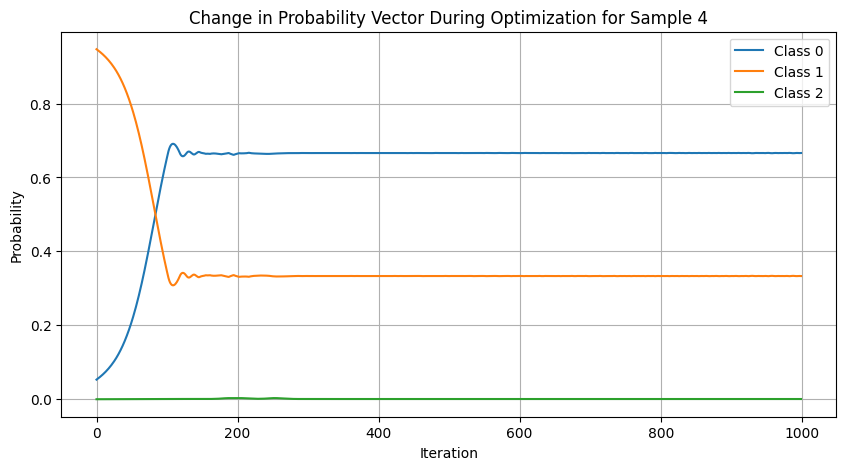

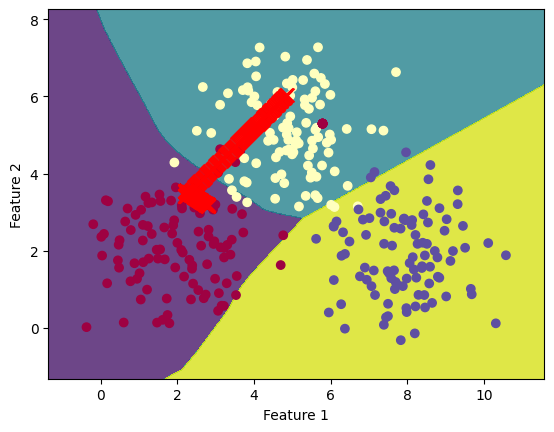

Sample 5 - Final Loss: 7.779037952423096


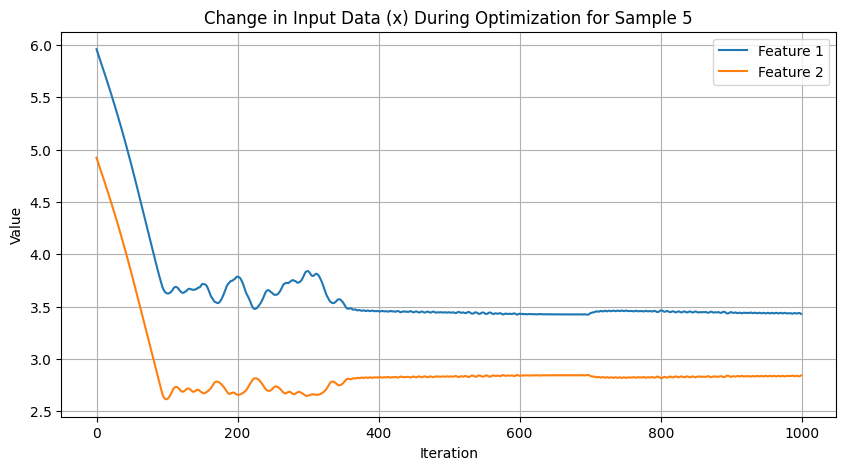

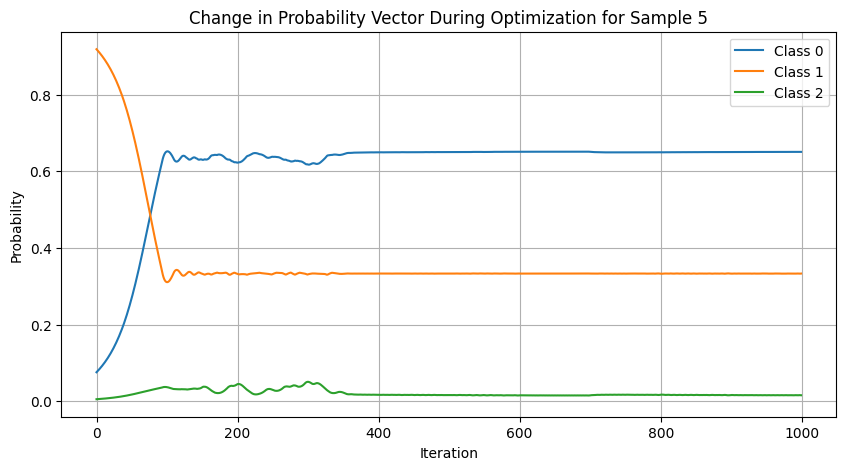

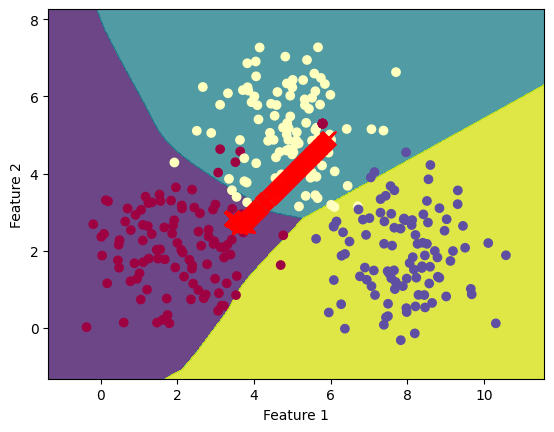

Sample 6 - Final Loss: 0.046987682580947876


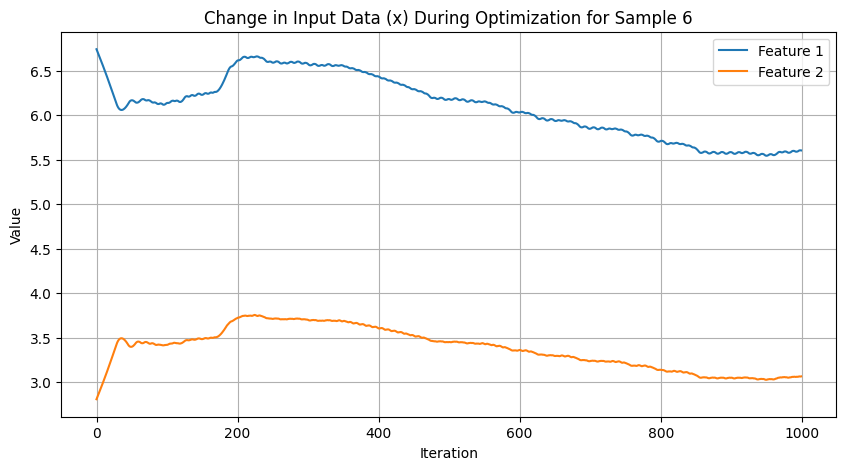

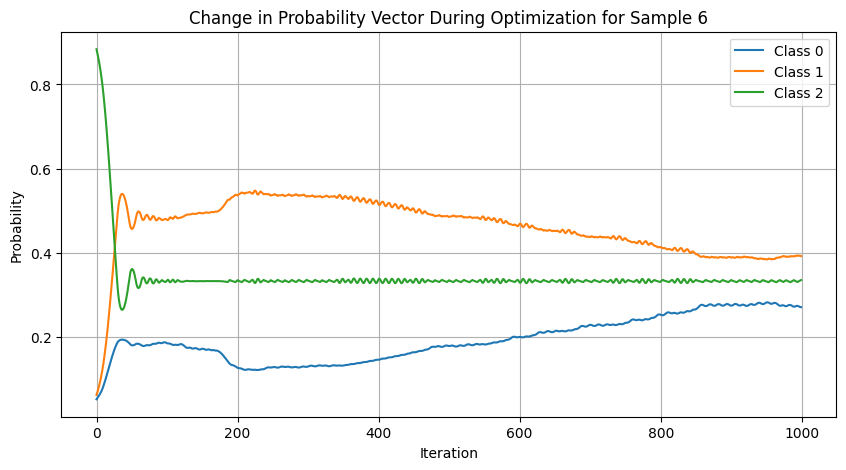

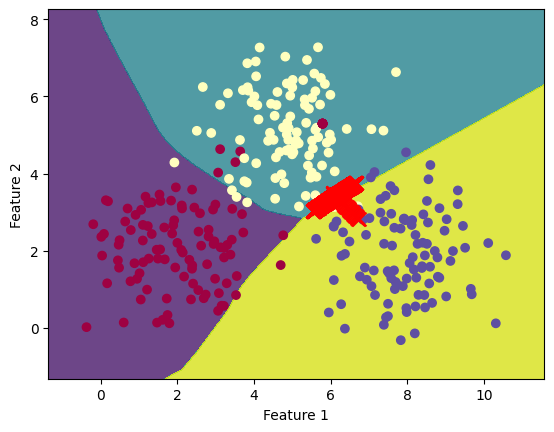

Sample 7 - Final Loss: 0.16225665807724


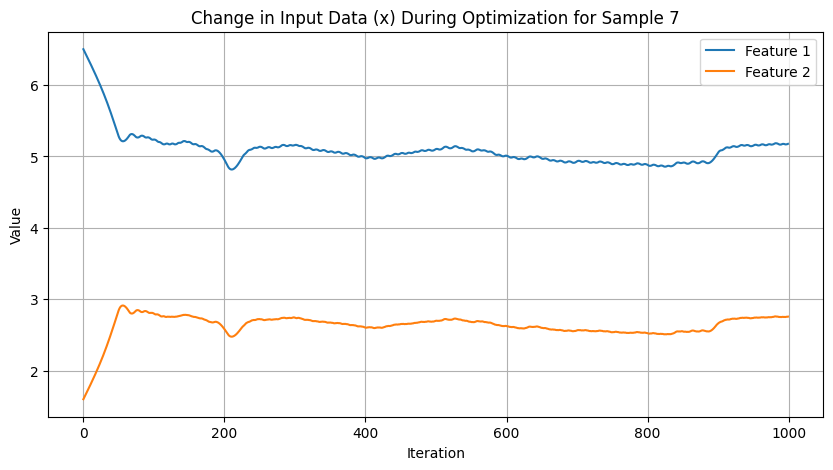

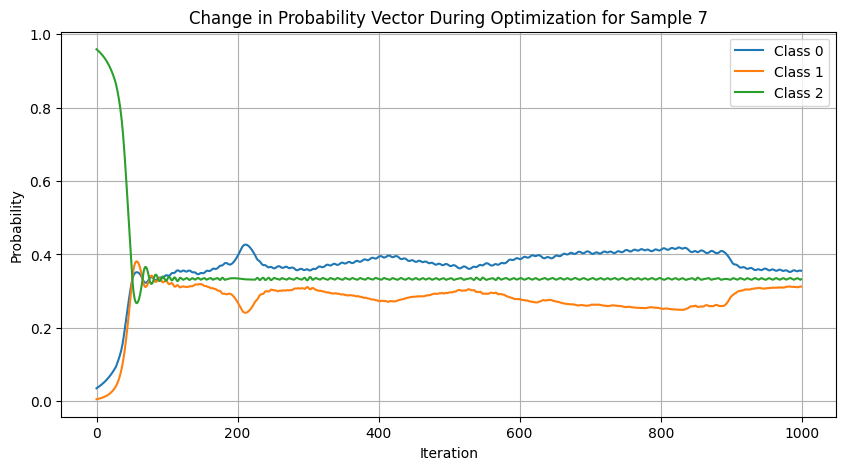

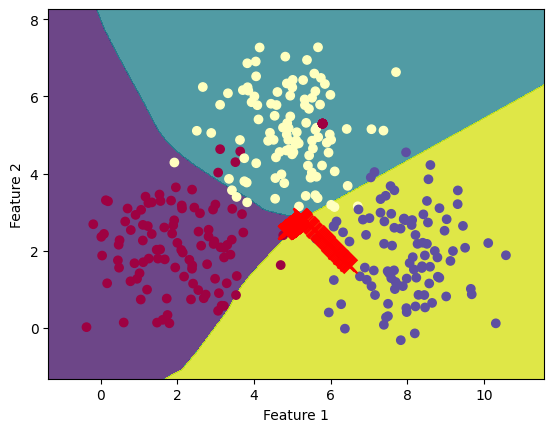

Sample 8 - Final Loss: 0.4881191551685333


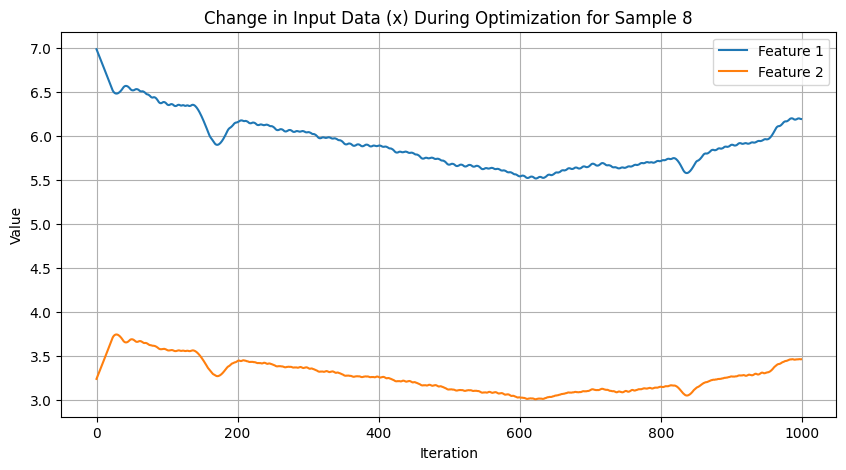

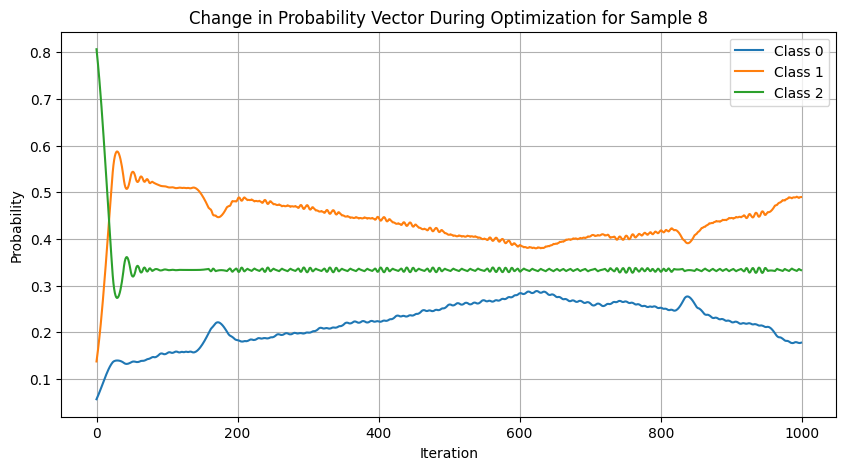

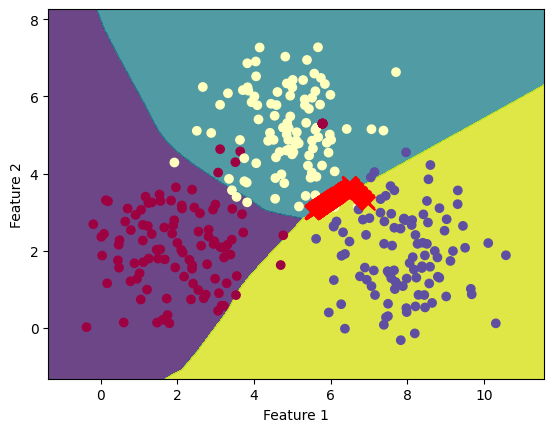

In [ ]:
# Test data samples
data_samples, _ =  generate_toy_data(3, 3)
print(data_samples)
data_samples = torch.FloatTensor(data_samples)
target_l2 = 1 / 3

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_interpolated(model, data_sample, target_l2, num_iterations=1000)
    print("#######################################")
    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()

    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print & Visualize the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x during optimization for the sample
    x_history = np.array(result['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {result["Sample"]}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the sample
    prob_vector_history = np.array(result['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {result["Sample"]}')
    plt.grid()
    plt.legend()
    plt.show()

    # Add your plot_decision_boundary_with_x_history function call here
    plot_decision_boundary_with_x_history(model, data, labels, result['X History'])


## Old loss function

<class 'numpy.ndarray'>
<class 'list'>
tensor([0.7625], grad_fn=<SumBackward1>)
tensor([0.7591], grad_fn=<SumBackward1>)
tensor([0.7558], grad_fn=<SumBackward1>)
tensor([0.7524], grad_fn=<SumBackward1>)
tensor([0.7491], grad_fn=<SumBackward1>)
tensor([0.7456], grad_fn=<SumBackward1>)
tensor([0.7422], grad_fn=<SumBackward1>)
tensor([0.7387], grad_fn=<SumBackward1>)
tensor([0.7352], grad_fn=<SumBackward1>)
tensor([0.7317], grad_fn=<SumBackward1>)
tensor([0.7282], grad_fn=<SumBackward1>)
tensor([0.7246], grad_fn=<SumBackward1>)
tensor([0.7210], grad_fn=<SumBackward1>)
tensor([0.7174], grad_fn=<SumBackward1>)
tensor([0.7138], grad_fn=<SumBackward1>)
tensor([0.7102], grad_fn=<SumBackward1>)
tensor([0.7065], grad_fn=<SumBackward1>)
tensor([0.7028], grad_fn=<SumBackward1>)
tensor([0.6991], grad_fn=<SumBackward1>)
tensor([0.6954], grad_fn=<SumBackward1>)
tensor([0.6917], grad_fn=<SumBackward1>)
tensor([0.6879], grad_fn=<SumBackward1>)
tensor([0.6841], grad_fn=<SumBackward1>)
tensor([0.6804], g

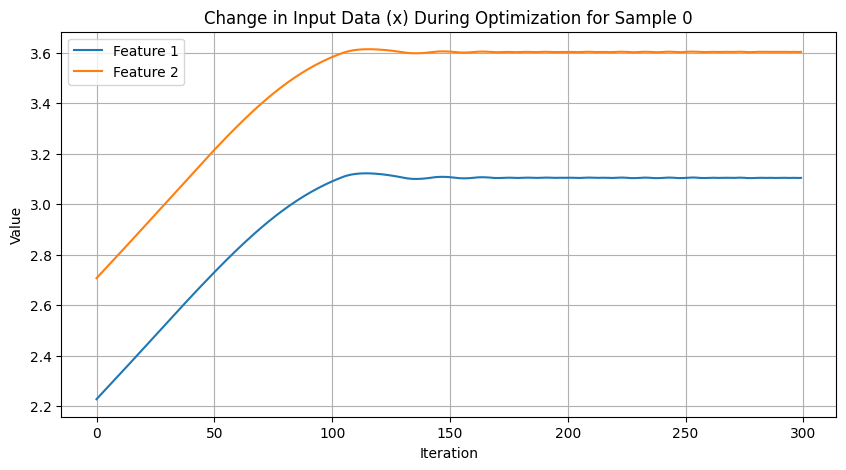

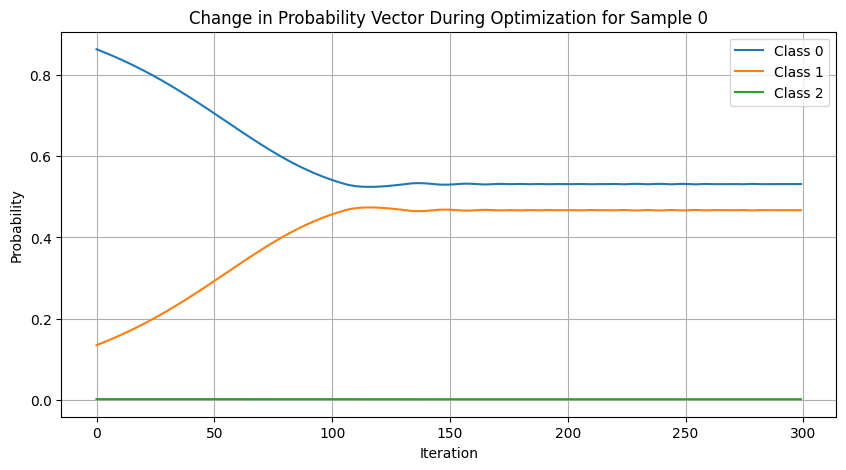

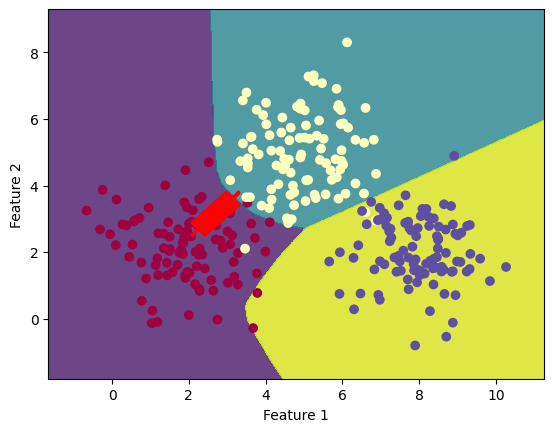

Sample 1 - Final Loss: 14.658967971801758


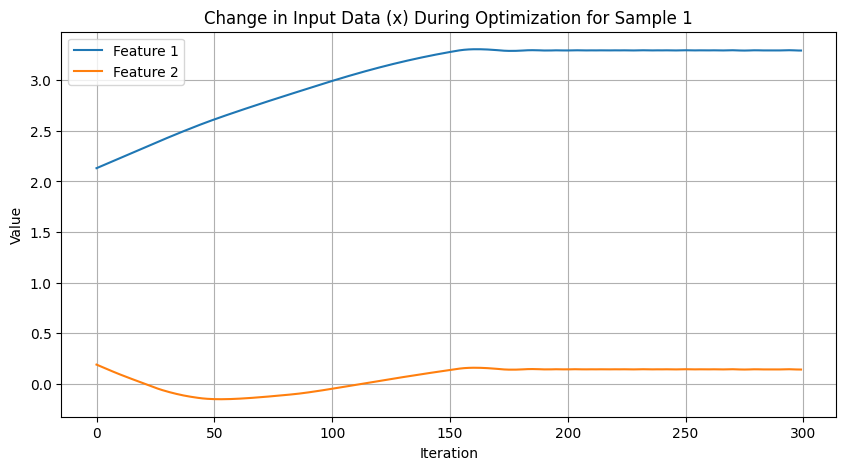

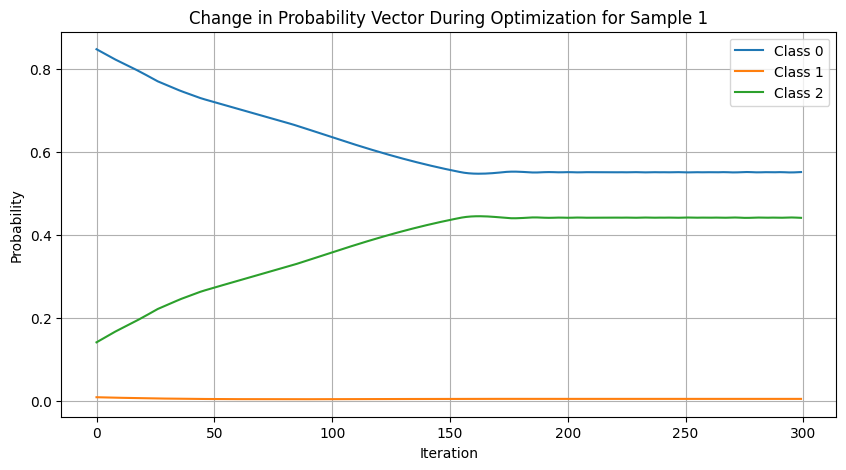

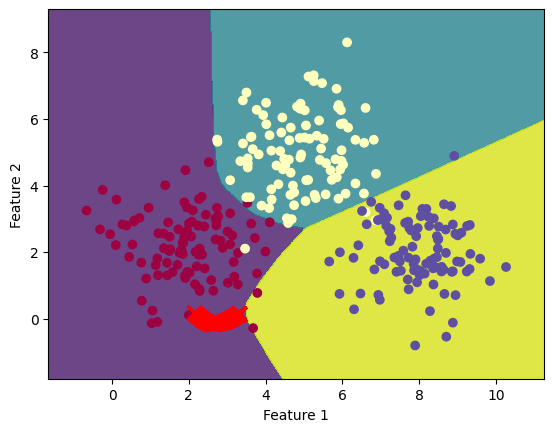

Sample 2 - Final Loss: 15.621088027954102


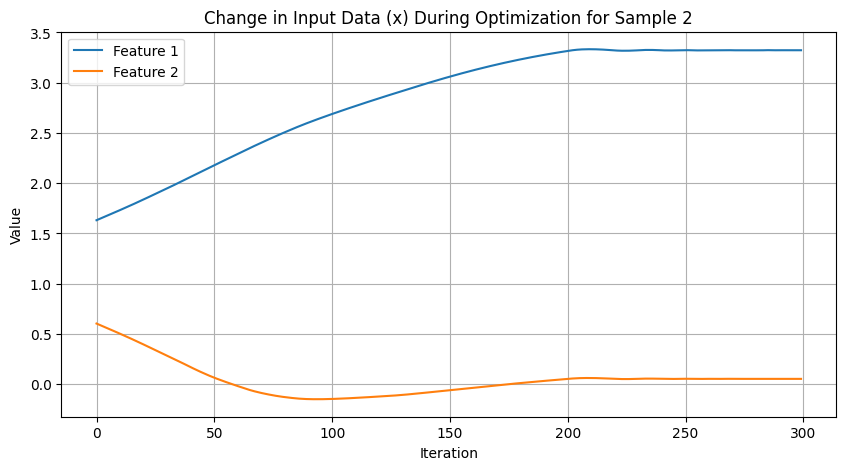

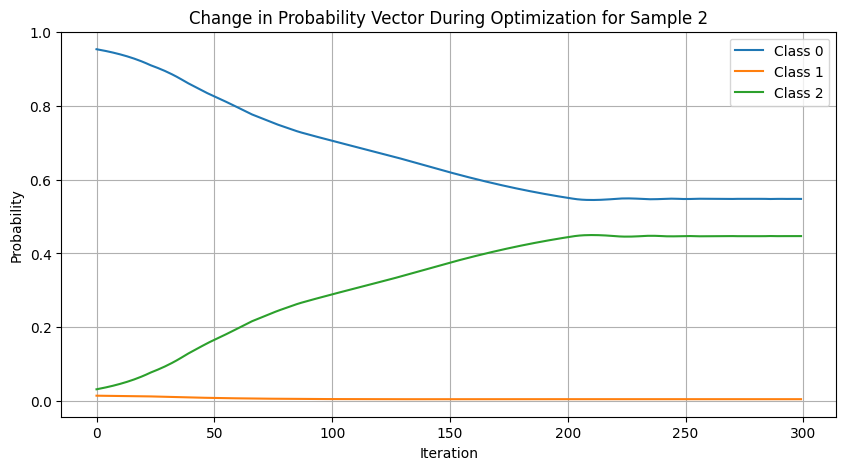

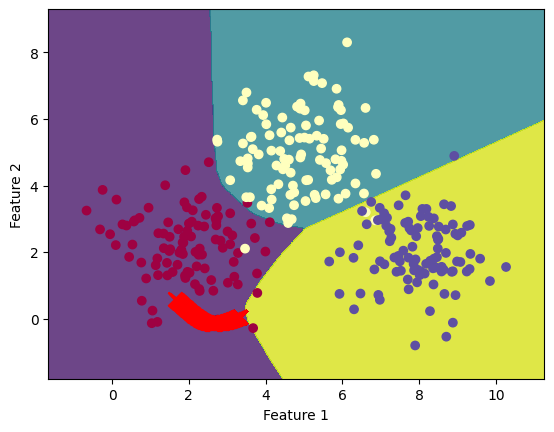

Sample 3 - Final Loss: 57.249061584472656


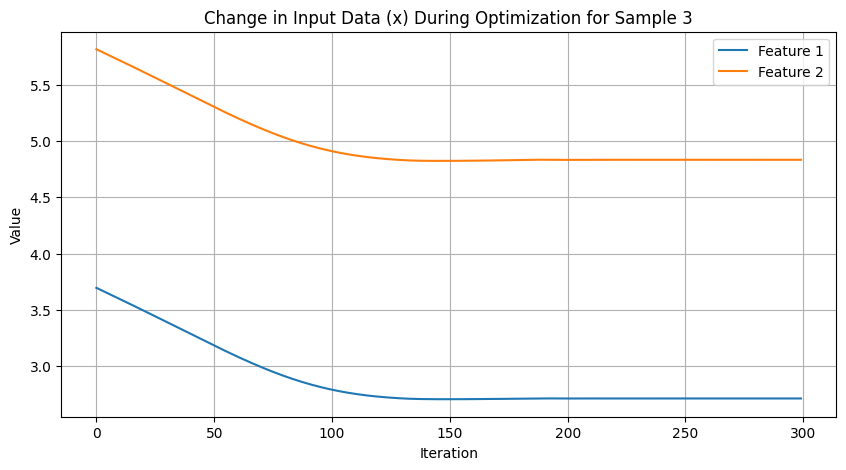

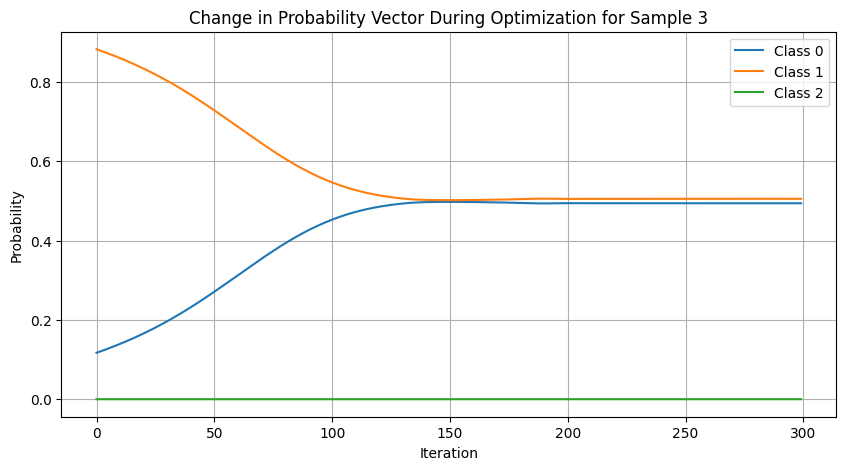

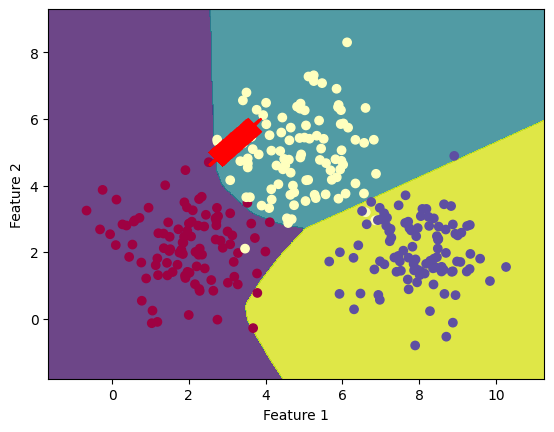

Sample 4 - Final Loss: 15.132551193237305


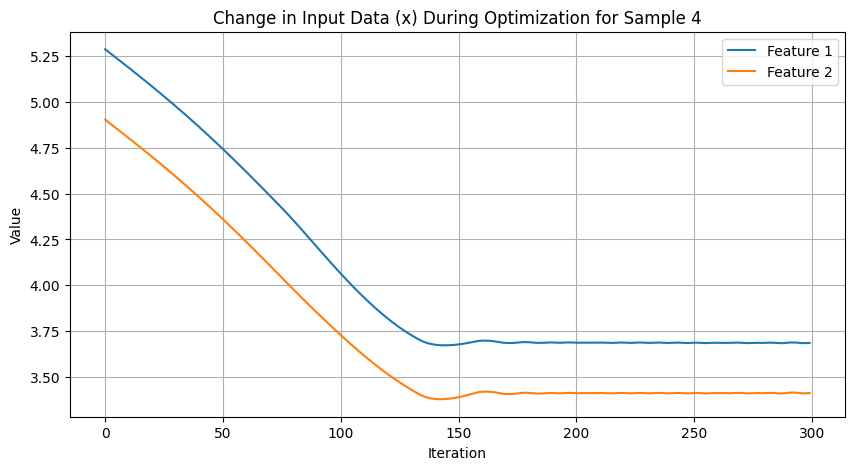

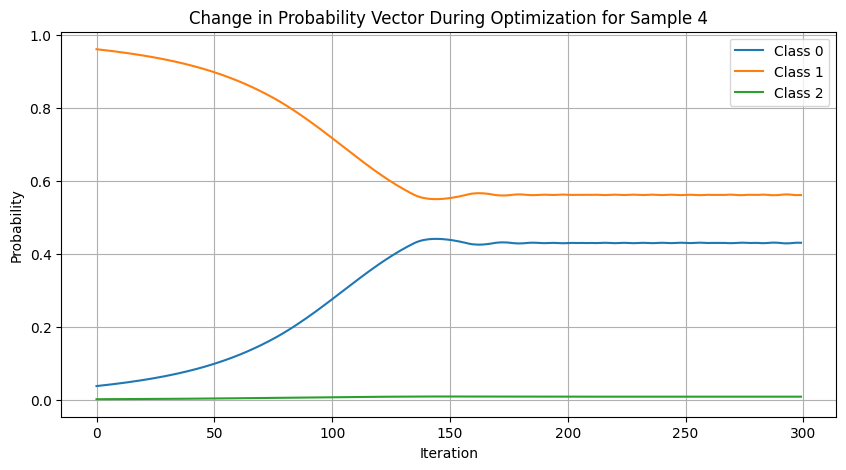

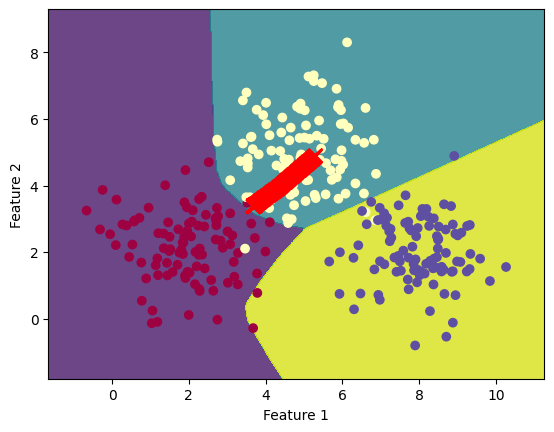

Sample 5 - Final Loss: 9.952091217041016


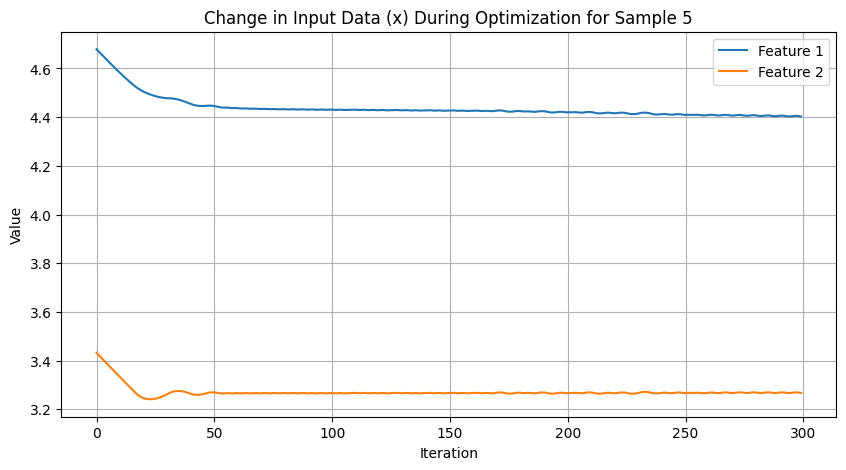

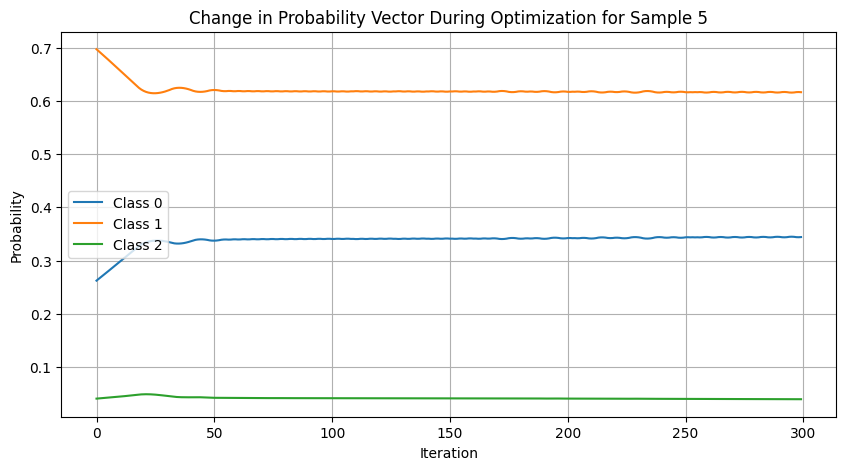

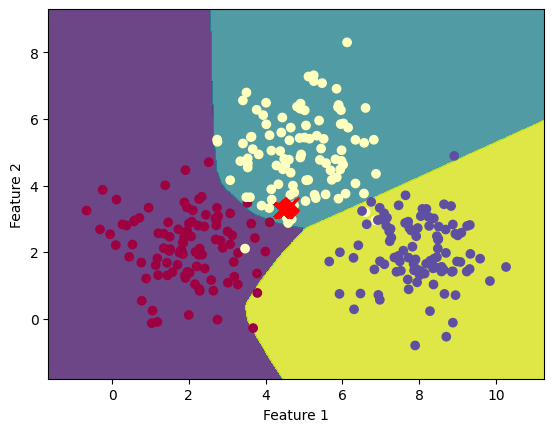

Sample 6 - Final Loss: 63.515838623046875


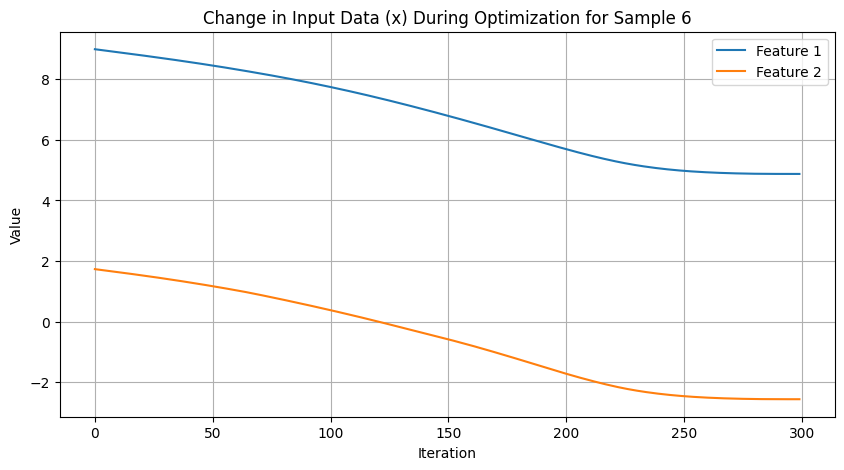

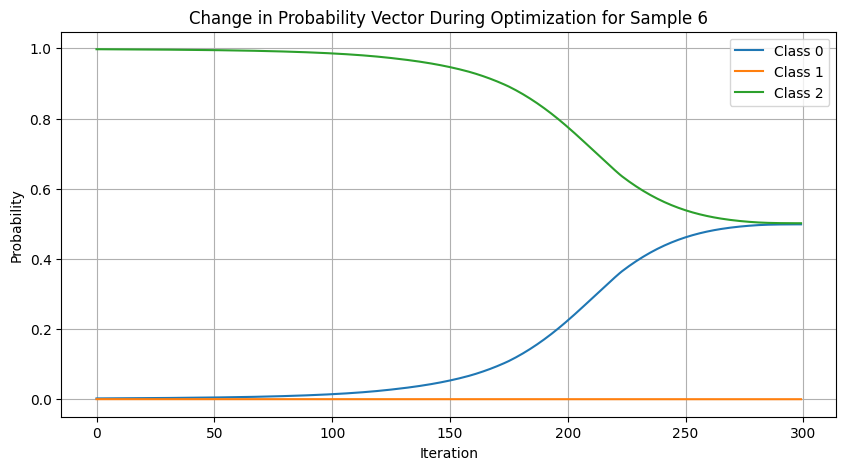

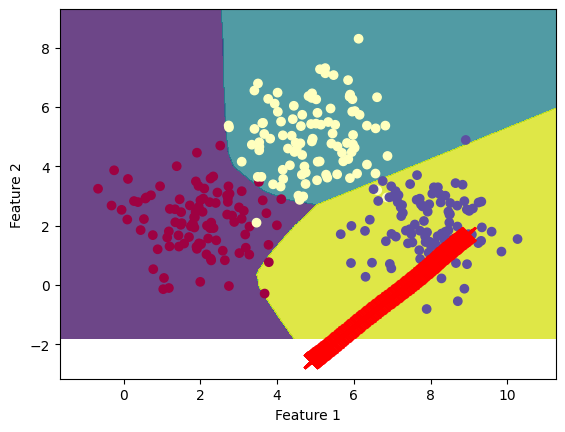

Sample 7 - Final Loss: 68.1606674194336


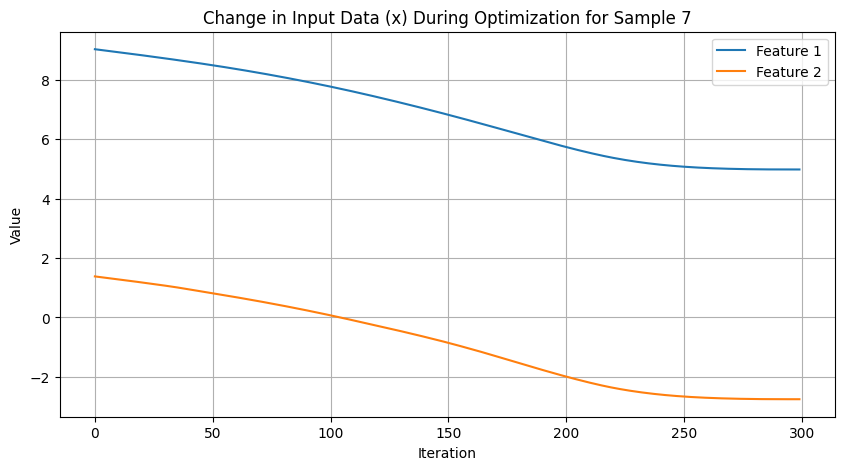

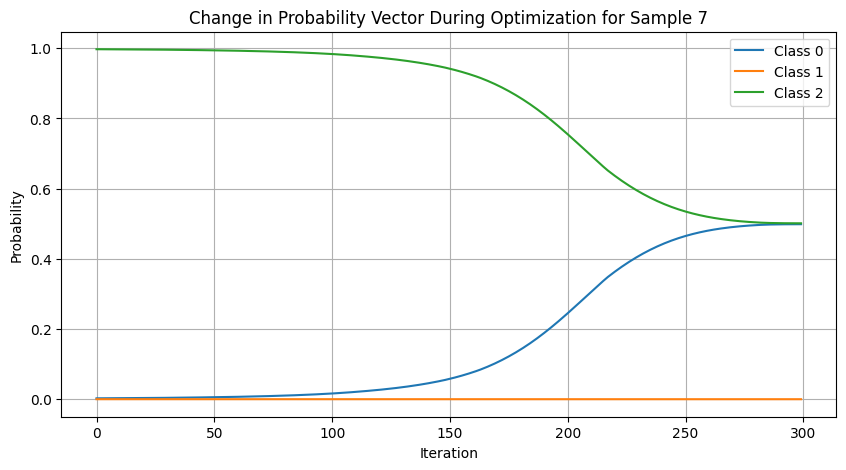

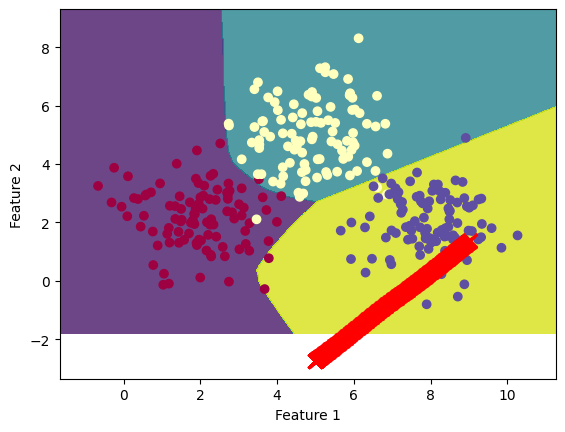

Sample 8 - Final Loss: 65.18412017822266


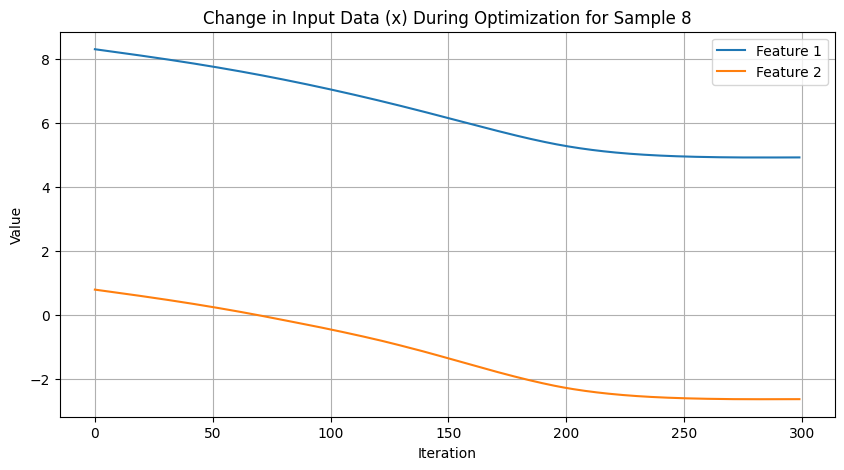

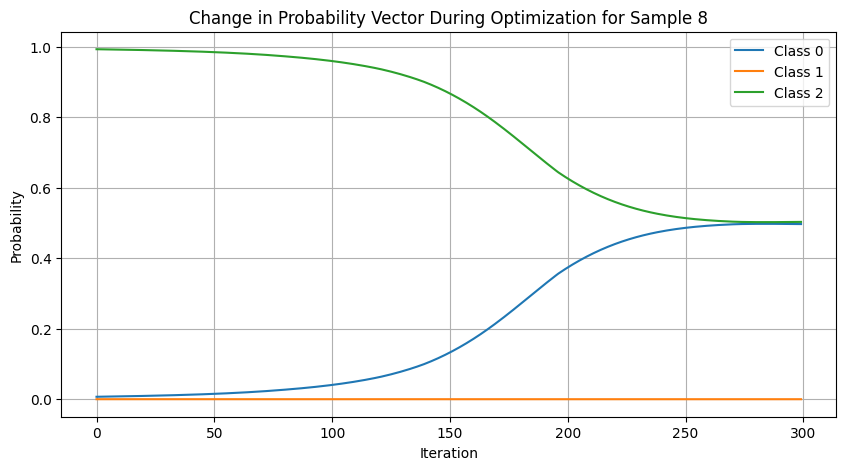

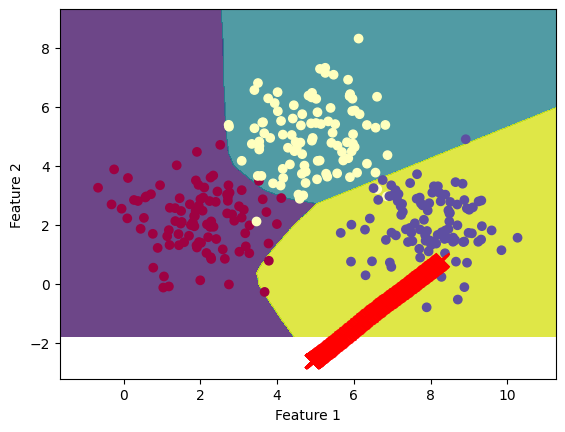

In [ ]:
# Create a list of data samples in the relevant range
data_samples, _ = generate_toy_data_3_classes(3, 3)
data_samples = torch.FloatTensor(data_samples)
target_l2 = 1 / 2

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_single_sample_old_loss(model, data_sample, target_l2, num_iterations=300)

    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()


    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x itself during optimization for the first sample
    sample_idx_to_visualize = result['Sample']  # Change this index to visualize a different sample
    x_history = np.array(results[sample_idx_to_visualize]['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the first sample
    prob_vector_history = np.array(results[sample_idx_to_visualize]['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    plot_decision_boundary_with_x_history(model, data, labels, results[sample_idx_to_visualize]['X History'])

<class 'numpy.ndarray'>
<class 'list'>
###################
tensor([0.9567], grad_fn=<SumBackward1>)
tensor([0.9560], grad_fn=<SumBackward1>)
tensor([0.9552], grad_fn=<SumBackward1>)
tensor([0.9544], grad_fn=<SumBackward1>)
tensor([0.9536], grad_fn=<SumBackward1>)
tensor([0.9528], grad_fn=<SumBackward1>)
tensor([0.9519], grad_fn=<SumBackward1>)
tensor([0.9510], grad_fn=<SumBackward1>)
tensor([0.9501], grad_fn=<SumBackward1>)
tensor([0.9491], grad_fn=<SumBackward1>)
tensor([0.9481], grad_fn=<SumBackward1>)
tensor([0.9470], grad_fn=<SumBackward1>)
tensor([0.9459], grad_fn=<SumBackward1>)
tensor([0.9448], grad_fn=<SumBackward1>)
tensor([0.9437], grad_fn=<SumBackward1>)
tensor([0.9426], grad_fn=<SumBackward1>)
tensor([0.9415], grad_fn=<SumBackward1>)
tensor([0.9403], grad_fn=<SumBackward1>)
tensor([0.9391], grad_fn=<SumBackward1>)
tensor([0.9379], grad_fn=<SumBackward1>)
tensor([0.9365], grad_fn=<SumBackward1>)
tensor([0.9351], grad_fn=<SumBackward1>)
tensor([0.9337], grad_fn=<SumBackward1>

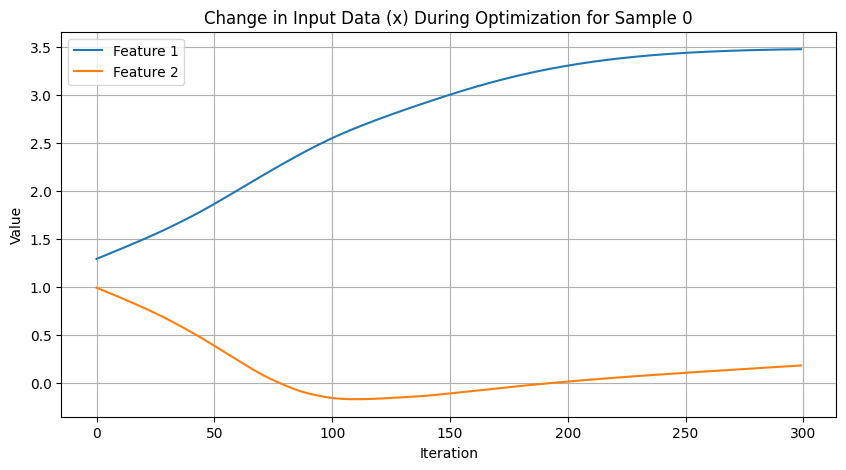

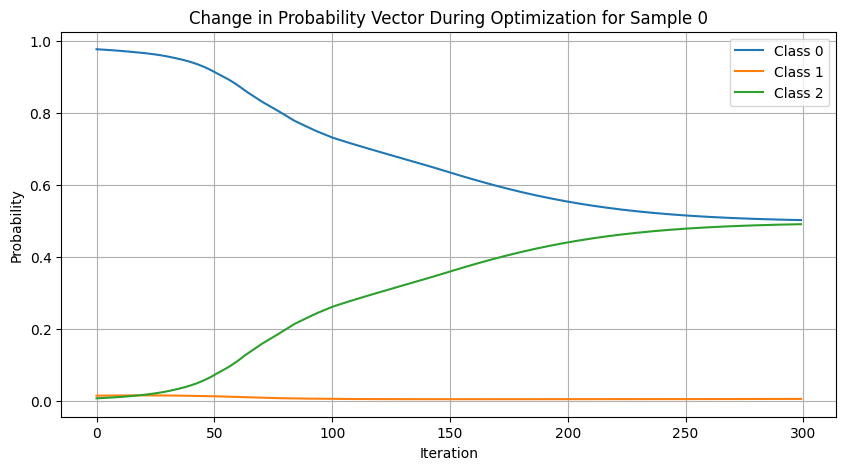

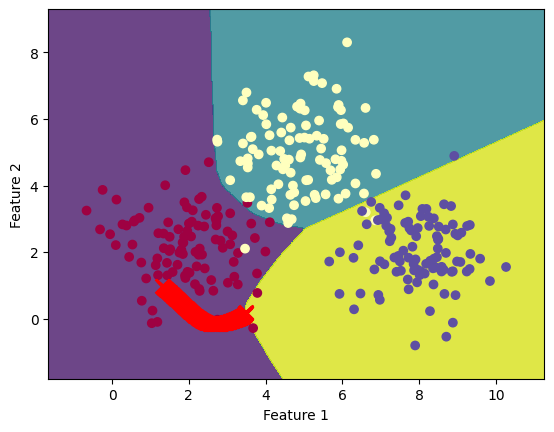

Sample 1 - Final Loss: 11.904677391052246


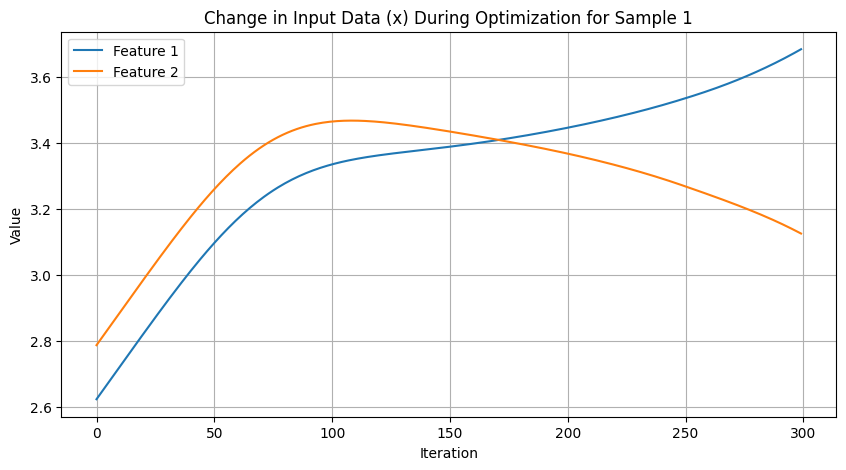

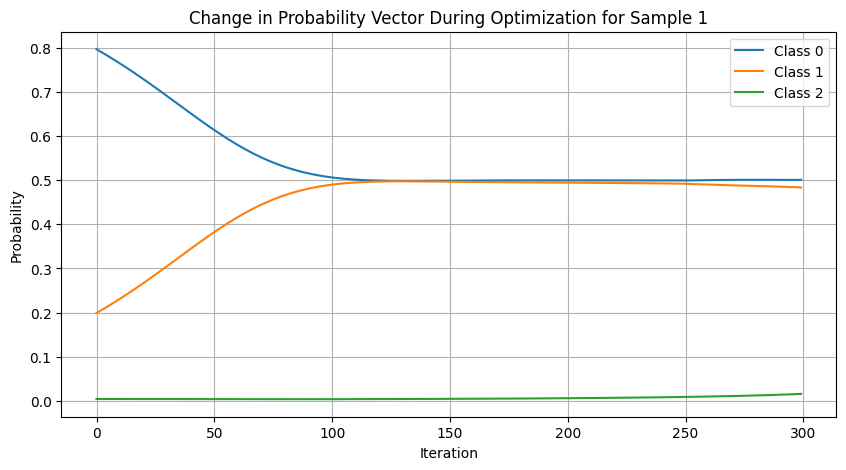

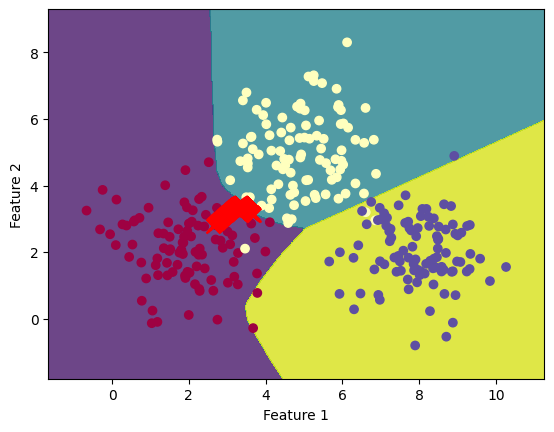

Sample 2 - Final Loss: 8.541496276855469


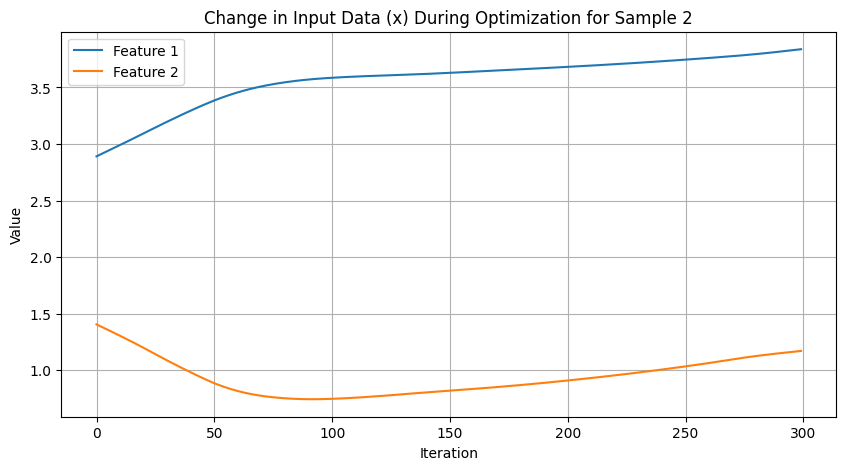

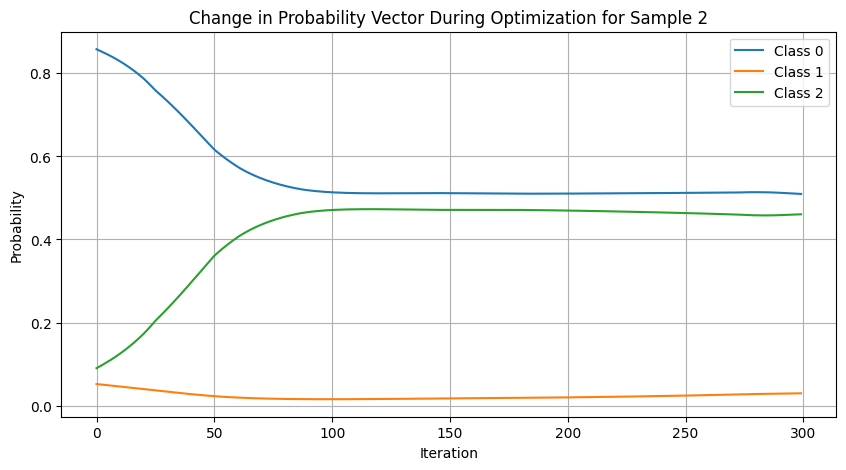

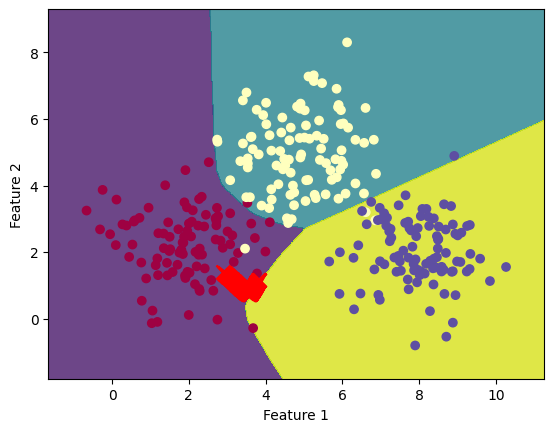

Sample 3 - Final Loss: 73.16265106201172


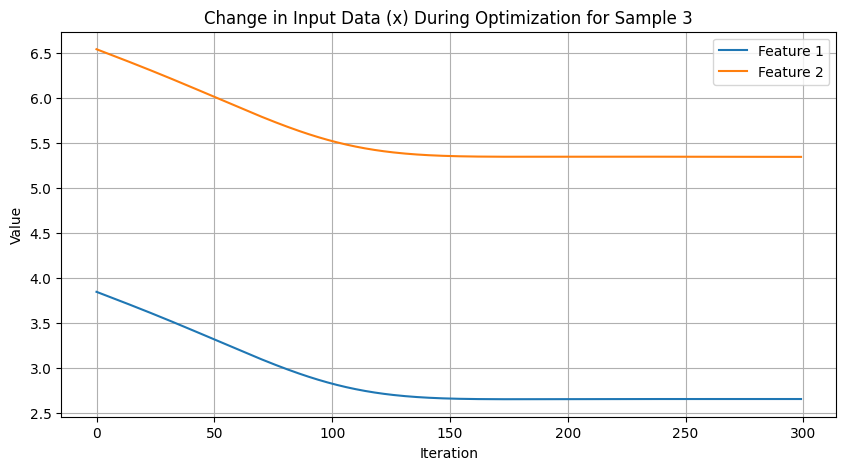

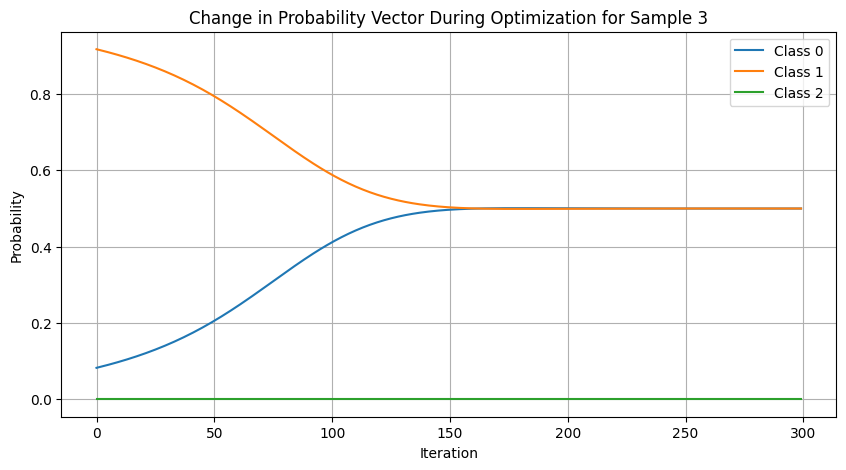

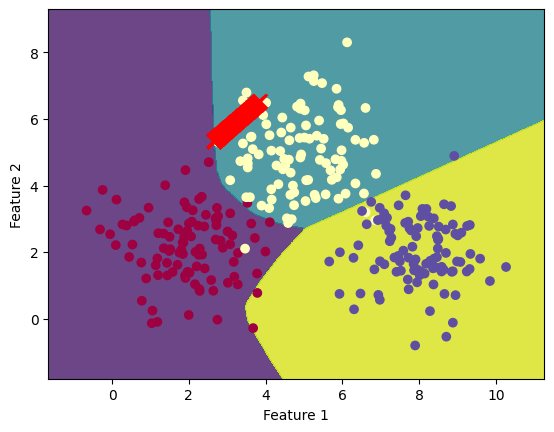

Sample 4 - Final Loss: 7.198011875152588


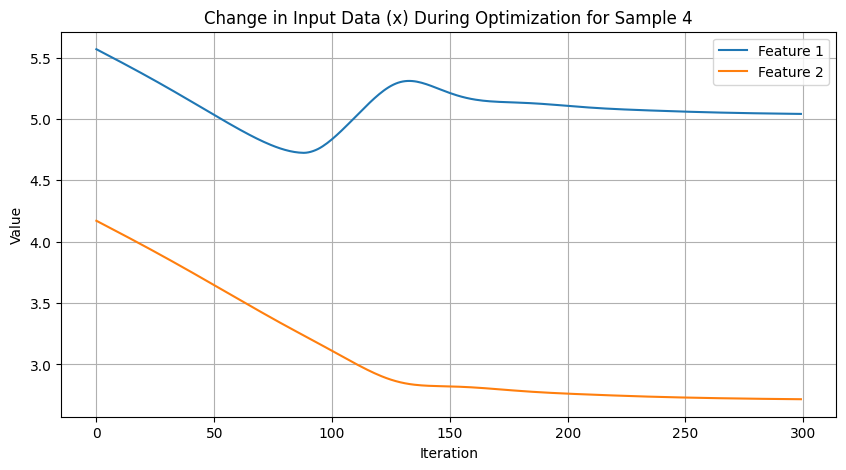

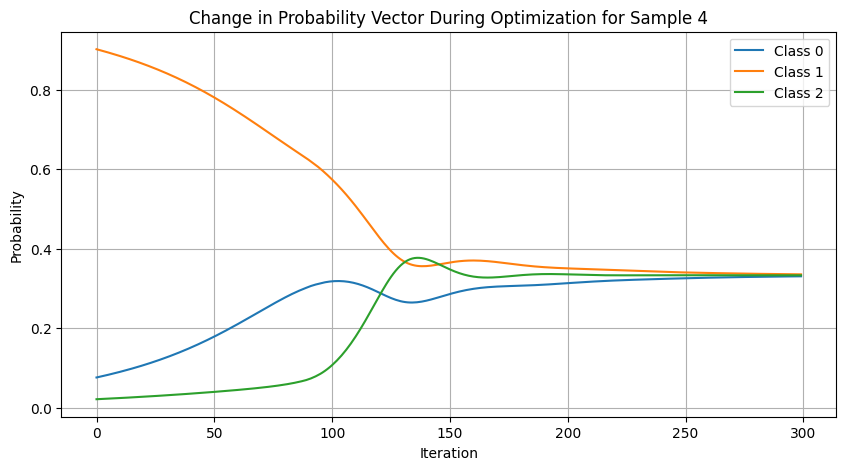

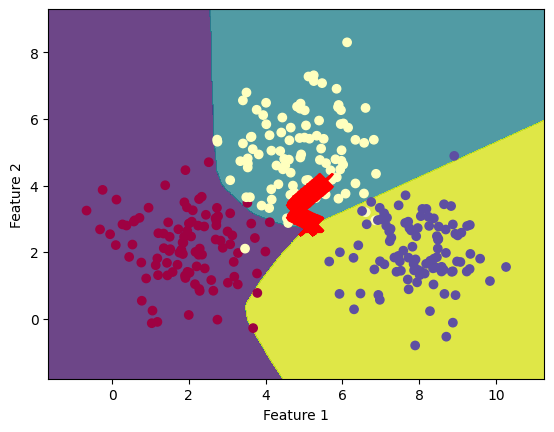

Sample 5 - Final Loss: 34.938472747802734


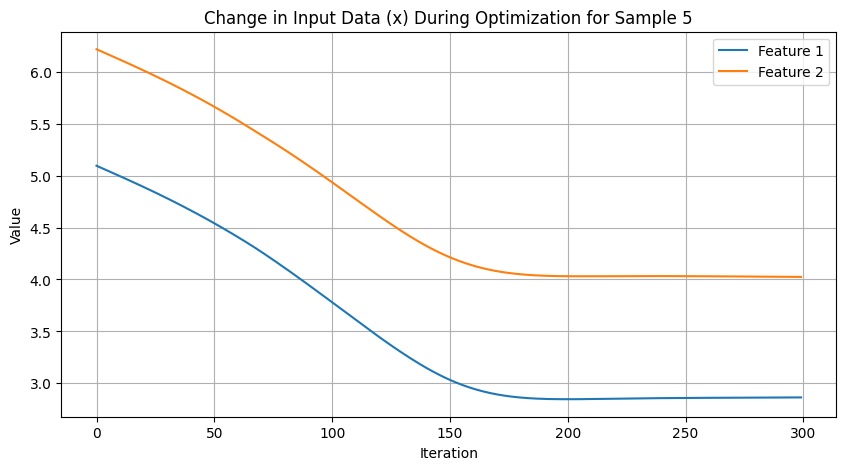

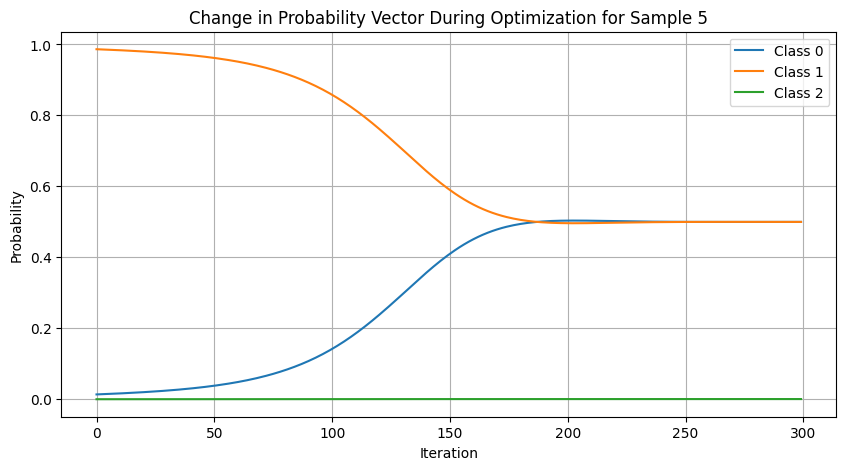

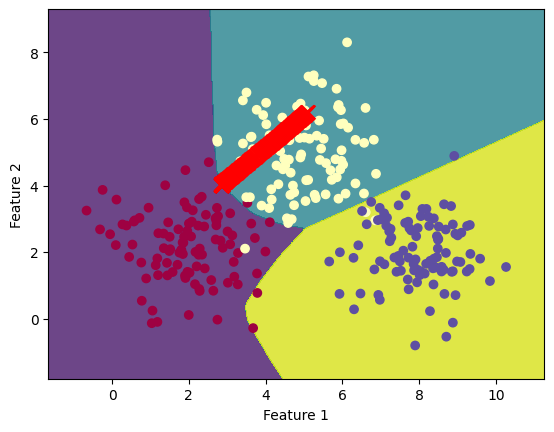

Sample 6 - Final Loss: 8.208986282348633


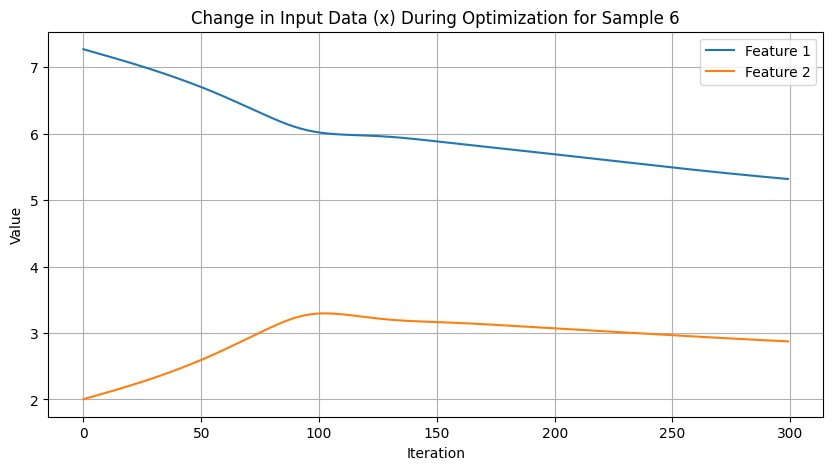

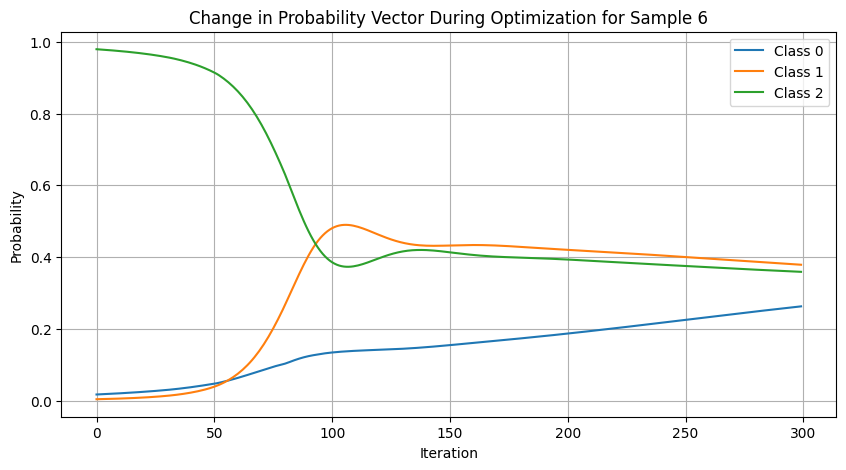

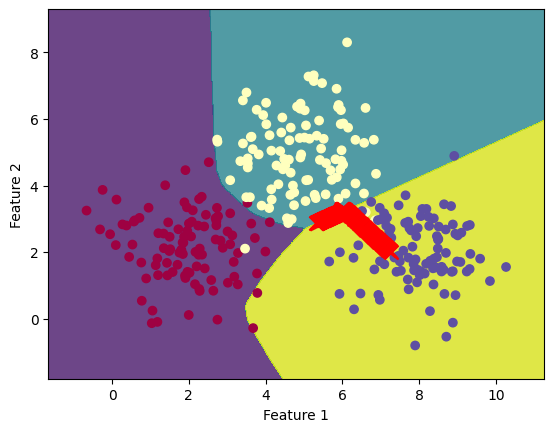

Sample 7 - Final Loss: 9.46131420135498


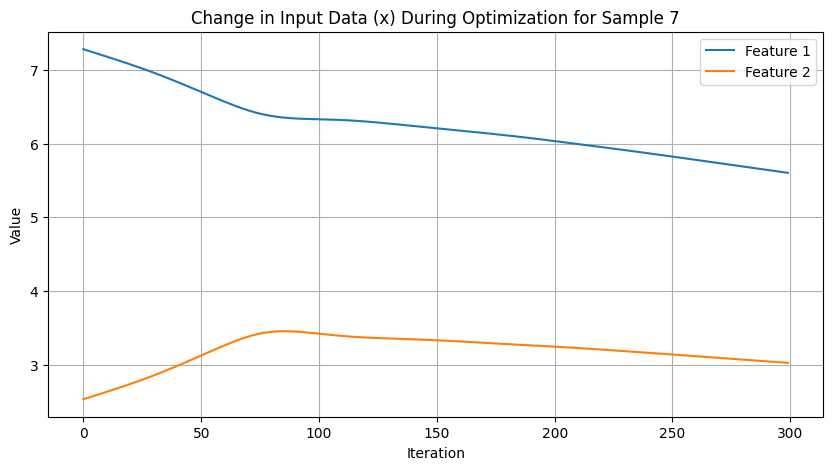

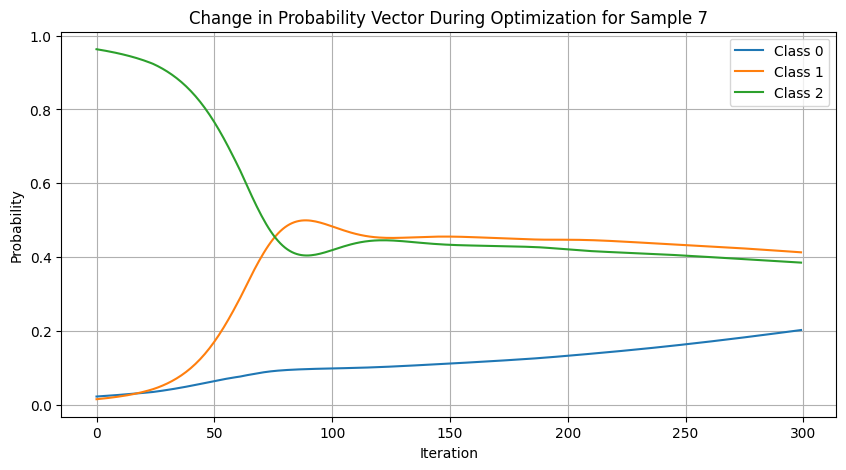

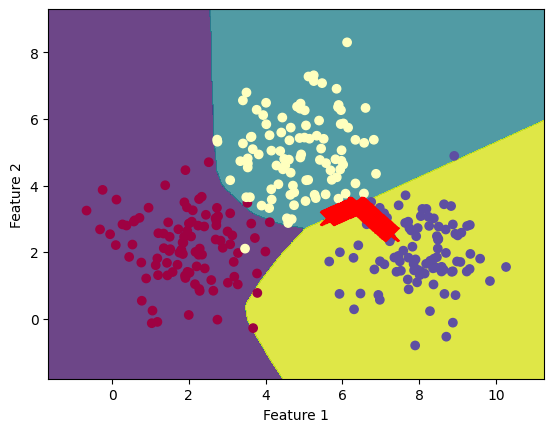

Sample 8 - Final Loss: 32.89012145996094


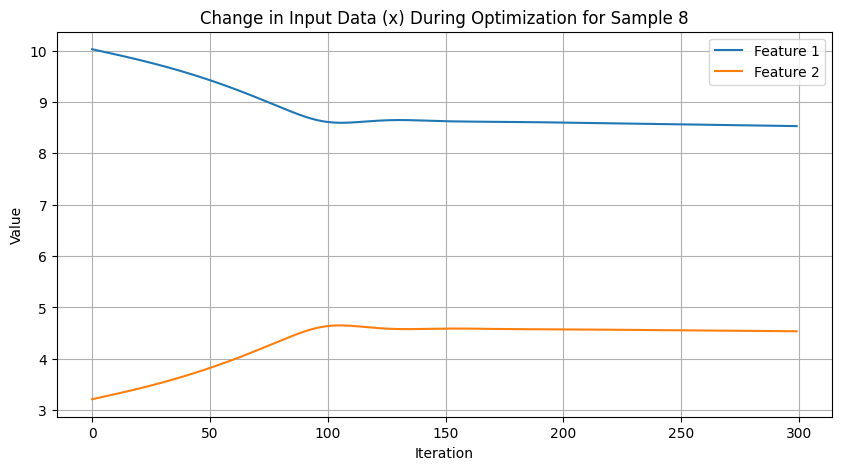

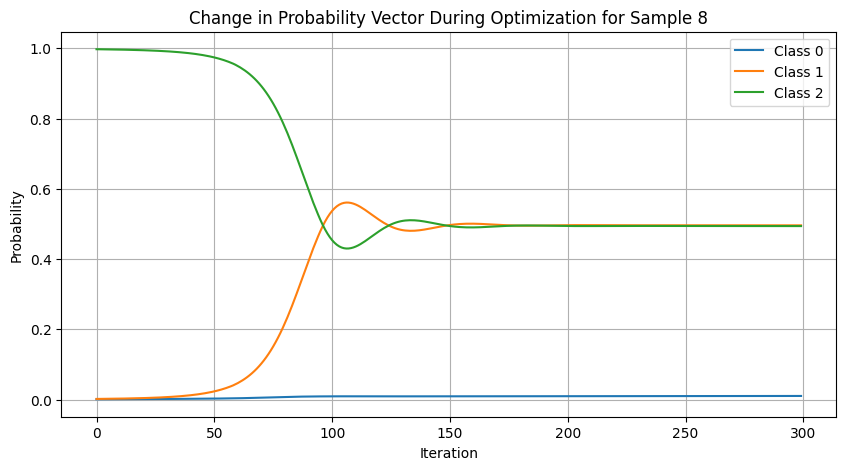

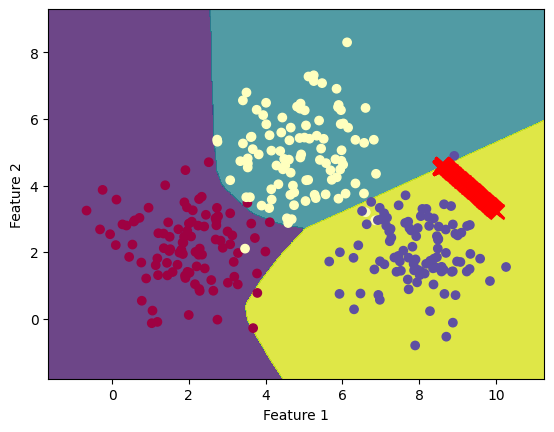

In [ ]:
# Create a list of data samples in the relevant range
data_samples, _ = generate_toy_data_3_classes(3, 3)
data_samples = torch.FloatTensor(data_samples)
target_l2 = 1 / 3

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    print("###################")
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_single_sample_old_loss(model, data_sample, target_l2, num_iterations=300)

    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()


    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x itself during optimization for the first sample
    sample_idx_to_visualize = result['Sample']  # Change this index to visualize a different sample
    x_history = np.array(results[sample_idx_to_visualize]['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the first sample
    prob_vector_history = np.array(results[sample_idx_to_visualize]['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    plot_decision_boundary_with_x_history(model, data, labels, results[sample_idx_to_visualize]['X History'])

# 4 classes

In [ ]:
# Generate toy data
num_samples_per_class = 100
num_classes = 4
data, labels = generate_toy_data_4_classes(num_samples_per_class)

# Convert data and labels to PyTorch tensors
data = torch.FloatTensor(data)
labels = torch.LongTensor(labels)

# Create a dataset and DataLoader
dataset = TensorDataset(data, labels)
batch_size = 32
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Define model and loss function
input_dim = 2
hidden_dim = 64
output_dim = num_classes
model = SimpleNN(input_dim, hidden_dim, output_dim)
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.01)
num_epochs = 100


In [ ]:

for epoch in range(num_epochs):
    for batch_data, batch_labels in dataloader:
        optimizer.zero_grad()
        outputs = model(batch_data)
        loss = criterion(outputs, batch_labels)
        loss.backward()
        optimizer.step()

    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}] Loss: {loss.item()}')

print('Training complete.')


Epoch [10/100] Loss: 0.4849816560745239
Epoch [20/100] Loss: 0.3012533187866211
Epoch [30/100] Loss: 0.21871508657932281
Epoch [40/100] Loss: 0.14597222208976746
Epoch [50/100] Loss: 0.214425191283226
Epoch [60/100] Loss: 0.2217310518026352
Epoch [70/100] Loss: 0.08545689284801483
Epoch [80/100] Loss: 0.145448699593544
Epoch [90/100] Loss: 0.15090884268283844
Epoch [100/100] Loss: 0.05977462977170944
Training complete.


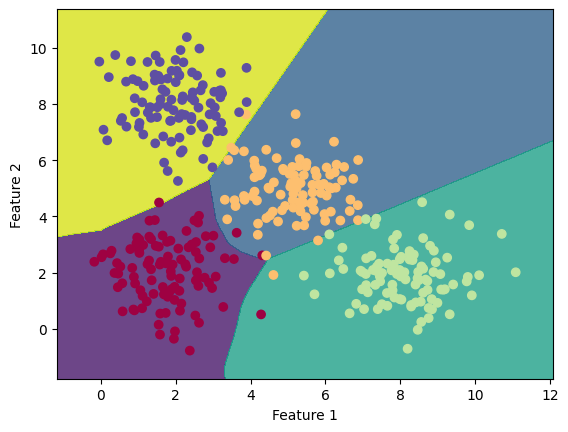

In [ ]:
plot_decision_boundary(model, data, labels)

###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
Sample 0 - Final Loss: 15.440251350402832


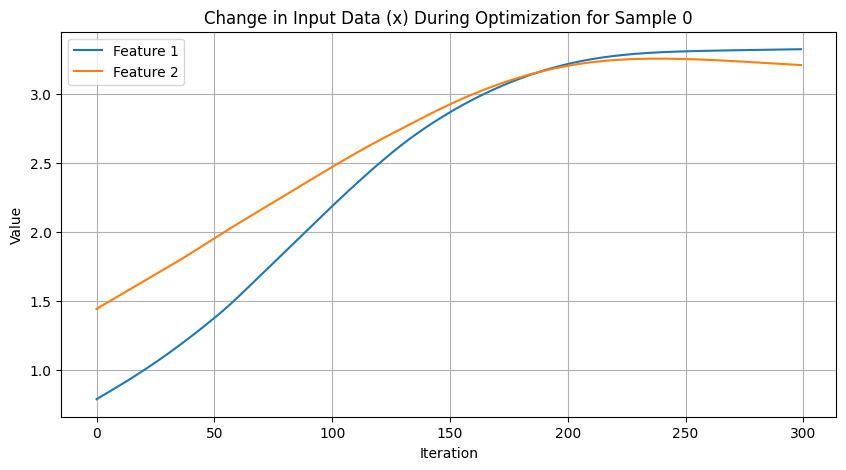

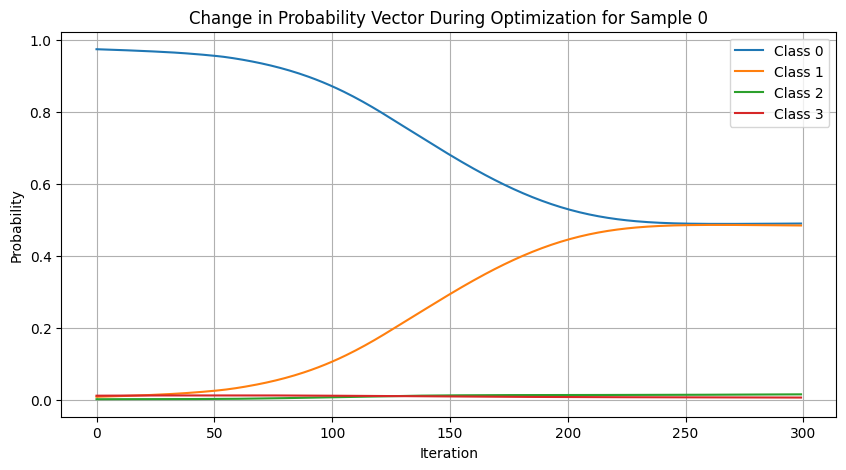

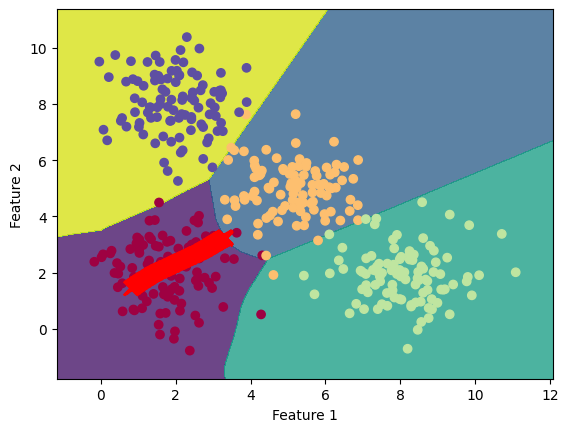

Sample 1 - Final Loss: 31.81804847717285


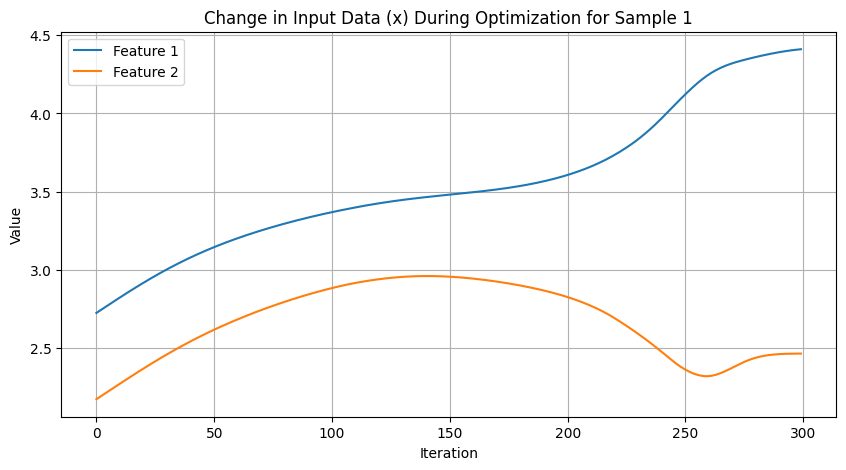

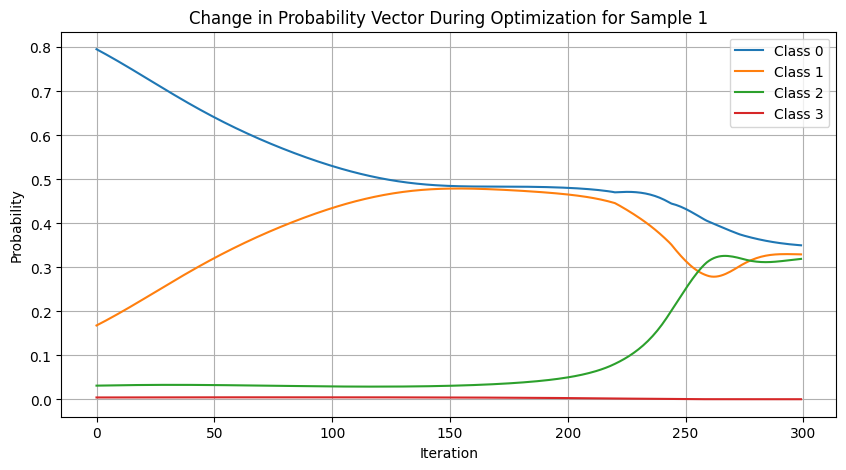

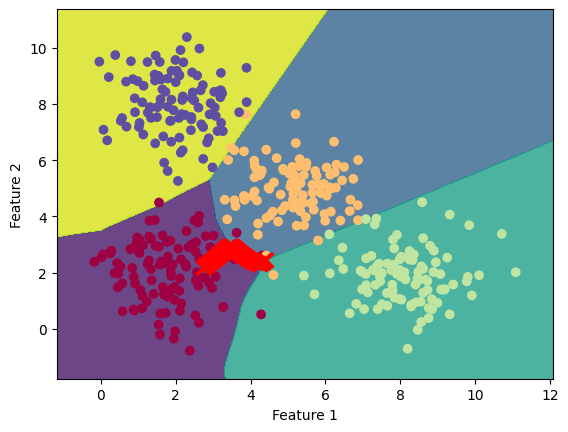

Sample 2 - Final Loss: 55.965736389160156


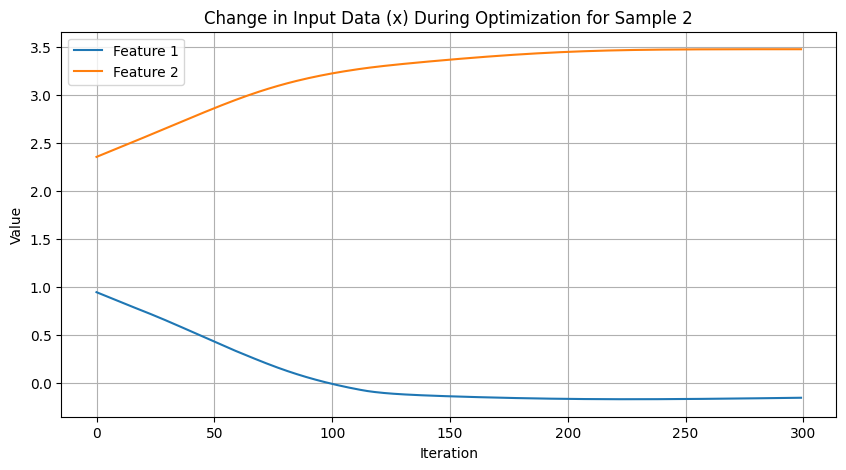

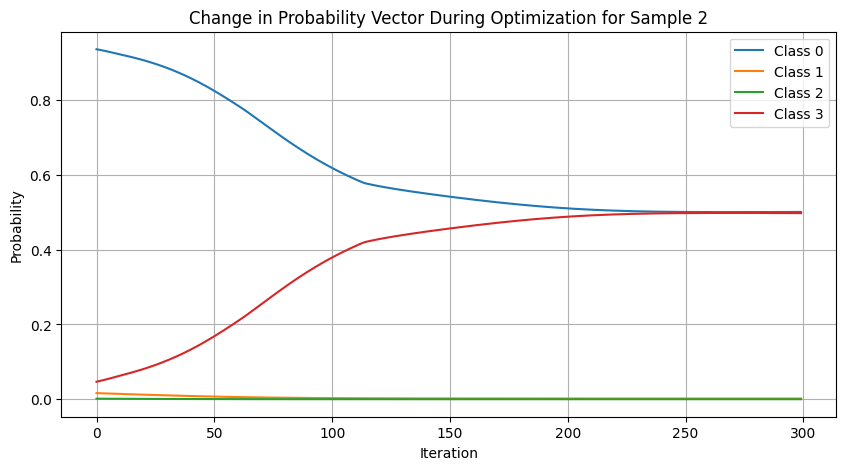

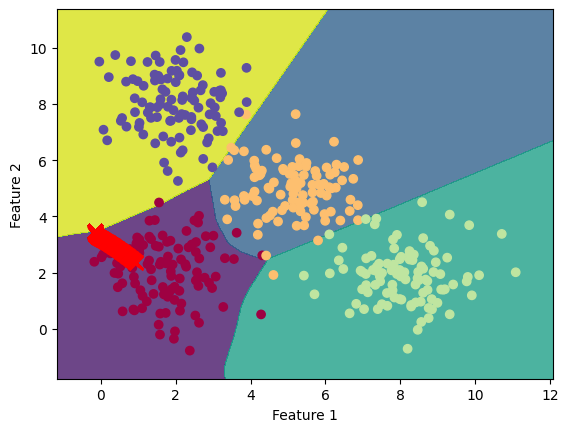

Sample 3 - Final Loss: 61.79837417602539


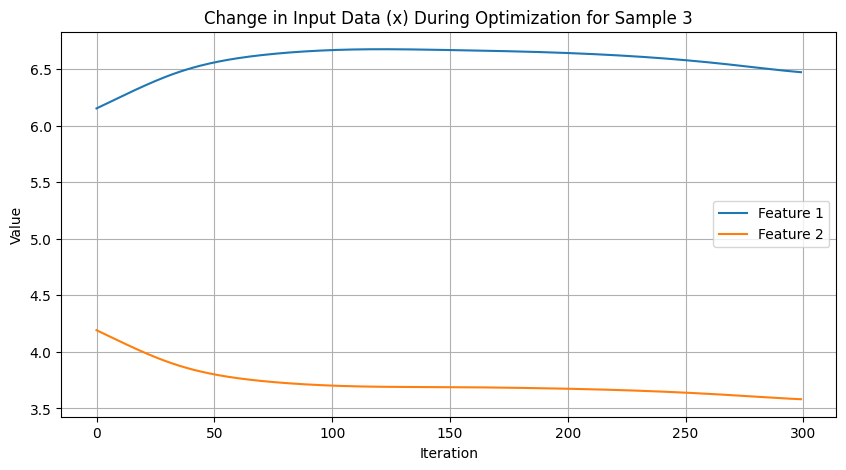

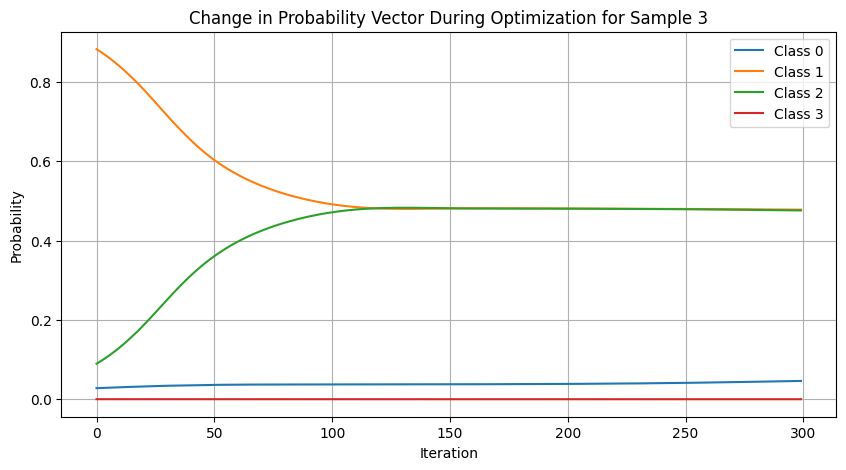

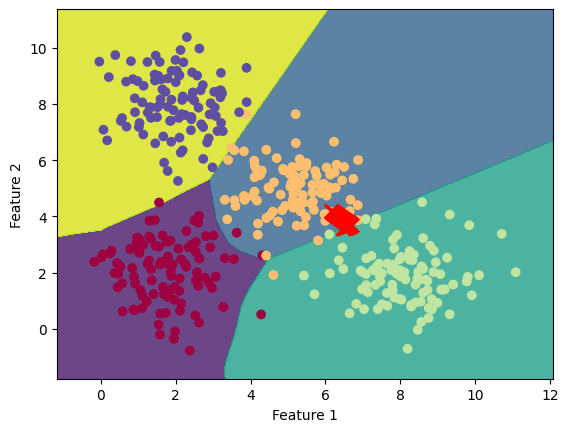

Sample 4 - Final Loss: 32.54148483276367


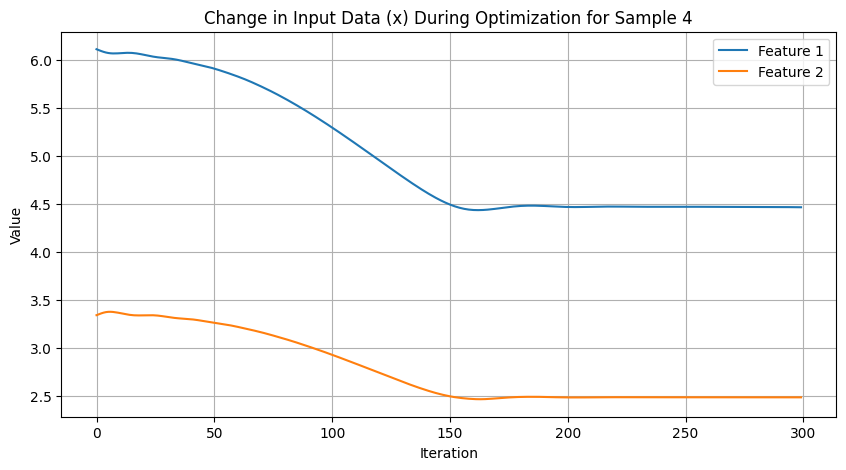

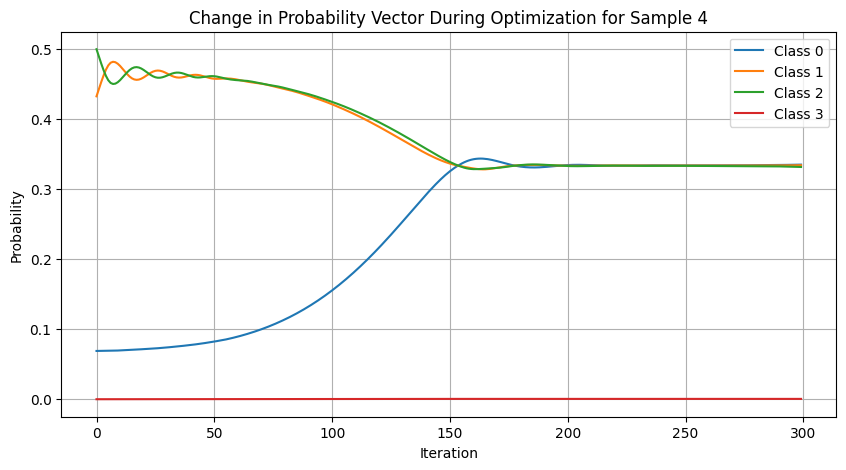

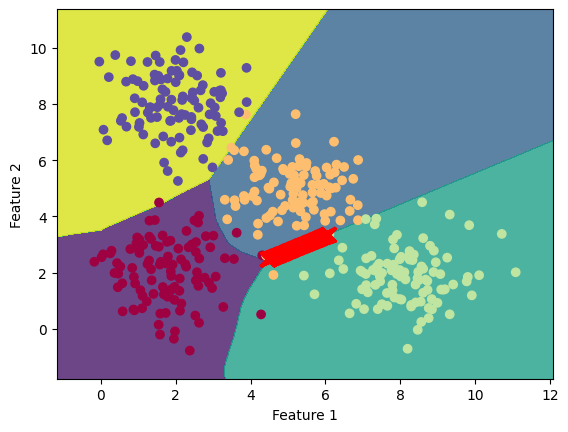

Sample 5 - Final Loss: 15.08617115020752


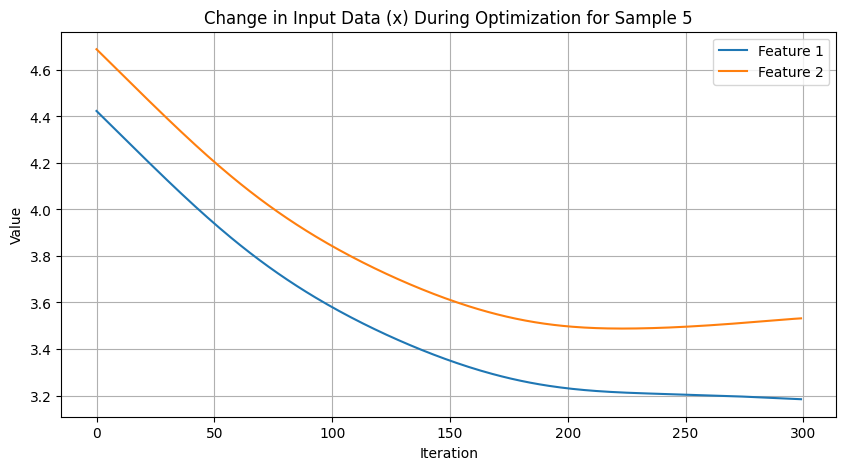

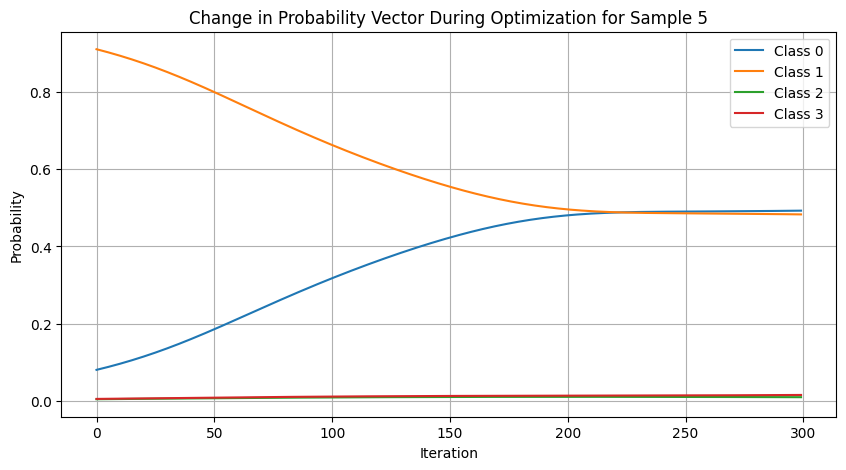

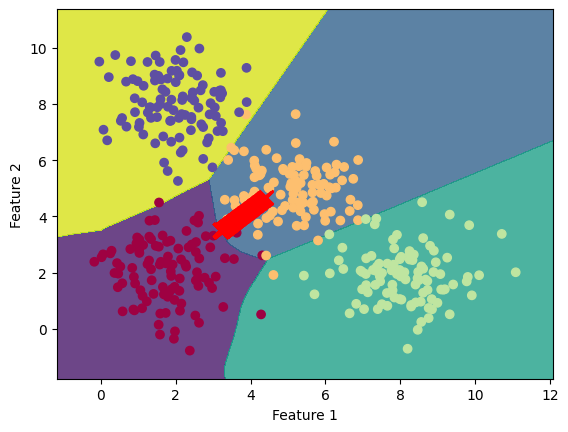

Sample 6 - Final Loss: 44.930240631103516


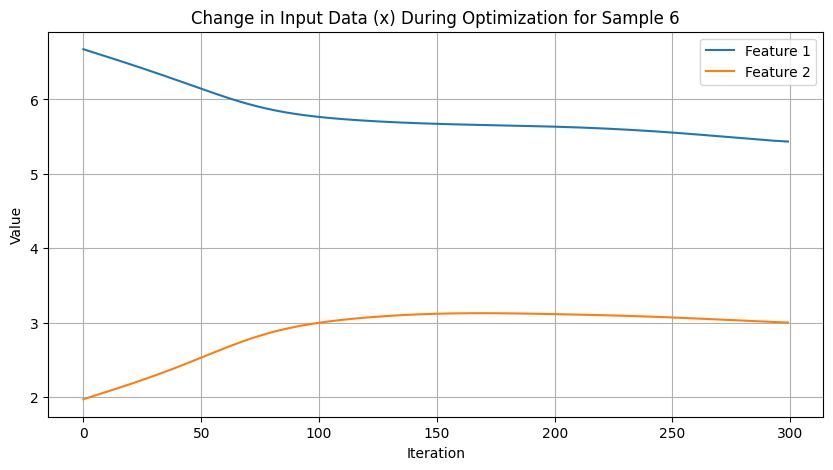

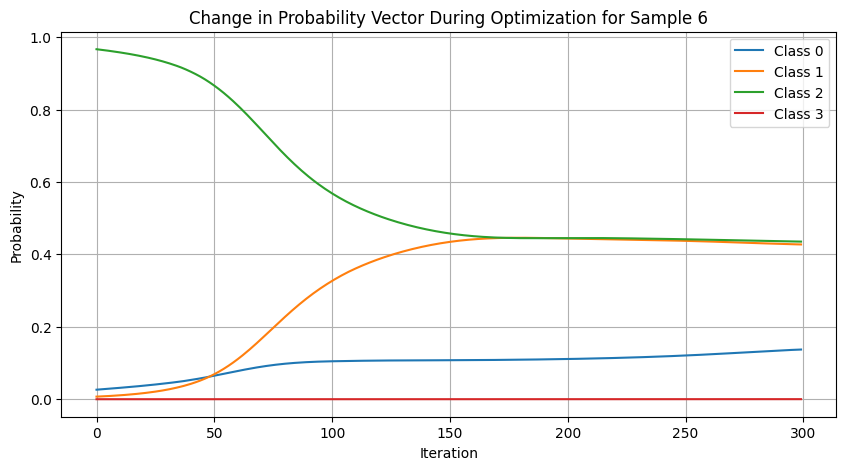

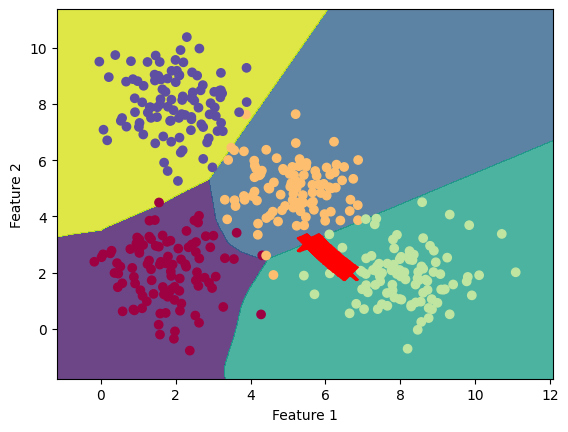

Sample 7 - Final Loss: 42.250247955322266


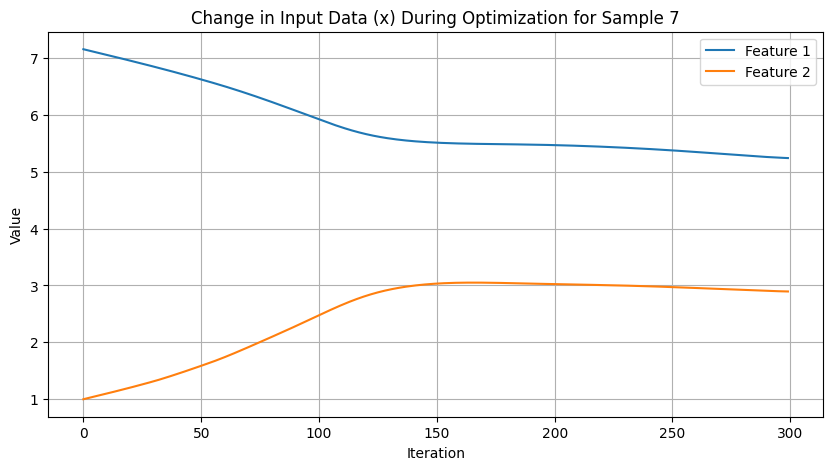

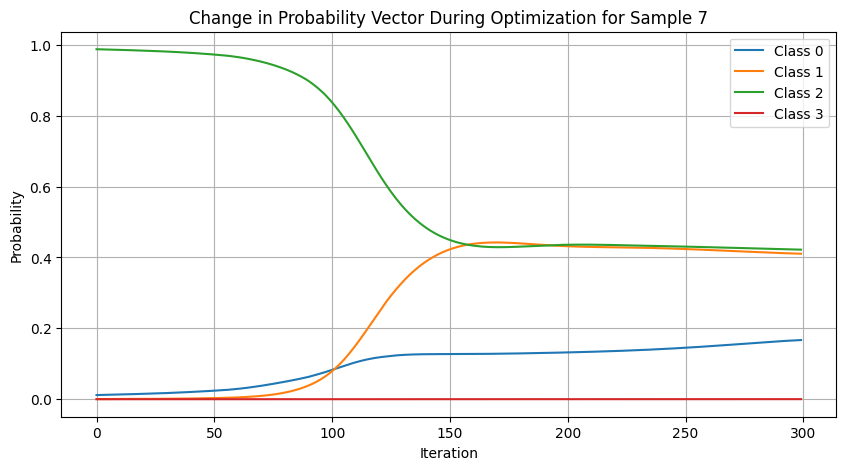

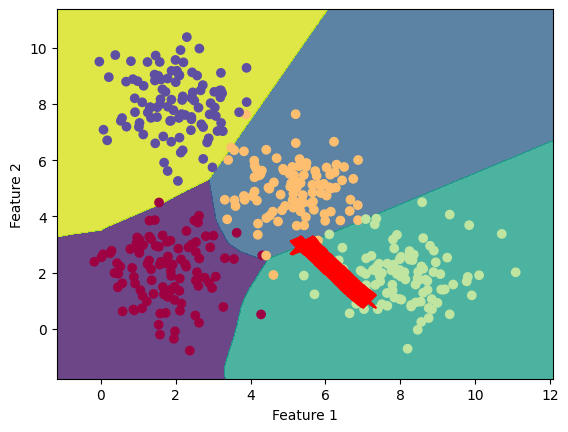

Sample 8 - Final Loss: 95.24224090576172


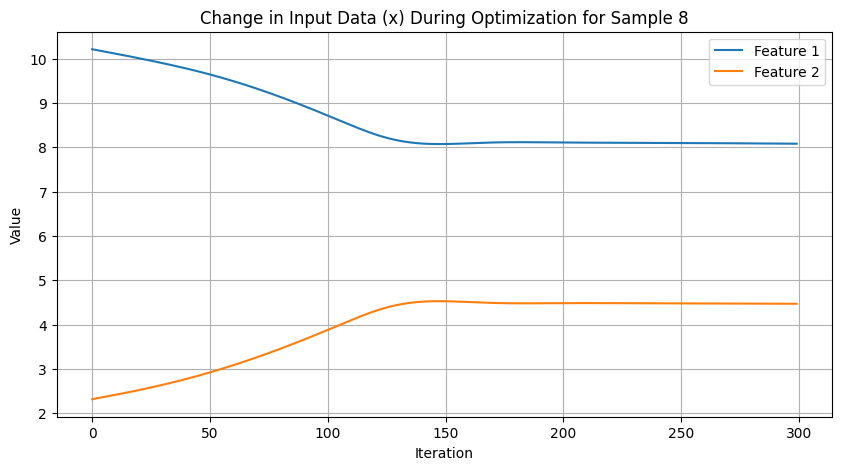

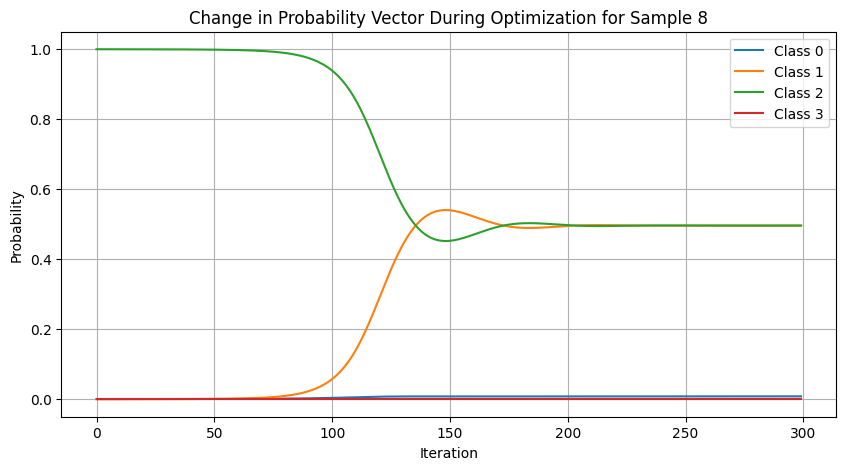

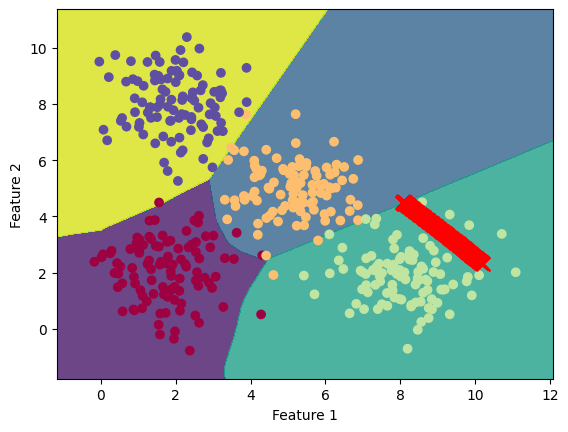

Sample 9 - Final Loss: 50.326419830322266


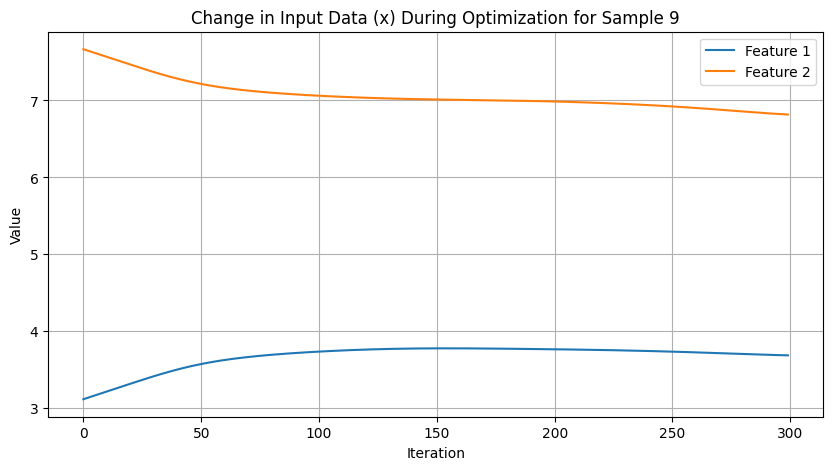

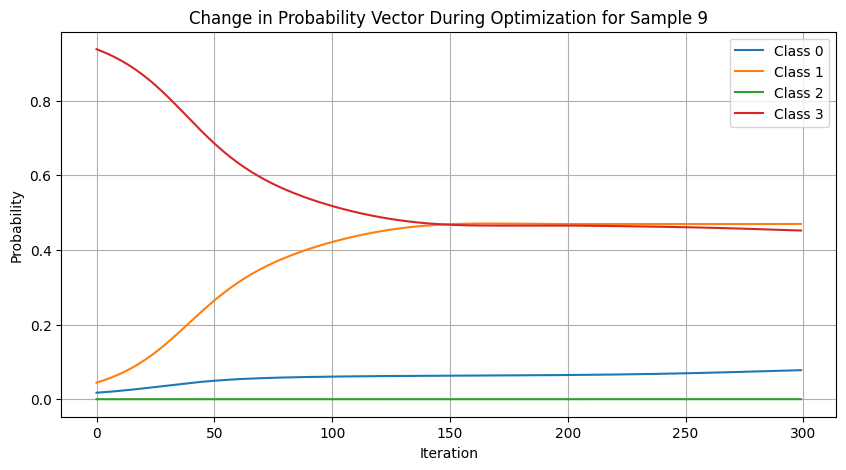

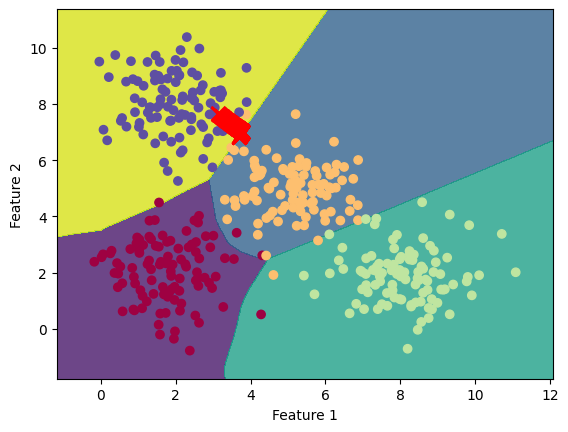

Sample 10 - Final Loss: 36.14021682739258


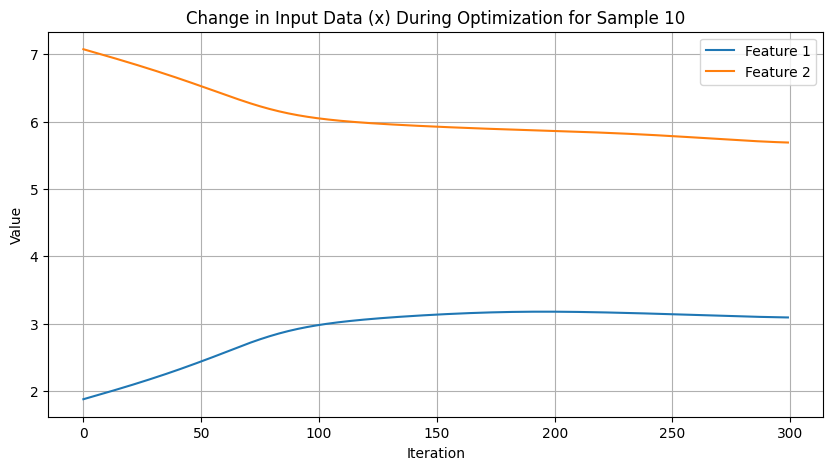

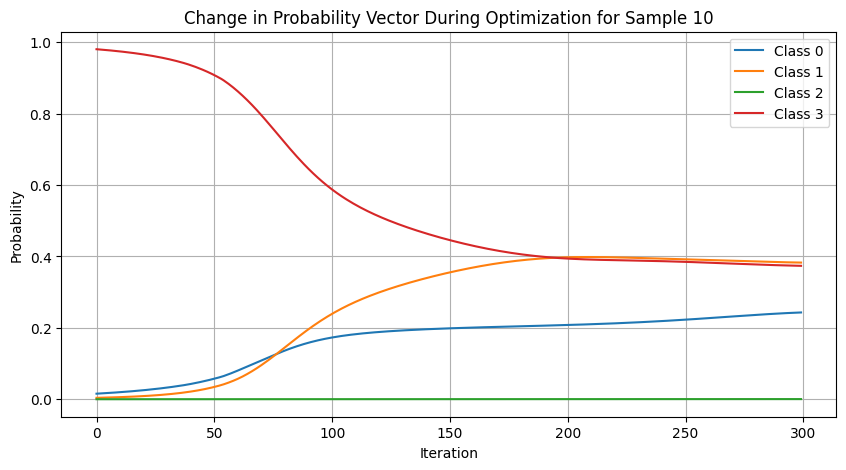

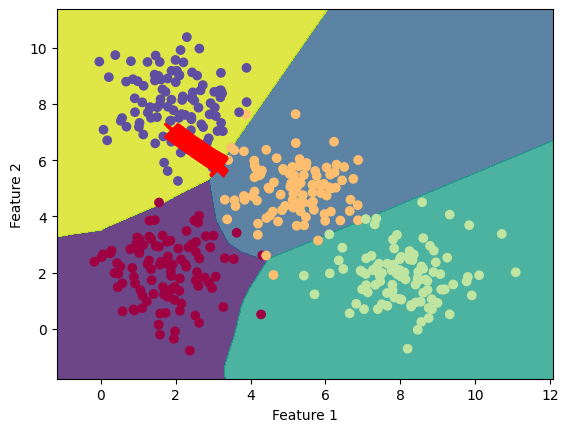

Sample 11 - Final Loss: 46.92683792114258


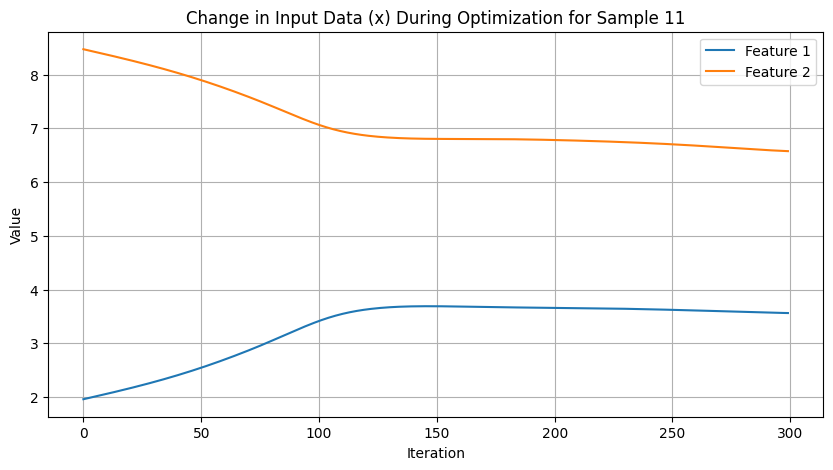

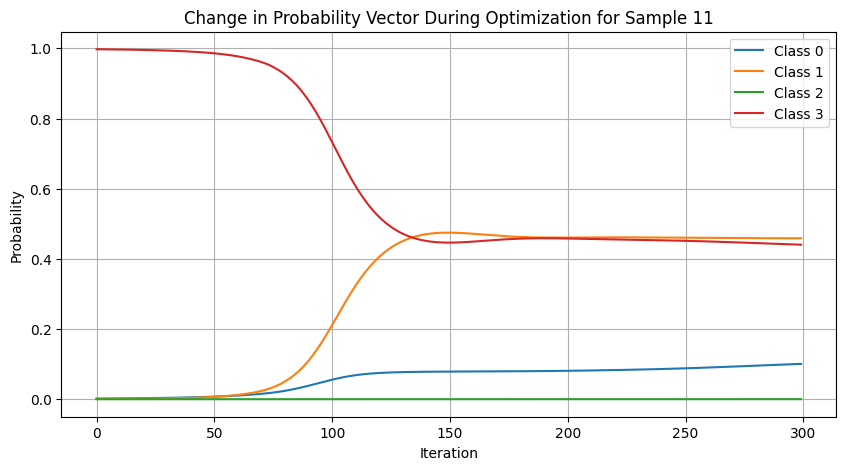

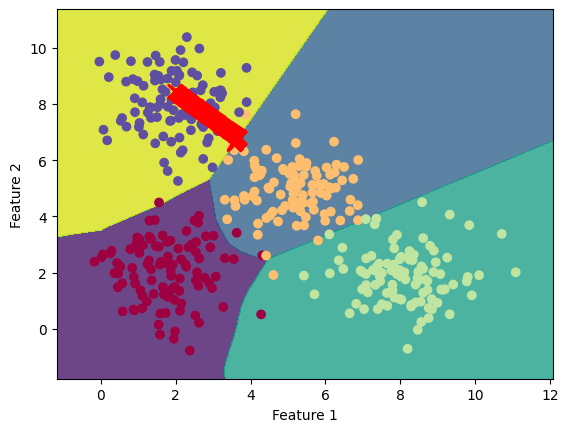

In [ ]:
# Create a list of data samples in the relevant range
data_samples, _ = generate_toy_data_4_classes(3, 4)
data_samples = torch.FloatTensor(data_samples)
target_l2 = 1 / 3

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    print("###################")
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_single_sample_nikita(model, data_sample, target_l2, num_iterations=300)

    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()


    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x itself during optimization for the first sample
    sample_idx_to_visualize = result['Sample']  # Change this index to visualize a different sample
    x_history = np.array(results[sample_idx_to_visualize]['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the first sample
    prob_vector_history = np.array(results[sample_idx_to_visualize]['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    plot_decision_boundary_with_x_history(model, data, labels, results[sample_idx_to_visualize]['X History'])

## Intersection point

In [ ]:
# Generate toy data
num_samples_per_class = 100
num_classes = 4
data, labels = generate_toy_data_4_classes_intersect(num_samples_per_class)

# Convert data and labels to PyTorch tensors
data = torch.FloatTensor(data)
labels = torch.LongTensor(labels)

# Create a dataset and DataLoader
dataset = TensorDataset(data, labels)
batch_size = 32
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Define model and loss function
input_dim = 2
hidden_dim = 64
output_dim = num_classes
model = SimpleNN(input_dim, hidden_dim, output_dim)
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=0.01)
num_epochs = 100

for epoch in range(num_epochs):
    for batch_data, batch_labels in dataloader:
        optimizer.zero_grad()
        outputs = model(batch_data)
        loss = criterion(outputs, batch_labels)
        loss.backward()
        optimizer.step()

    if (epoch + 1) % 10 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}] Loss: {loss.item()}')

print('Training complete.')


Epoch [10/100] Loss: 0.43954330682754517
Epoch [20/100] Loss: 0.4845641553401947
Epoch [30/100] Loss: 0.3445385694503784
Epoch [40/100] Loss: 0.4192173480987549
Epoch [50/100] Loss: 0.25003495812416077
Epoch [60/100] Loss: 0.5050824880599976
Epoch [70/100] Loss: 0.4134448766708374
Epoch [80/100] Loss: 0.5390597581863403
Epoch [90/100] Loss: 0.2781699597835541
Epoch [100/100] Loss: 0.41624993085861206
Training complete.


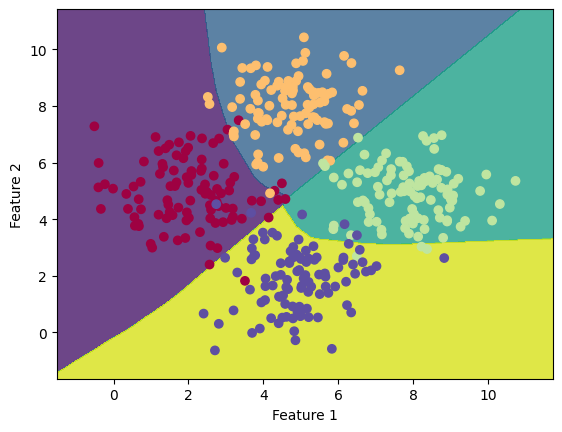

In [ ]:
plot_decision_boundary(model, data, labels)

###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
###################
Sample 0 - Final Loss: 0.16538771986961365


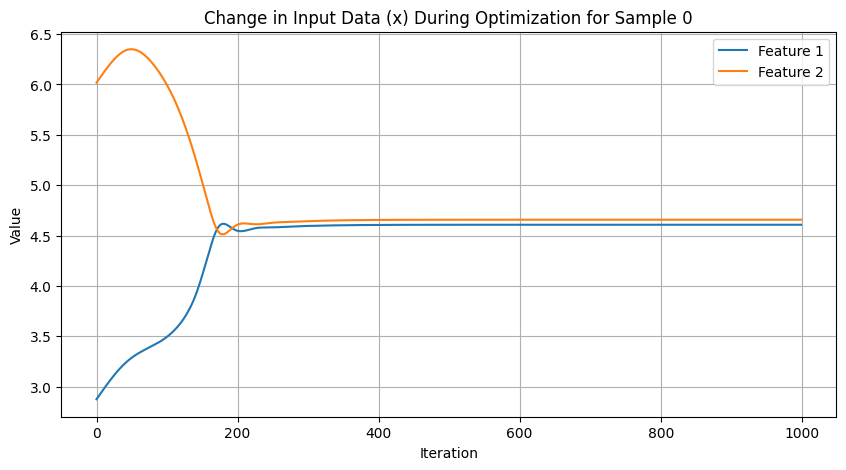

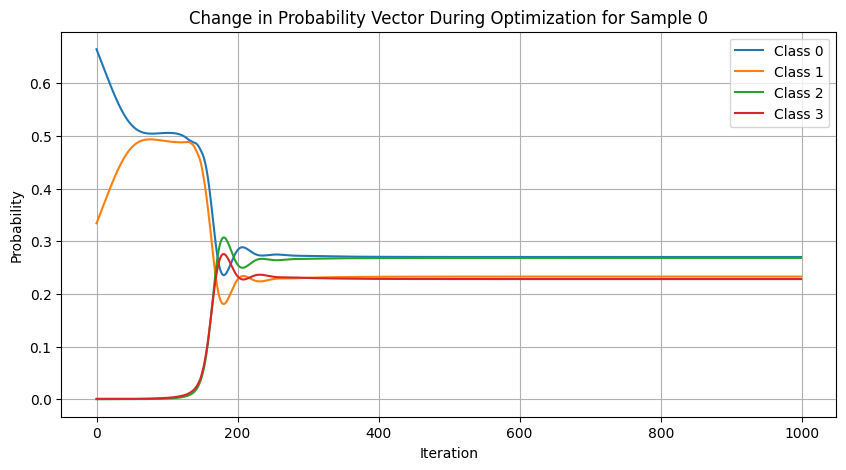

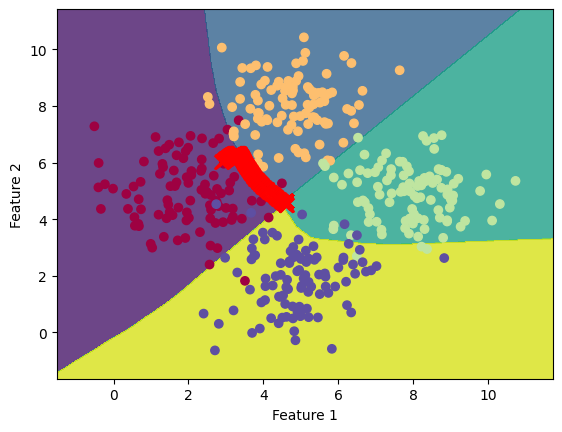

Sample 1 - Final Loss: 0.16538795828819275


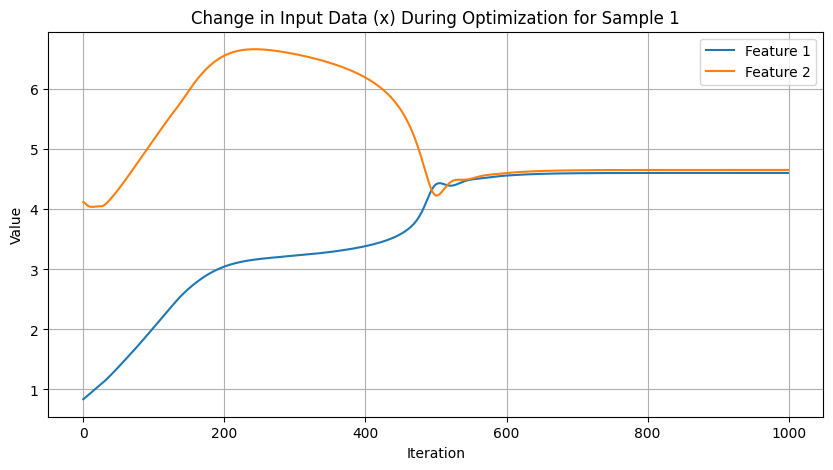

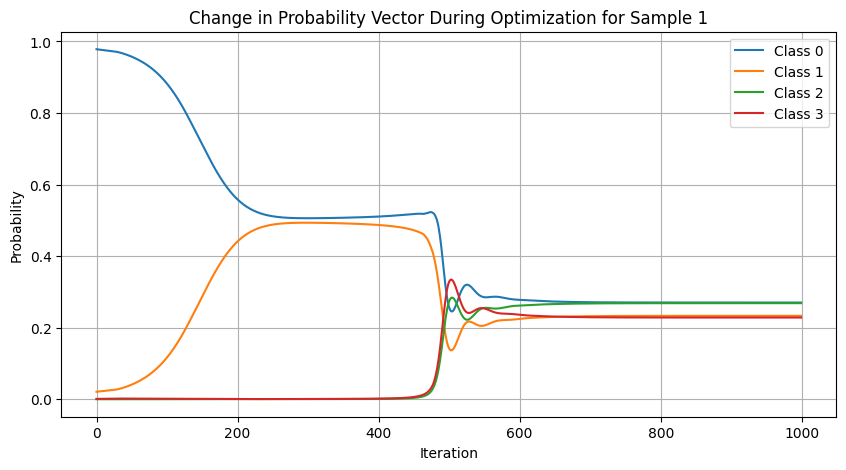

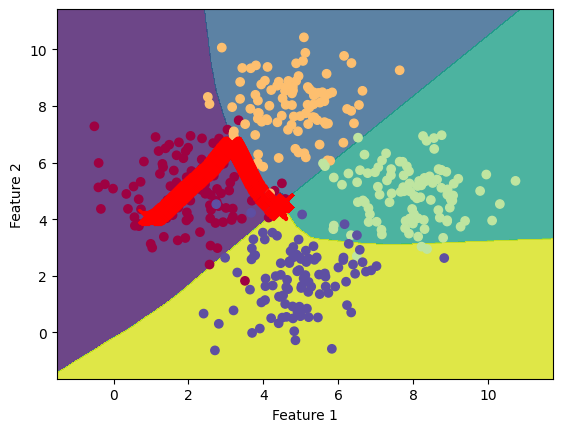

Sample 2 - Final Loss: 195.7249298095703


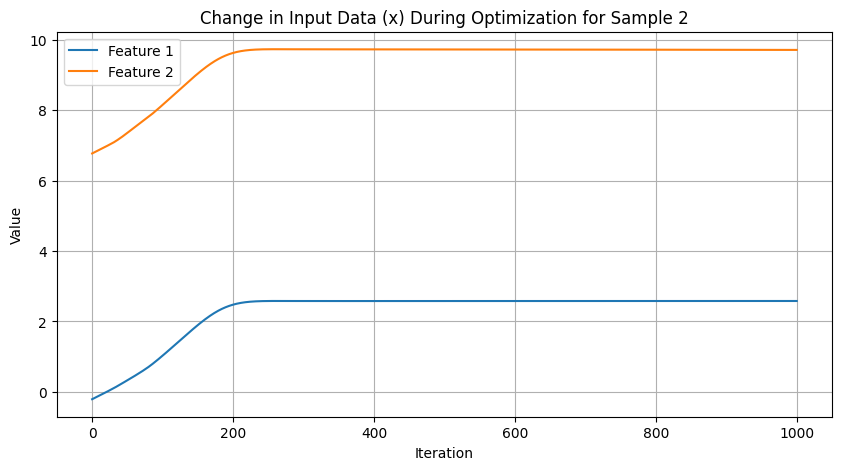

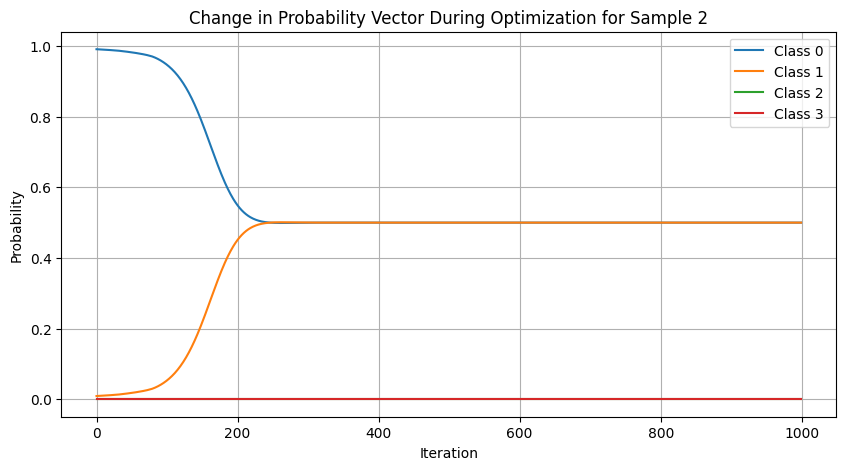

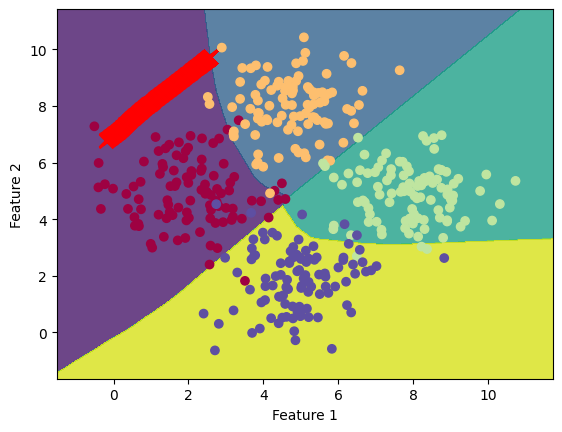

Sample 3 - Final Loss: 0.16539064049720764


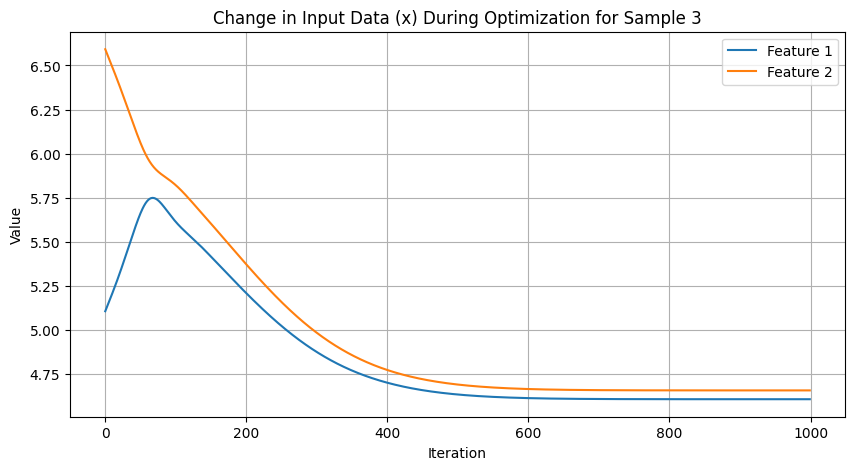

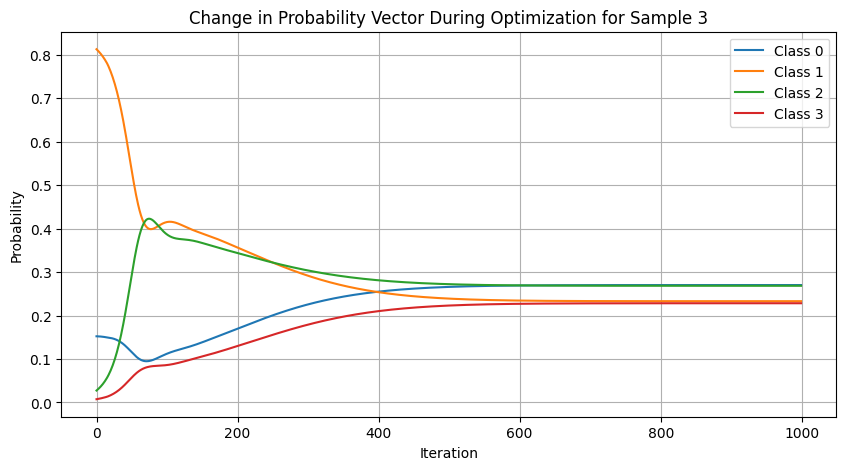

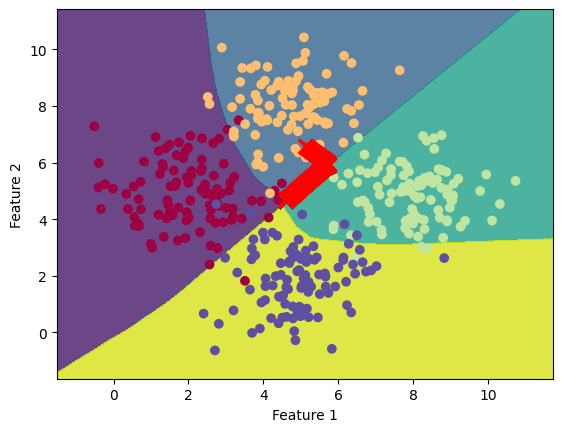

Sample 4 - Final Loss: 0.16531941294670105


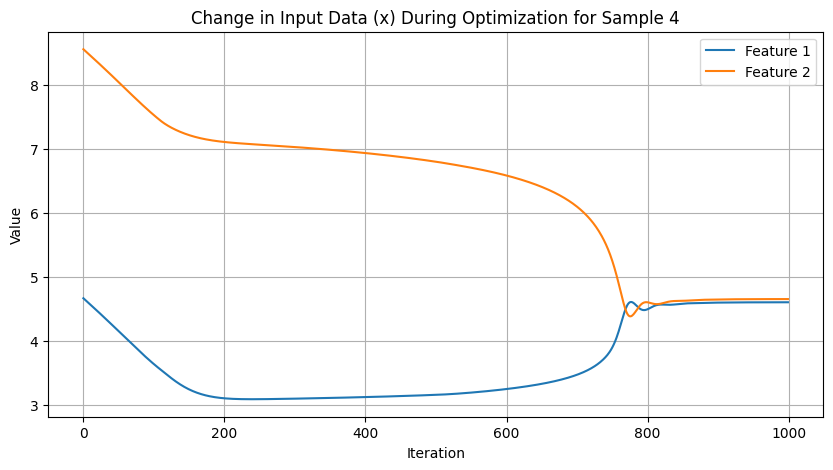

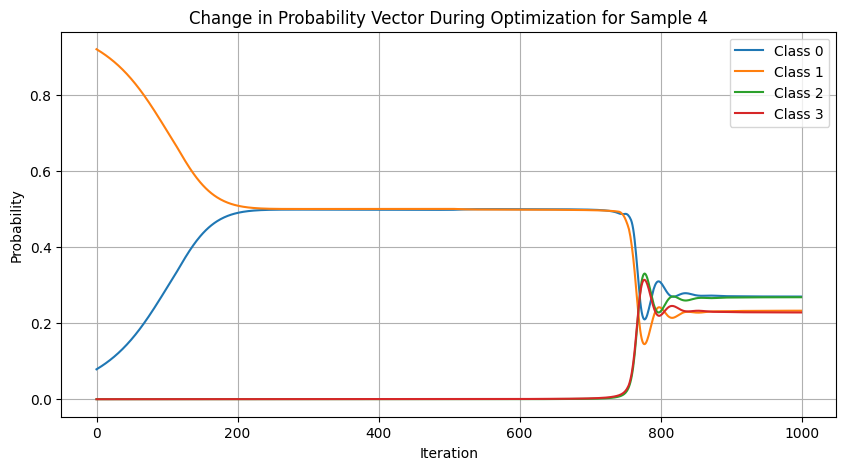

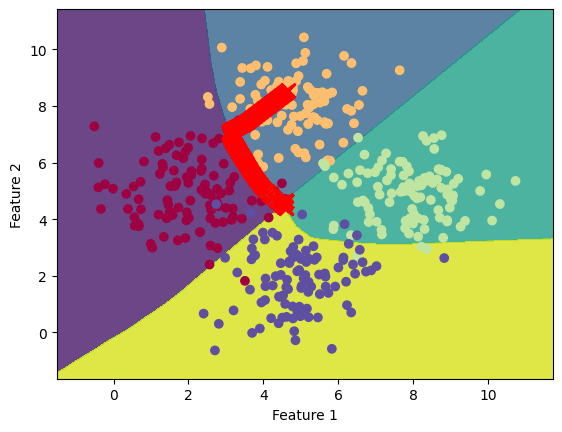

Sample 5 - Final Loss: 0.16529357433319092


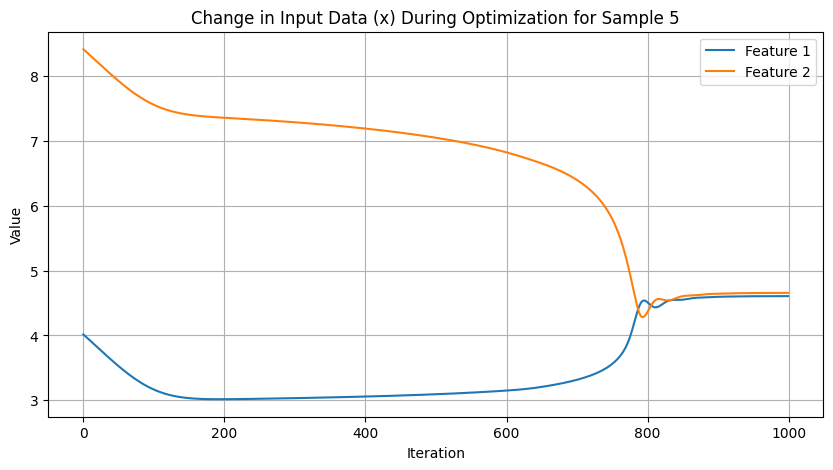

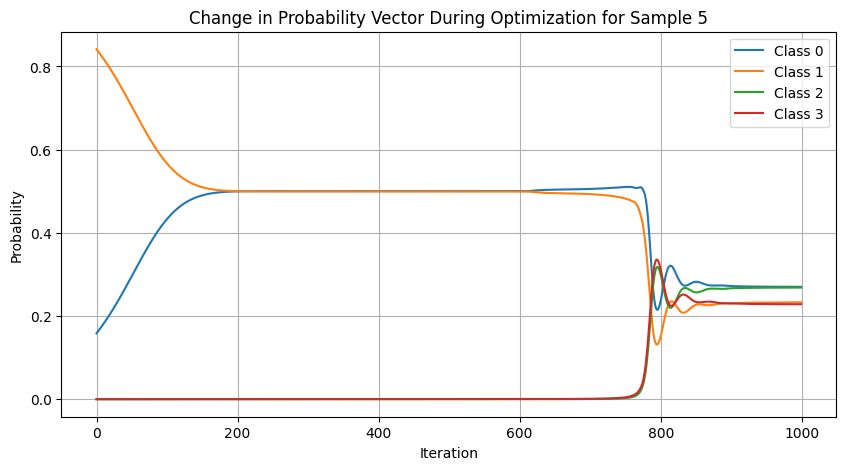

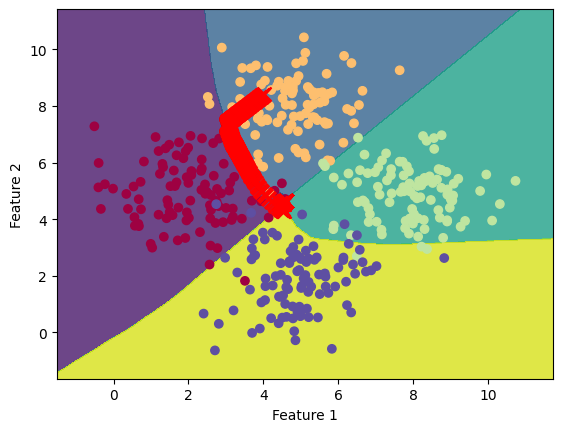

Sample 6 - Final Loss: 85.71087646484375


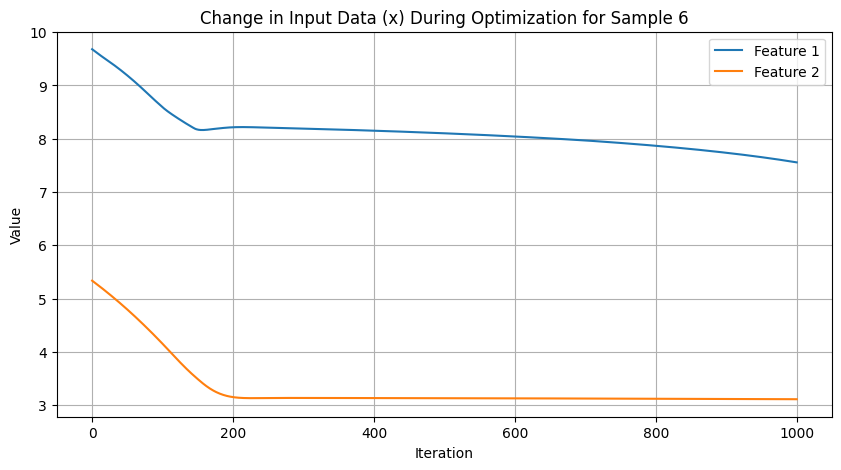

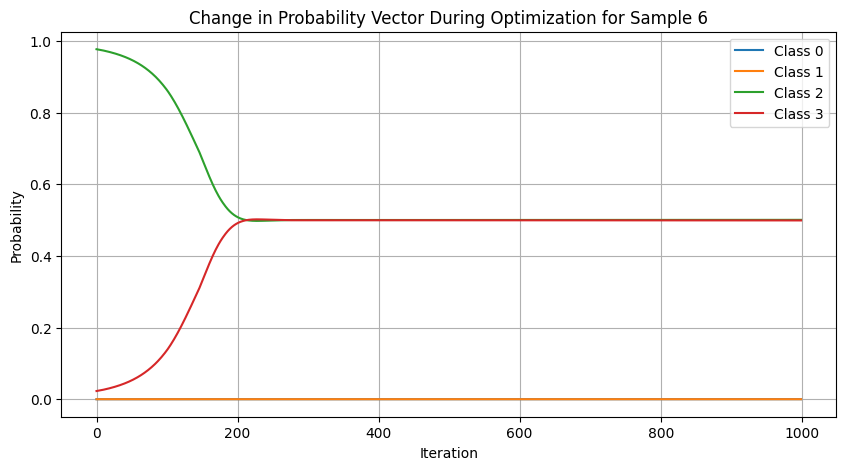

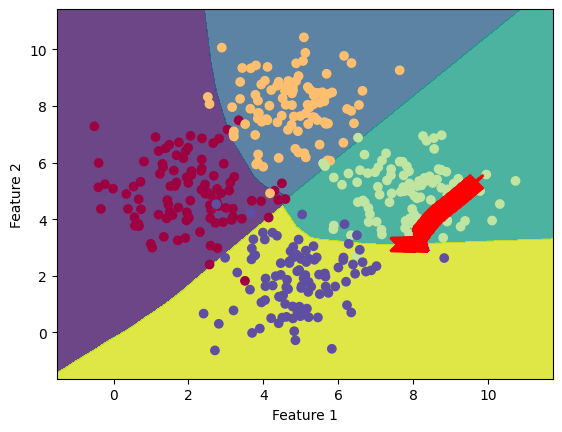

Sample 7 - Final Loss: 0.6175044775009155


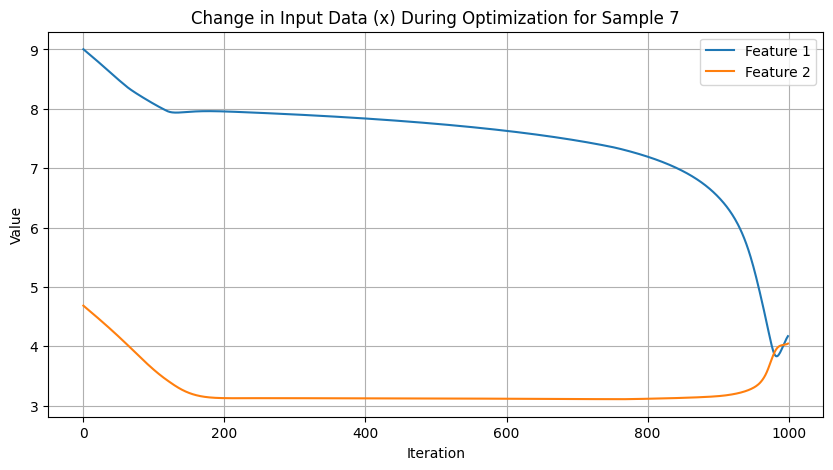

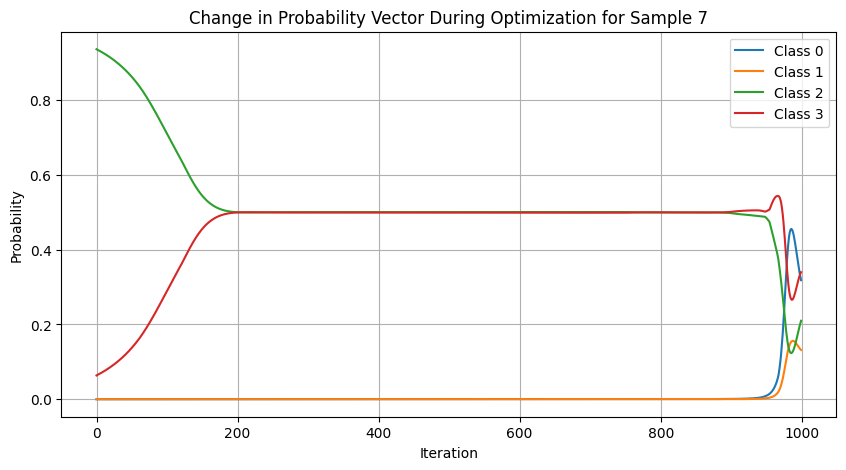

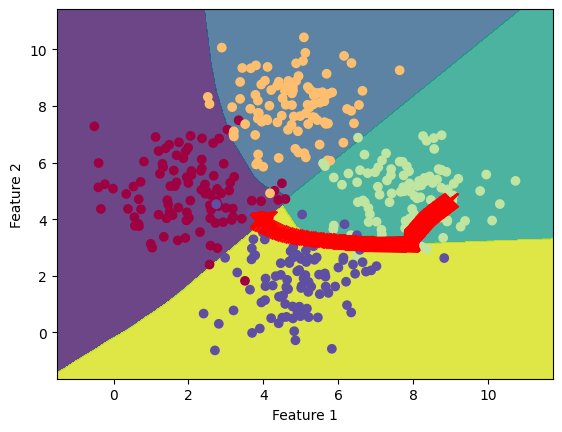

Sample 8 - Final Loss: 0.16538846492767334


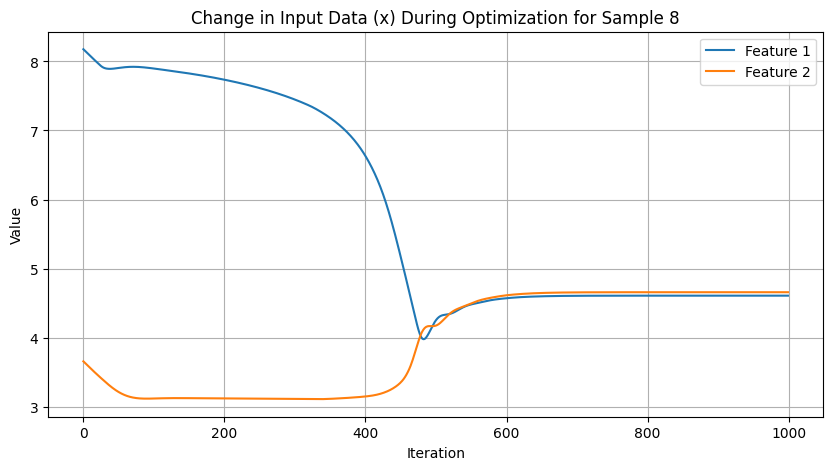

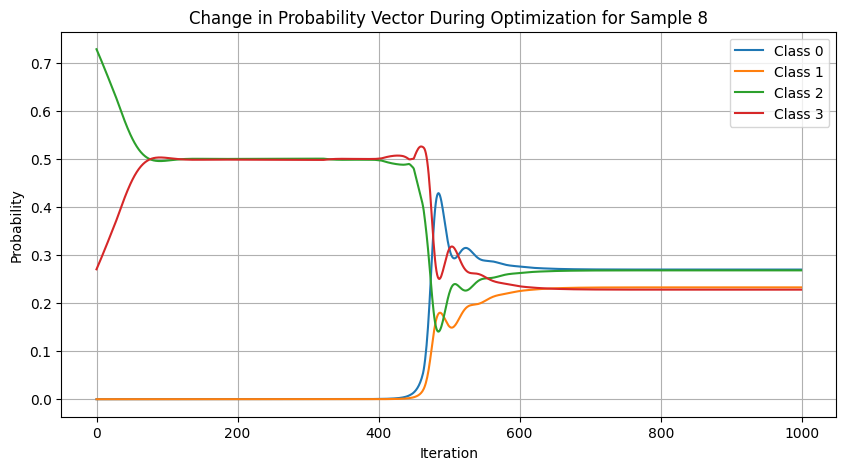

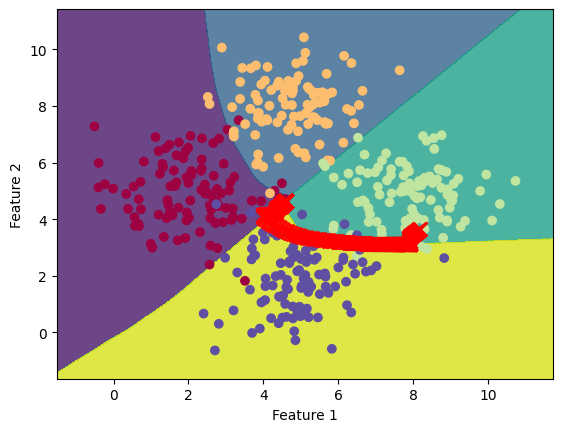

Sample 9 - Final Loss: 0.1653880476951599


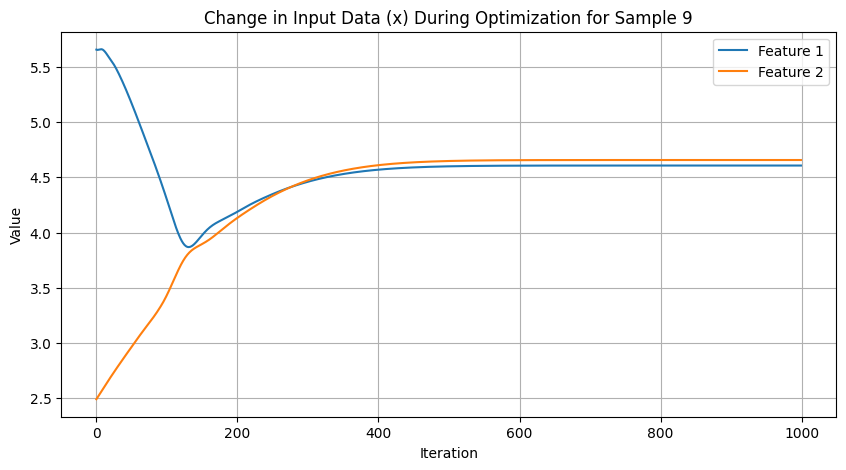

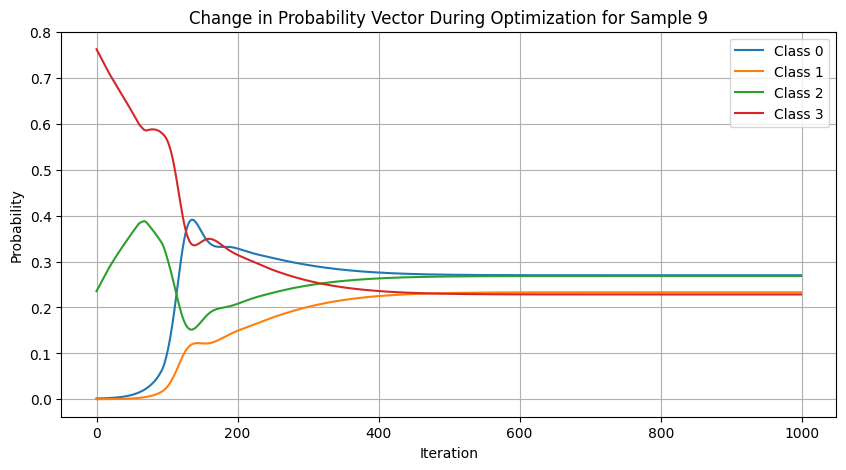

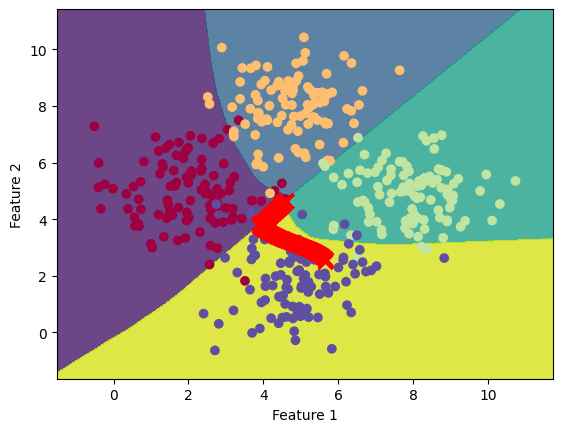

Sample 10 - Final Loss: 0.16538870334625244


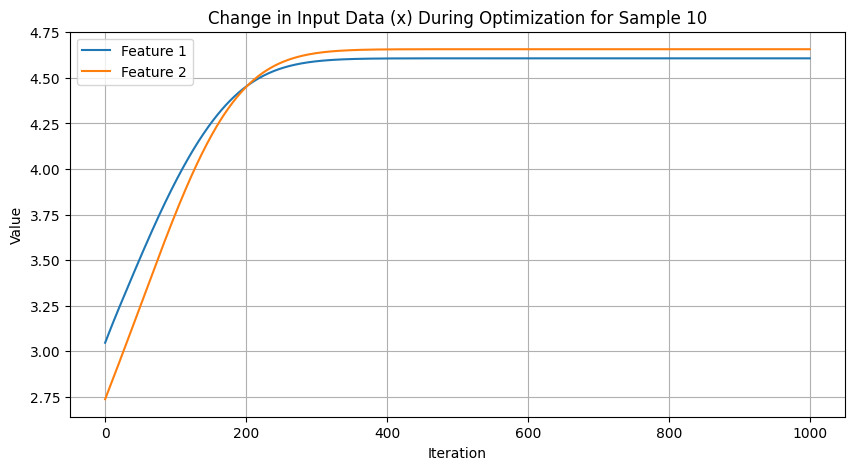

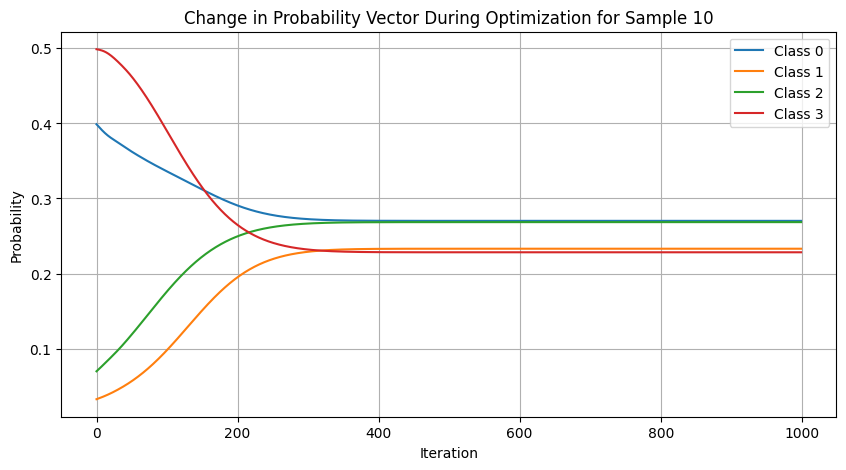

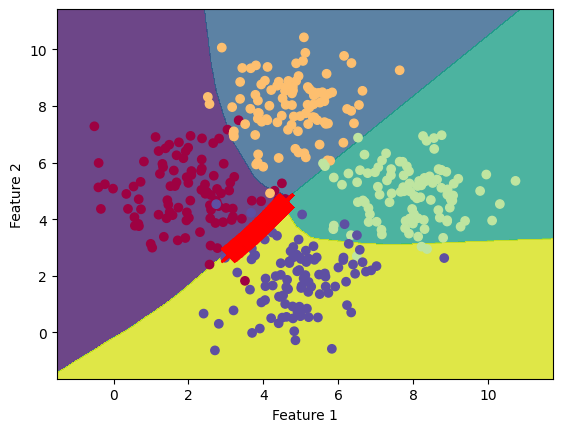

Sample 11 - Final Loss: 0.16538766026496887


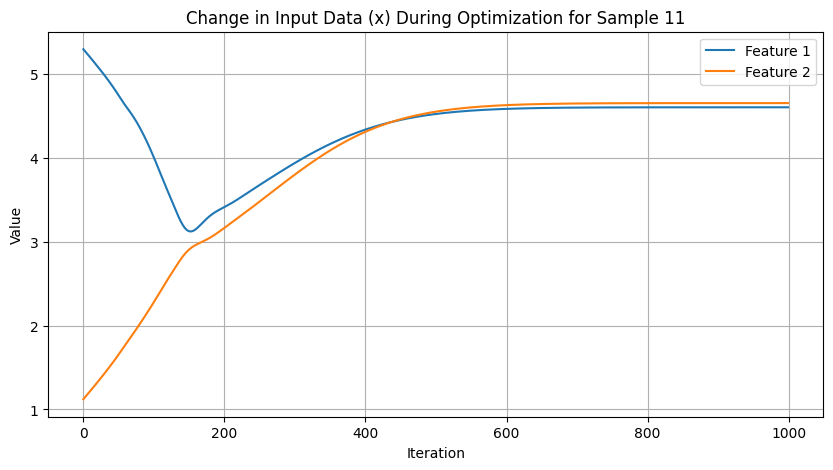

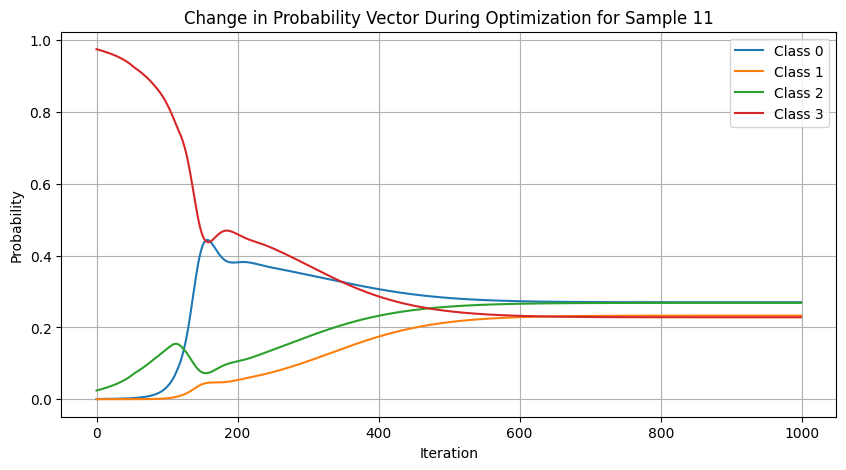

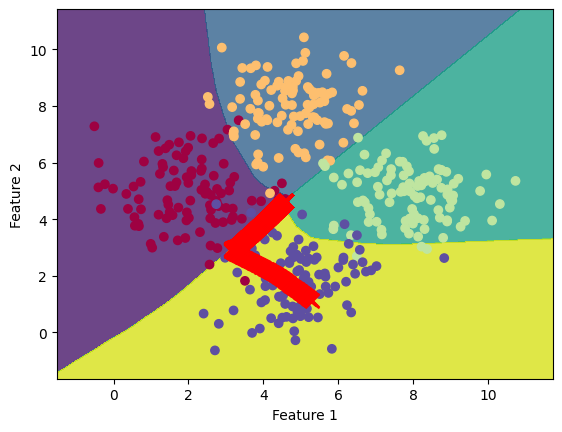

In [ ]:
# Create a list of data samples in the relevant range
data_samples, _ = generate_toy_data_4_classes_intersect(3, 4)
data_samples = torch.FloatTensor(data_samples)
target_l2 = 1 / 4

# Create dictionaries to store results for each sample
results = []

# Generate adversarial examples for each data sample
for idx, data_sample in enumerate(data_samples):
    print("###################")
    adversarial_data, x_history, prob_vector_history = generate_adversarial_example_entropy(model, data_sample, num_iterations=1000)

    # Calculate the final loss
    final_loss = torch.norm(torch.sum(torch.pow(model(adversarial_data), 2)) - target_l2, p=2).item()


    # Store the results in a dictionary
    result_dict = {
        'Sample': idx,
        'Final Loss': final_loss,
        'X History': x_history,
        'Probability Vector History': prob_vector_history
    }
    results.append(result_dict)

# Print the results
for result in results:
    print(f"Sample {result['Sample']} - Final Loss: {result['Final Loss']}")

    # Plot the change in x itself during optimization for the first sample
    sample_idx_to_visualize = result['Sample']  # Change this index to visualize a different sample
    x_history = np.array(results[sample_idx_to_visualize]['X History'])
    plt.figure(figsize=(10, 5))
    plt.plot(range(len(x_history)), x_history[:, 0], label='Feature 1')
    plt.plot(range(len(x_history)), x_history[:, 1], label='Feature 2')
    plt.xlabel('Iteration')
    plt.ylabel('Value')
    plt.title(f'Change in Input Data (x) During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    # Plot the change in the probability vector during optimization for the first sample
    prob_vector_history = np.array(results[sample_idx_to_visualize]['Probability Vector History'])
    plt.figure(figsize=(10, 5))
    for class_idx in range(prob_vector_history.shape[1]):
        plt.plot(range(len(prob_vector_history)), prob_vector_history[:, class_idx], label=f'Class {class_idx}')
    plt.xlabel('Iteration')
    plt.ylabel('Probability')
    plt.title(f'Change in Probability Vector During Optimization for Sample {sample_idx_to_visualize}')
    plt.grid()
    plt.legend()
    plt.show()

    plot_decision_boundary_with_x_history(model, data, labels, results[sample_idx_to_visualize]['X History'])

# Anomalies Experiment

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim.lr_scheduler import StepLR

# Compact Neural Network Model
class CompactNN(nn.Module):
    def __init__(self, input_dim, output_dim):
        super(CompactNN, self).__init__()

        self.fc1 = nn.Linear(input_dim, 64)
        self.fc2 = nn.Linear(64, 128)
        self.fc3 = nn.Linear(128, 64)
        self.fc4 = nn.Linear(64, output_dim)

        self.dropout = nn.Dropout(0.3)

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = self.dropout(x)
        x = F.relu(self.fc2(x))
        x = F.relu(self.fc3(x))
        x = self.fc4(x)
        return x

In [ ]:
def generate_toy_data_with_anomalies(num_samples_per_class, num_classes, num_anomalies=10):
    data = []
    labels = []

    # Define mean vectors for each class with some overlap
    class_means = [
        [2.0, 2.0],
        [5.0, 5.0],
        [8.0, 2.0]
    ]

    cov = np.eye(2)  # Covariance matrix (identity for simplicity)

    for class_idx in range(num_classes):
        mean = class_means[class_idx]
        samples = np.random.multivariate_normal(mean, cov, num_samples_per_class)
        data.append(samples)
        labels.append(np.ones(num_samples_per_class) * class_idx)

    # Introducing anomalies deep inside class 1 but labeled as class 0
    # deep_anomaly_mean = class_means[1]  # Use class 1's mean
    # deep_anomalies = np.random.multivariate_normal(deep_anomaly_mean, cov, 1)
    # data.append(np.tile(deep_anomalies, (num_anomalies, 1)))
    # labels.append(np.ones(num_anomalies) * 0)  # Label these anomalies as class 0
    # print(deep_anomalies)

    # # Introducing anomalies near the boundary between class 0 and class 1 but labeled as class 0
    boundary_anomaly_mean = [(class_means[0][0] + class_means[1][0]) / 2,
                             (class_means[0][1] + class_means[1][1]) / 2]
    boundary_anomalies = np.random.multivariate_normal(boundary_anomaly_mean, cov, 1)
    data.append(np.tile(boundary_anomalies, (num_anomalies, 1)))
    labels.append(np.ones(num_anomalies) * 0)  # Label these anomalies as class 0
    print(boundary_anomalies)

    data = np.vstack(data)
    labels = np.concatenate(labels)
    return data, labels


In [ ]:
def generate_toy_data_3_classes(num_samples_per_class, num_classes=3):
    data = []
    labels = []

    # Define mean vectors for each class with some overlap
    class_means = [
        [2.0, 2.0],
        [5.0, 5.0],
        [8.0, 2.0]
    ]

    cov = np.eye(2)  # Covariance matrix (identity for simplicity)

    for class_idx in range(num_classes):
        mean = class_means[class_idx]
        samples = np.random.multivariate_normal(mean, cov, num_samples_per_class)
        data.append(samples)
        labels.append(np.ones(num_samples_per_class) * class_idx)

    data = np.vstack(data)
    labels = np.concatenate(labels)
    return data, labels, class_means

In [ ]:
def plot_decision_boundary(model, data, labels, outlier_data):
    # Predict the function value for the whole grid
    x_min, x_max = data[:, 0].min() - 1, data[:, 0].max() + 1
    y_min, y_max = data[:, 1].min() - 1, data[:, 1].max() + 1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.01), np.arange(y_min, y_max, 0.01))

    Z = model(torch.FloatTensor(np.c_[xx.ravel(), yy.ravel()]))
    Z = Z.argmax(dim=1).reshape(xx.shape)

    # Plot the contour and training examples
    plt.contourf(xx, yy, Z, alpha=0.8, cmap=plt.cm.Spectral)
    plt.scatter(data[:, 0], data[:, 1], c=labels, cmap=plt.cm.Spectral)

    # Highlight the outlier samples
    plt.scatter(outlier_data[:, 0], outlier_data[:, 1], color='black', marker='x', label='Outliers')

    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.legend()
    plt.show()

In [ ]:

# Generate toy data
num_samples_per_class = 100
num_classes = 3
data, labels, class_means = generate_toy_data_3_classes(num_samples_per_class)
# Add the anomaly in the center of class 1 but labeled as class 0
anomaly_data = np.array([[5, 5]])
anomaly_label = np.array([0])

# Duplicate the outlier N times
N = 120
data = np.vstack([data] + [anomaly_data] * N)
labels = np.concatenate([labels] + [anomaly_label] * N)

# Convert data and labels to PyTorch tensors
data_tensor = torch.FloatTensor(data)
labels_tensor = torch.LongTensor(labels)

# Create a dataset and DataLoader
dataset = TensorDataset(data_tensor, labels_tensor)
batch_size = 32
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Define model and loss function
input_dim = 2
output_dim = num_classes
criterion = nn.CrossEntropyLoss()
learning_rate = 0.01
model = CompactNN(input_dim, output_dim)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=100, gamma=0.9)


# Training Loop
num_epochs = 500
losses = []
for epoch in range(num_epochs):
    for batch_data, batch_labels in dataloader:
        optimizer.zero_grad()
        outputs = model(batch_data)
        loss = criterion(outputs, batch_labels)
        loss.backward()
        optimizer.step()

    scheduler.step()
    losses.append(loss.item())

    if (epoch + 1) % 50 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

print('Training complete.')

Epoch [50/500], Loss: 0.0225
Epoch [100/500], Loss: 0.0613
Epoch [150/500], Loss: 0.0330
Epoch [200/500], Loss: 0.0000
Epoch [250/500], Loss: 0.0085
Epoch [300/500], Loss: 0.4923
Epoch [350/500], Loss: 0.0270
Epoch [400/500], Loss: 0.5496
Epoch [450/500], Loss: 0.0190
Epoch [500/500], Loss: 0.0075
Training complete.


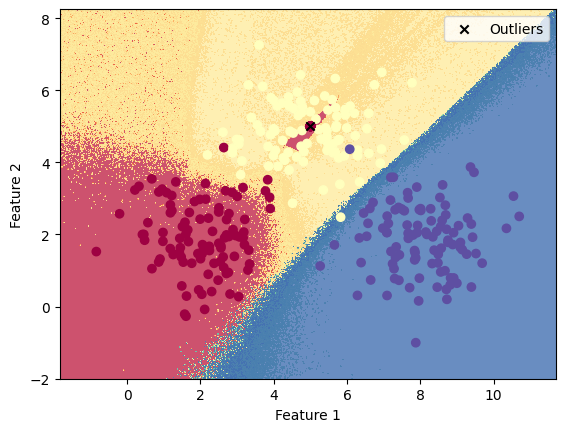

In [ ]:
plot_decision_boundary(model, data, labels, anomaly_data)


In [ ]:
# Assuming you have the `generate_toy_data_3_classes` function already defined from previous examples
num_samples_per_class = 100
num_classes = 3
data, labels, class_means = generate_toy_data_3_classes(num_samples_per_class)

# Generate an outlier sample near the boundary of class 0 and class 1
boundary_point = (np.array(class_means[0]) + np.array(class_means[1])) / 2
shift_towards_class_1 = np.array(class_means[1]) - boundary_point
shifted_point = boundary_point + 0.1 * shift_towards_class_1  # Shift a small percentage towards class 1

outlier_sample = np.random.multivariate_normal(shifted_point, np.eye(2)*0.01, 1)

# Duplicate this sample for visibility
num_outliers = 100
outliers_data = np.repeat(outlier_sample, num_outliers, axis=0)
outliers_labels = np.zeros(num_outliers)  # All outliers labeled as 0

# Add these samples to the training data
data = np.vstack([data, outliers_data])
labels = np.concatenate([labels, outliers_labels])

# Convert data and labels to PyTorch tensors
data = torch.FloatTensor(data)
labels = torch.LongTensor(labels)

# Create a dataset and DataLoader
dataset = TensorDataset(data, labels)
batch_size = 32
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Define model and loss function
input_dim = 2
output_dim = num_classes
criterion = nn.CrossEntropyLoss()
learning_rate = 0.01
model = CompactNN(input_dim, output_dim)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
scheduler = StepLR(optimizer, step_size=100, gamma=0.9)


# Training Loop
num_epochs = 500
losses = []
for epoch in range(num_epochs):
    for batch_data, batch_labels in dataloader:
        optimizer.zero_grad()
        outputs = model(batch_data)
        loss = criterion(outputs, batch_labels)
        loss.backward()
        optimizer.step()

    scheduler.step()
    losses.append(loss.item())

    if (epoch + 1) % 50 == 0:
        print(f'Epoch [{epoch + 1}/{num_epochs}], Loss: {loss.item():.4f}')

print('Training complete.')

Epoch [50/500], Loss: 0.0242
Epoch [100/500], Loss: 0.0307
Epoch [150/500], Loss: 0.0988
Epoch [200/500], Loss: 0.0376
Epoch [250/500], Loss: 0.0035
Epoch [300/500], Loss: 0.1316
Epoch [350/500], Loss: 0.0047
Epoch [400/500], Loss: 0.0733
Epoch [450/500], Loss: 0.0309
Epoch [500/500], Loss: 0.0038
Training complete.


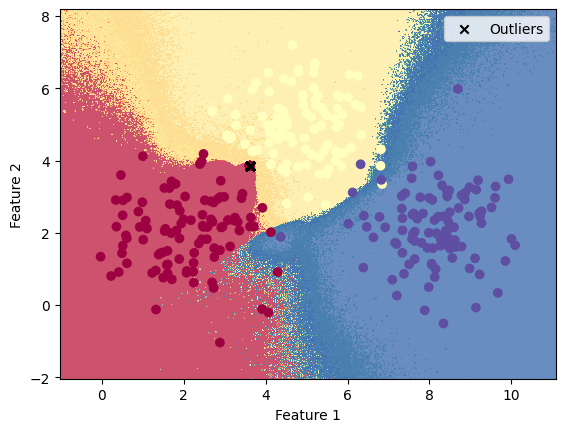

In [ ]:
plot_decision_boundary(model, data, labels, outliers_data)
